In [116]:
import gym
import torch
import torch.nn as nn
import torch.nn.functional as F
from scipy.special import softmax
import numpy as np
import os

import matplotlib.pyplot as plt
from tqdm import tqdm
import rl_utils
import GridWorld_v6
import draw
from collections import defaultdict, namedtuple

import utils
import argparse

import ppo

In [117]:
PPO_Transition = namedtuple('PPO_Transition', ['state', 'action', 'a_prob', 'reward', 'next_state','G'])

In [118]:
parser = argparse.ArgumentParser()
# * env
"""
未提及的均为0

targetAreaScore = 1
work

forbiddenAreaScore = -0.01
targetAreaScore = 1
work

forbiddenAreaScore = -0.01
hitWallScore = -0.01
targetAreaScore = 1
did't work

forbiddenAreaScore = -0.01
hitWallScore = -0.01
targetAreaScore = 1
entropy_coef = 0.01
work

"""



parser.add_argument("--forbiddenAreaScore", type=float, default = -0.01)
parser.add_argument("--targetAreaScore", type=float, default = 1)
parser.add_argument("--hitWallScore", type=float, default = -0.01)
parser.add_argument("--moveScore", type=float, default = 0)
parser.add_argument("--desc", type=list, default = [".....",".##..","..#..",".#T#.",".#..."])

# no need to change
parser.add_argument("--seed", type=int, default=0)
parser.add_argument("--device", type=str, default="cpu")
parser.add_argument("--action_space", type=int, default=4) #动作空间是4个
parser.add_argument("--start_state", type=int, default=0) #从十号点出发

# train
parser.add_argument("--num_episodes", type=int, default=20000) #从十号点出发

# * PPO hyperparameters
# PPO超参数
parser.add_argument("--gamma", type=float, default=0.99)
parser.add_argument("--batch_size", type=int, default=512)
parser.add_argument("--num_update_per_iter", type=int, default=5) #每一个trajectory更新10次
parser.add_argument("--actor_lr", type=float, default=0.0003)
parser.add_argument("--critic_lr", type=float, default=0.001)
parser.add_argument("--entropy_coef", type=float, default=0.01)
parser.add_argument("--hidden_dim", type=int, default=64)
parser.add_argument("--clip_param", type=float, default=0.2)
parser.add_argument("--max_grad_norm", type=float, default=5.0)
parser.add_argument("--trajectory_len", type=float, default=200)

# * eval related
# 测试相关
parser.add_argument("--num_train_ep", type=int, default=10)
parser.add_argument("--num_eval_ep", type=int, default=5)
parser.add_argument("--ckpt_freq", type=int, default=100)
parser.add_argument("--eval_freq", type=int, default=100)
parser.add_argument("--eval_runs", type=int, default=2)

args = parser.parse_args(args=[])

In [119]:
def toOneHot(state):
    stateid = state[0]*5 + state[1]
    return np.eye(25)[stateid]
def toCoordinate(oneHotState):
    stateid = np.argmax(oneHotState)
    return [stateid//5, stateid%5]

In [120]:
def set_seed(seed): #固定种子
    # do not fix the seed of the envs
    torch.set_num_threads(1)
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True
    
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    np.random.seed(seed)

set_seed(args.seed)

In [121]:
env = GridWorld_v6.GridWorld_v6(initState=0,
                                moveScore=args.moveScore,
                                action_space=args.action_space,
                                forbiddenAreaScore=args.forbiddenAreaScore,
                                score=args.targetAreaScore,
                                hitWallScore = args.hitWallScore,
                                desc = args.desc,
                                enterForbiddenArea=False)


In [122]:
env.show()

⬜️⬜️⬜️⬜️⬜️
⬜️🚫🚫⬜️⬜️
⬜️⬜️🚫⬜️⬜️
⬜️🚫✅🚫⬜️
⬜️🚫⬜️⬜️⬜️


In [123]:
env.reset()

[0, 0]

In [124]:
env.step(1)

([0, 1], 0.0, 0, 0)

In [125]:
agent = ppo.PPO(state_dim = 25,
        hidden_dim = args.hidden_dim,
        action_dim = 4,
        device = args.device,
        num_steps = args.trajectory_len,
        batch_size = args.batch_size,
        actor_lr = args.actor_lr,
        critic_lr = args.critic_lr,
        entropy_coef = args.entropy_coef,
        gamma = args.gamma,
        num_update_per_iter = args.num_update_per_iter,
        clip_param = args.clip_param,
        max_grad_norm = args.max_grad_norm)

In [126]:
agent.actor_net

PolicyNet(
  (net1): Sequential(
    (0): Linear(in_features=25, out_features=64, bias=True)
    (1): LeakyReLU(negative_slope=0.01)
    (2): Linear(in_features=64, out_features=64, bias=True)
    (3): LeakyReLU(negative_slope=0.01)
    (4): Linear(in_features=64, out_features=4, bias=True)
  )
)

In [127]:
env.show()

⬜️⬜️⬜️⬜️⬜️
⬜️🚫🚫⬜️⬜️
⬜️⬜️🚫⬜️⬜️
⬜️🚫✅🚫⬜️
⬜️🚫⬜️⬜️⬜️


In [128]:
state = env.reset()
toOneHot(state)

array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0.])

In [129]:
np.array([toOneHot(state)], dtype=int)

array([[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0]])

In [130]:
agent.select_action(np.array([toOneHot(state)], dtype=int))

(array([[0., 0., 1., 0.]], dtype=float32),
 array([2]),
 array([0.24696983], dtype=float32),
 array([[0.2678416 , 0.26182622, 0.24696983, 0.22336236]], dtype=float32))

In [131]:
def collect_trajectory(env, agent, args, reward_list, test=True):
    state = env.reset()
    done = False
    cnt = 0
    
    trans_list = []

    for i in range(args.trajectory_len):
        cnt += 1
        _, action, prob, _ = agent.select_action(np.array([toOneHot(state)], dtype=int))
        action = action[0]
        next_state, reward, done, _ = env.step(action)
        trans = state, action, prob, reward, next_state
        trans_list.append(trans)
        state = next_state
        reward_list.append(reward)
        if cnt > args.trajectory_len or done:
            break

    return_to_go = 0
    for trans in reversed(trans_list):
        state, action, prob, reward, next_state = trans
        return_to_go = reward + args.gamma * return_to_go
        if not test:
            agent.store_transition(PPO_Transition(toOneHot(state), action, prob, reward, toOneHot(next_state), return_to_go))

    return return_to_go

In [132]:
from collections import Counter

  0%|                                                                                                   | 0/20000 [00:00<?, ?it/s]

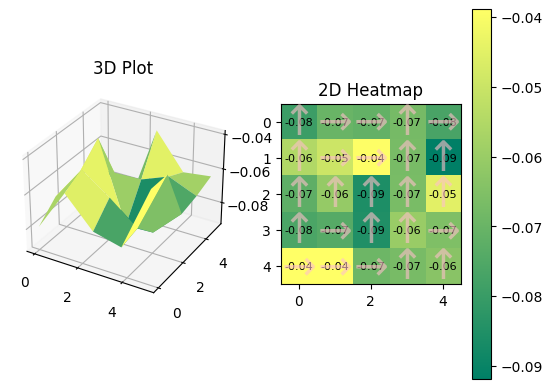

-0.07933617	-0.06980457	-0.07117759	-0.067325205	-0.07655866	
-0.05519717	-0.04968472	-0.03932381	-0.06694199	-0.09181918	
-0.07223317	-0.061008792	-0.08573504	-0.066440314	-0.045075133	
-0.07625944	-0.07392888	-0.08509627	-0.060191717	-0.0654239	
-0.03894492	-0.038985275	-0.06920238	-0.06703135	-0.063402504	
buffer_size 514
514
514


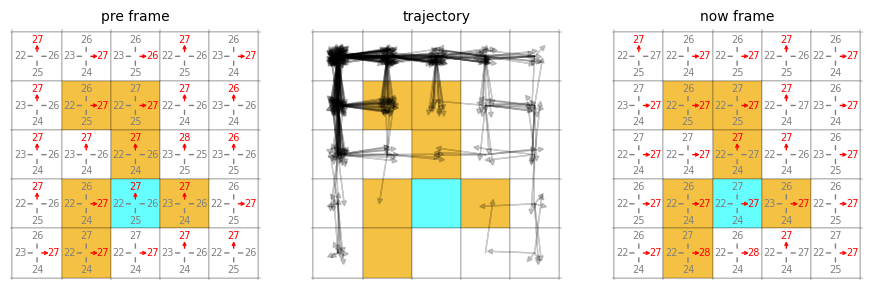

  0%|▏                                                                                       | 50/20000 [00:17<1:36:26,  3.45it/s]

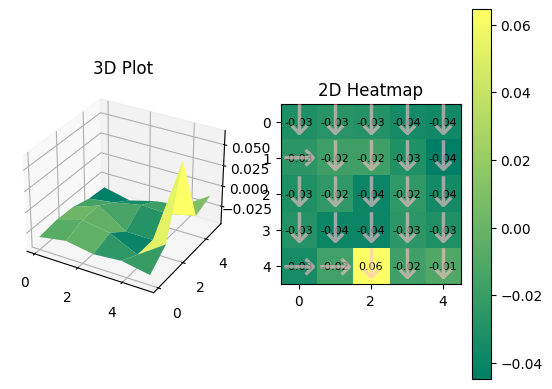

-0.031396855	-0.028094597	-0.029176757	-0.035349384	-0.03737501	
-0.025787741	-0.017985191	-0.017402414	-0.030557744	-0.044740148	
-0.031433802	-0.023756828	-0.03973516	-0.023817219	-0.036048084	
-0.028591342	-0.039935954	-0.039966445	-0.025234133	-0.031472206	
-0.034777135	-0.016703717	0.06446691	-0.017620675	-0.0097399205	
buffer_size 513
513
513


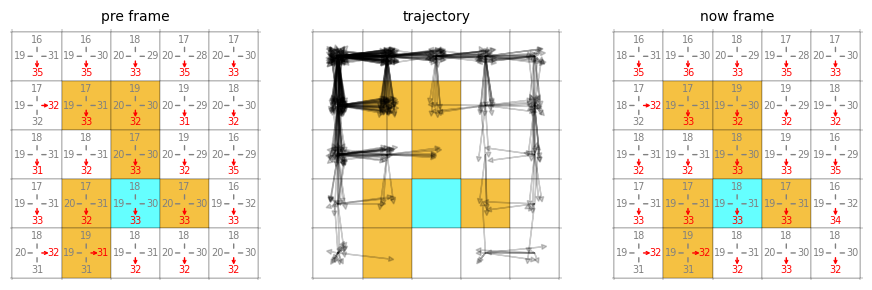

  0%|▍                                                                                      | 100/20000 [00:34<1:36:54,  3.42it/s]

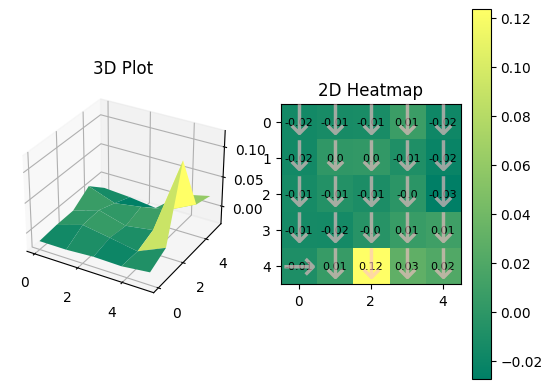

-0.016200565	-0.013113026	-0.012373935	0.0074838772	-0.018321224	
-0.016288467	0.0009782016	0.0023291484	-0.00912977	-0.02176664	
-0.013434615	-0.006641485	-0.010820255	-0.0020082593	-0.027562972	
-0.014356859	-0.015066143	-0.003998801	0.006282963	0.009669371	
-0.009285178	0.005449258	0.12363259	0.029261634	0.020332962	
buffer_size 512
512
512


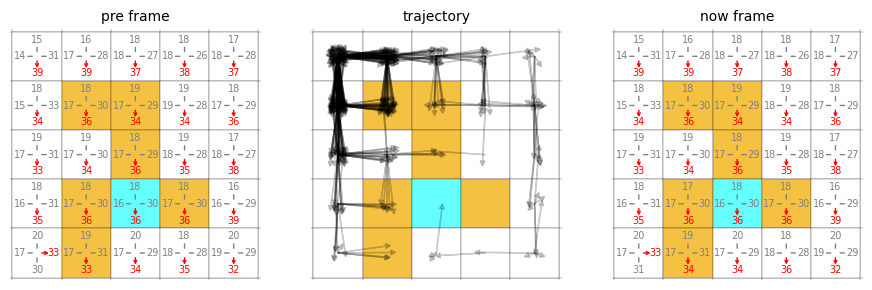

  1%|▋                                                                                      | 150/20000 [00:52<1:31:18,  3.62it/s]

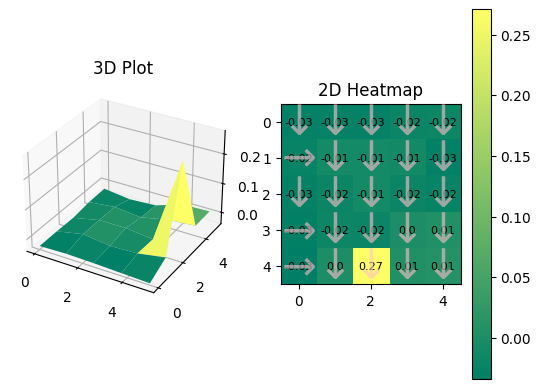

-0.027889159	-0.027141202	-0.028449621	-0.020048566	-0.018143237	
-0.02497176	-0.0079898685	-0.008208387	-0.009941854	-0.029437661	
-0.027053736	-0.01962353	-0.008101549	-0.019286383	-0.024549842	
-0.030510403	-0.015885983	-0.018299468	0.00034721568	0.006093655	
-0.03372823	0.00025501475	0.27080923	0.0079060085	0.009365391	
buffer_size 519
519
519


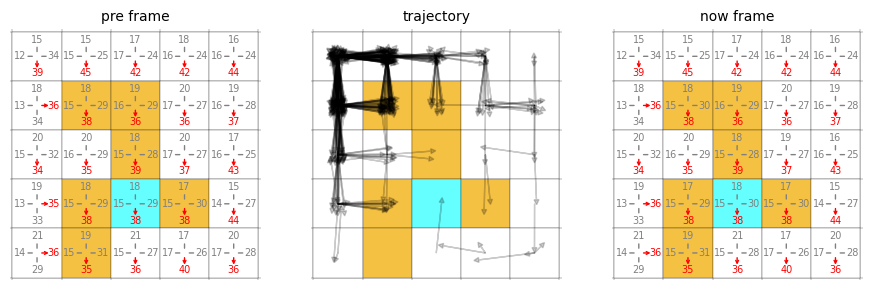

  1%|▊                                                                                      | 200/20000 [01:09<1:35:55,  3.44it/s]

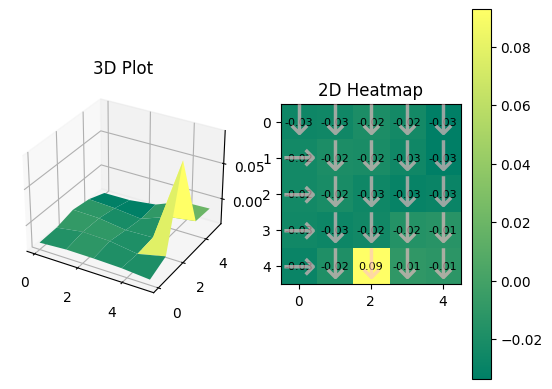

-0.026318535	-0.025428545	-0.01946529	-0.023584384	-0.03364671	
-0.023979403	-0.019635916	-0.020387225	-0.025660343	-0.033238515	
-0.024181351	-0.02093067	-0.025795858	-0.02977958	-0.028580077	
-0.025239706	-0.026889231	-0.024586536	-0.015221629	-0.013042528	
-0.028499719	-0.018017117	0.092826575	-0.009843651	-0.011700131	
buffer_size 512
512
512


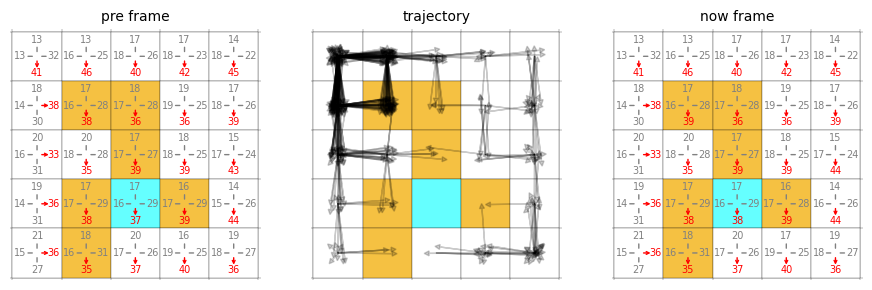

  1%|█                                                                                      | 250/20000 [01:26<1:30:51,  3.62it/s]

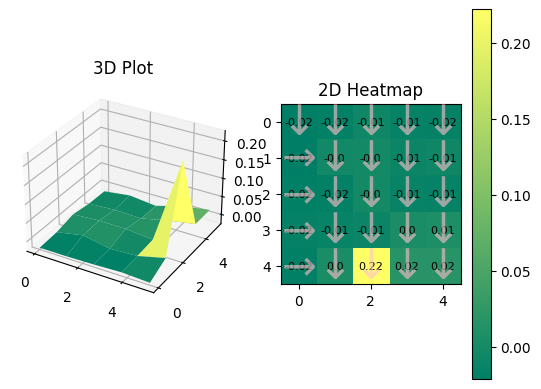

-0.020965502	-0.017921396	-0.0065428875	-0.014351439	-0.016050994	
-0.020923035	-0.0038390271	-0.0021662526	-0.010167118	-0.006581608	
-0.019123819	-0.017513793	-0.002797205	-0.01246902	-0.014933746	
-0.016021807	-0.013706438	-0.009588771	0.004146453	0.006654188	
-0.019695718	0.0047399066	0.22216497	0.01684979	0.0173597	
buffer_size 517
517
517


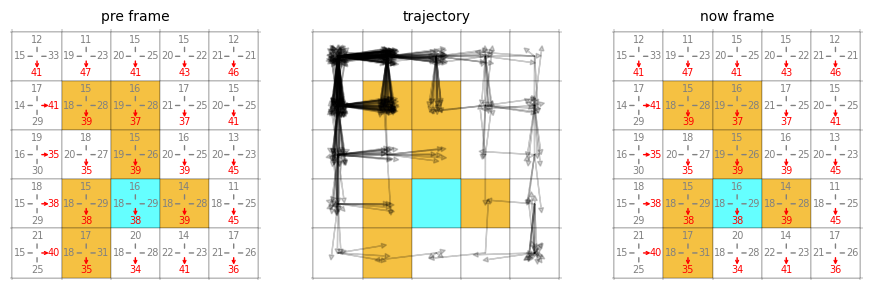

  2%|█▎                                                                                     | 300/20000 [01:43<1:31:01,  3.61it/s]

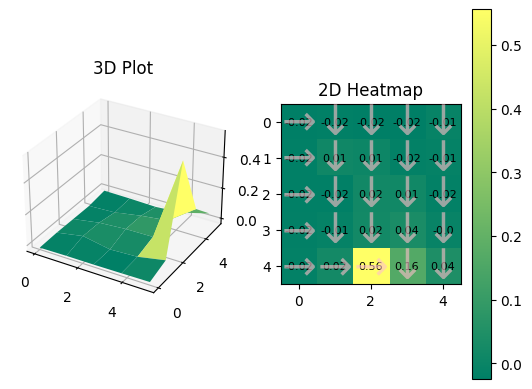

-0.024013657	-0.020123698	-0.02238696	-0.024363965	-0.008283578	
-0.021313813	0.011952002	0.0066699684	-0.015970856	-0.011371443	
-0.020990988	-0.020634169	0.01849458	0.014265969	-0.016909365	
-0.018912118	-0.012243219	0.020963833	0.035581432	-0.0041137505	
-0.016220499	0.02225545	0.5559908	0.1641334	0.04370527	
buffer_size 533
533
533


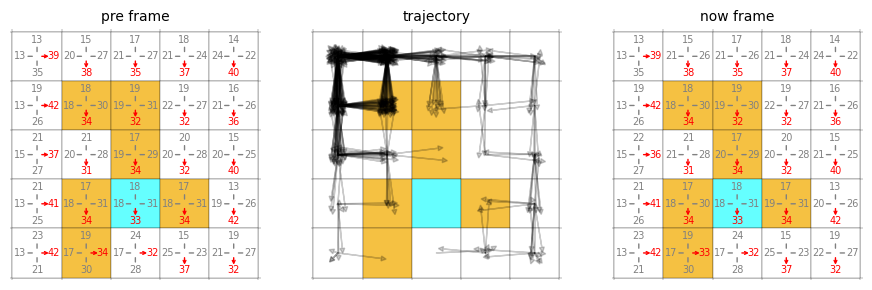

  2%|█▌                                                                                     | 350/20000 [02:01<1:35:30,  3.43it/s]

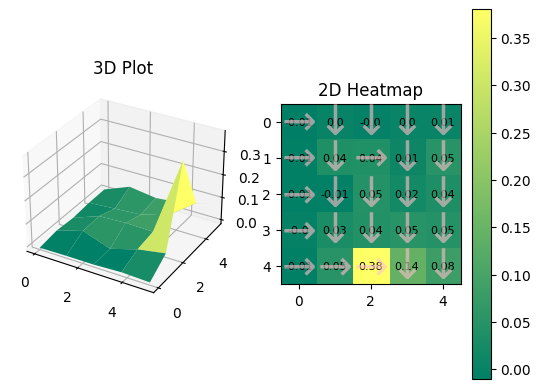

-0.010407168	0.0019236989	-0.0033765994	0.004358761	0.006140601	
-0.008370416	0.036981218	0.04010237	0.012345875	0.052486032	
-0.008026903	-0.0050708214	0.045584574	0.021128671	0.035485014	
-0.0023449082	0.029944772	0.043049	0.05358781	0.046796948	
-0.0066866763	0.051045164	0.38029507	0.14275761	0.08170625	
buffer_size 513
513
513


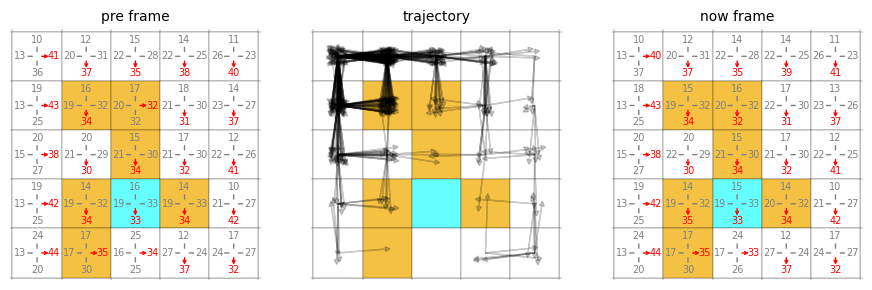

  2%|█▋                                                                                     | 400/20000 [02:18<1:33:39,  3.49it/s]

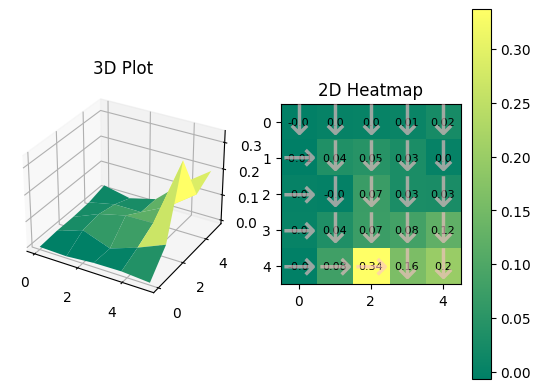

-0.0038014837	0.0020656837	0.002554953	0.0077411095	0.024305198	
-0.0069742035	0.037495352	0.045930836	0.030207314	0.0018430608	
0.0015889346	-0.0010230341	0.07146114	0.030258816	0.02870693	
0.0033809924	0.035458863	0.073592275	0.08320316	0.12269295	
-0.0048600864	0.079927504	0.33716032	0.16075943	0.19879693	
buffer_size 514
514
514


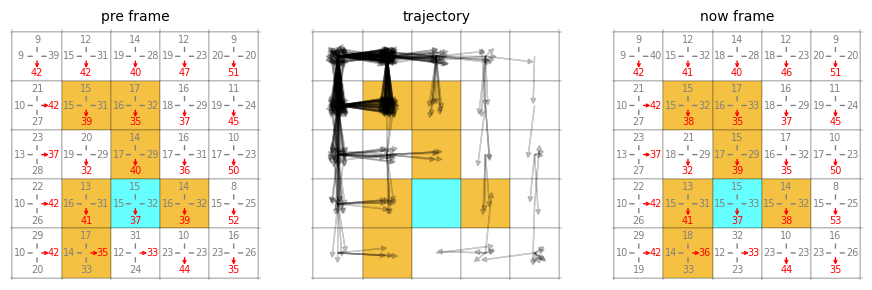

  2%|█▉                                                                                     | 450/20000 [02:35<1:29:18,  3.65it/s]

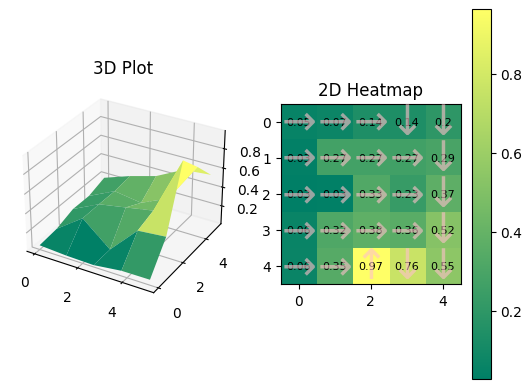

0.052190635	0.07369461	0.13893579	0.13643321	0.19586644	
0.033599027	0.27363288	0.27464324	0.27128837	0.294773	
0.026073072	0.031094816	0.32504392	0.22853744	0.3744882	
0.060971733	0.31912082	0.37705064	0.35831928	0.5199856	
0.06315021	0.34519735	0.96510774	0.7647262	0.5469041	
buffer_size 516
516
516


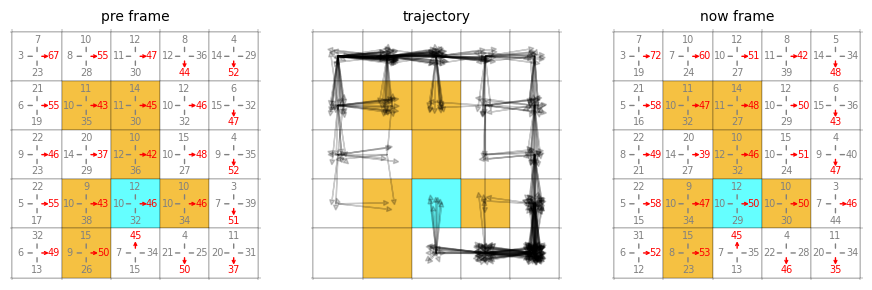

  2%|██▏                                                                                    | 500/20000 [02:53<1:39:11,  3.28it/s]

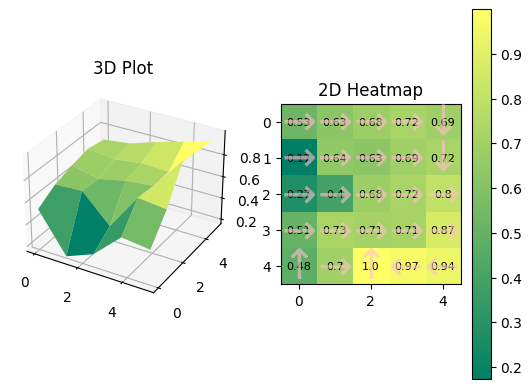

0.5304454	0.62787354	0.68088067	0.71860933	0.689168	
0.17312454	0.641863	0.6265464	0.6894783	0.7184435	
0.2739284	0.39593884	0.68126667	0.71898794	0.7976403	
0.50639296	0.7250595	0.7062613	0.7119229	0.8652327	
0.47574335	0.6969278	0.9994478	0.9679389	0.94015014	
buffer_size 523
523
523


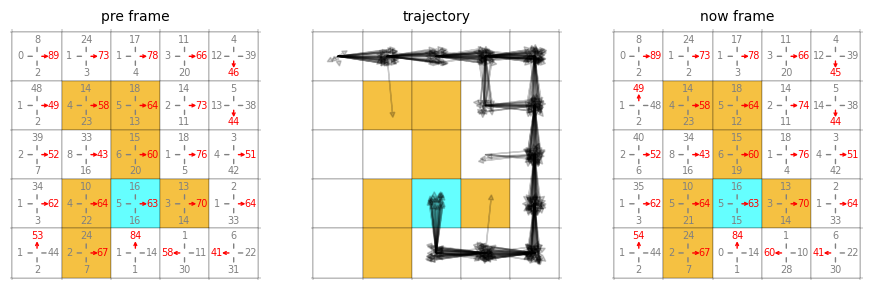

  3%|██▍                                                                                    | 550/20000 [03:10<1:34:07,  3.44it/s]

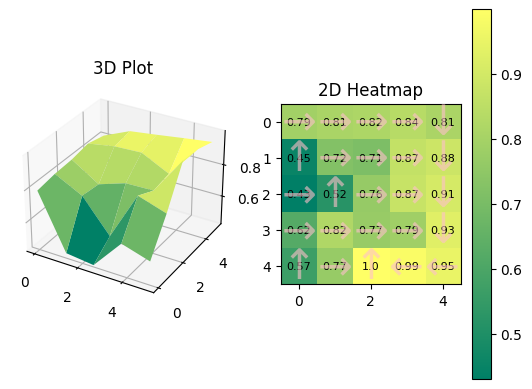

0.79143775	0.81021297	0.8174095	0.8389658	0.811694	
0.45097548	0.7232636	0.70923865	0.86693096	0.8846662	
0.43070963	0.5199305	0.7648257	0.8734708	0.9063295	
0.6213394	0.82381916	0.768649	0.7880398	0.92974854	
0.567245	0.766556	0.99982893	0.9866824	0.95145965	
buffer_size 523
523
523


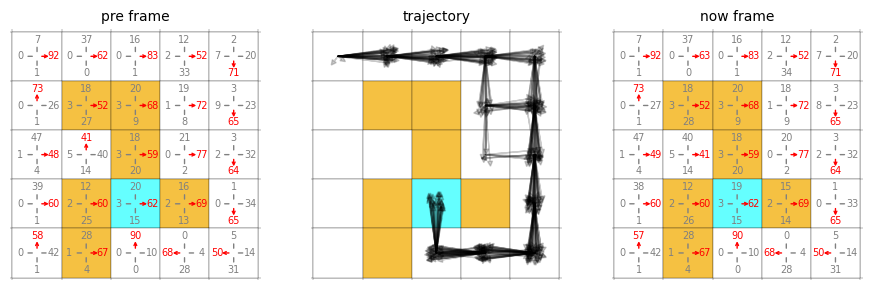

  3%|██▌                                                                                    | 600/20000 [03:28<1:36:29,  3.35it/s]

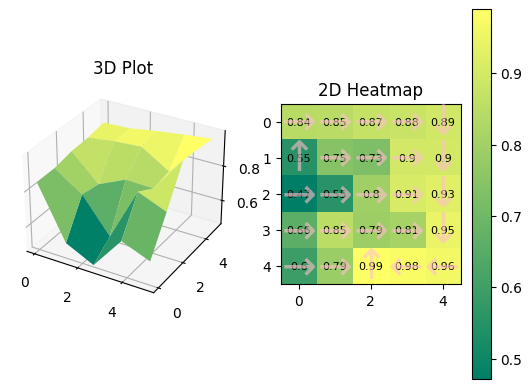

0.8449087	0.8489425	0.8711958	0.8769072	0.8946097	
0.54864186	0.7454233	0.7253845	0.89732814	0.9012146	
0.4715871	0.55191135	0.79610395	0.9076376	0.9257134	
0.6591631	0.8504391	0.79080915	0.8103707	0.9455271	
0.5957184	0.7862251	0.98932934	0.9783784	0.9624592	
buffer_size 518
518
518


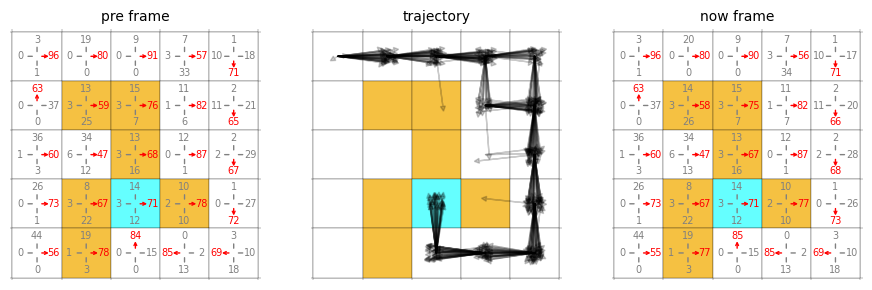

  3%|██▊                                                                                    | 650/20000 [03:46<1:34:20,  3.42it/s]

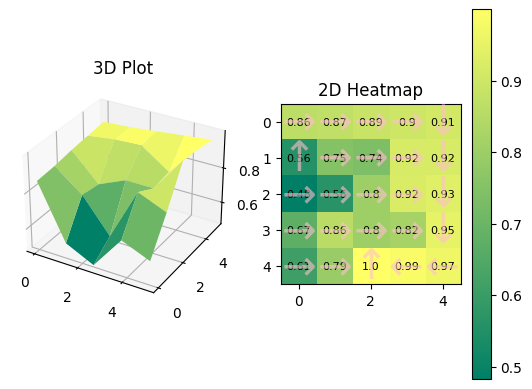

0.86403835	0.87196267	0.8881073	0.8991252	0.9097145	
0.558592	0.75343084	0.73595726	0.9175884	0.9186607	
0.4827146	0.56395733	0.803482	0.9246557	0.9344179	
0.67456454	0.85932887	0.8021546	0.81810284	0.9509309	
0.60825276	0.7937723	0.999935	0.9876837	0.9678517	
buffer_size 526
526
526


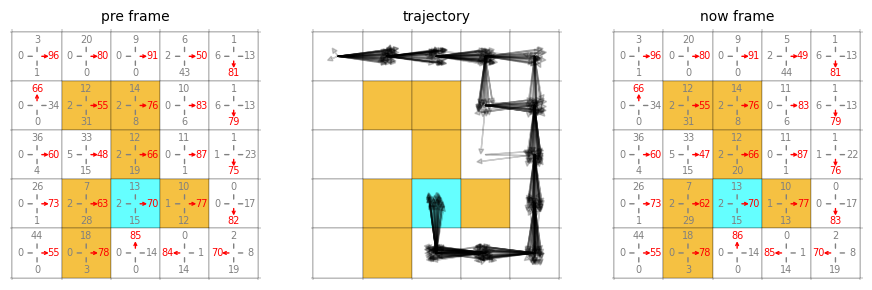

  4%|███                                                                                    | 700/20000 [04:03<1:35:22,  3.37it/s]

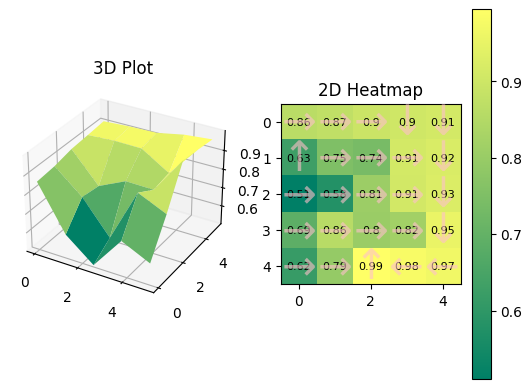

0.8636518	0.8736611	0.8951539	0.90326995	0.912651	
0.6281134	0.75222147	0.7375799	0.91057	0.9212191	
0.5103103	0.57729274	0.8052728	0.90866643	0.9250735	
0.6864533	0.8597668	0.80189174	0.8180552	0.95308846	
0.61581355	0.7926263	0.9942986	0.980792	0.9664654	
buffer_size 529
529
529


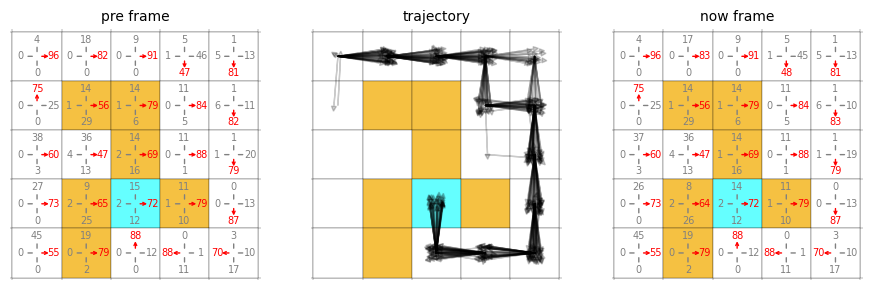

  4%|███▎                                                                                   | 750/20000 [04:21<1:31:43,  3.50it/s]

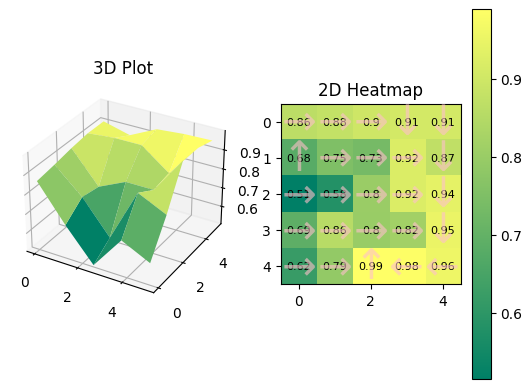

0.8642615	0.8789507	0.8970679	0.9095442	0.90888834	
0.6796943	0.75197697	0.73399174	0.92230403	0.8719889	
0.514683	0.580852	0.8003944	0.9227551	0.94050753	
0.69054365	0.85682833	0.8001354	0.81614137	0.9524298	
0.61966205	0.78823376	0.9895524	0.98480344	0.9563353	
buffer_size 515
515
515


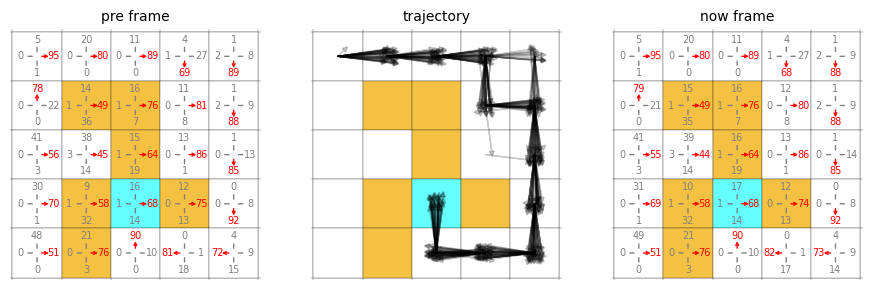

  4%|███▍                                                                                   | 800/20000 [04:39<1:33:32,  3.42it/s]

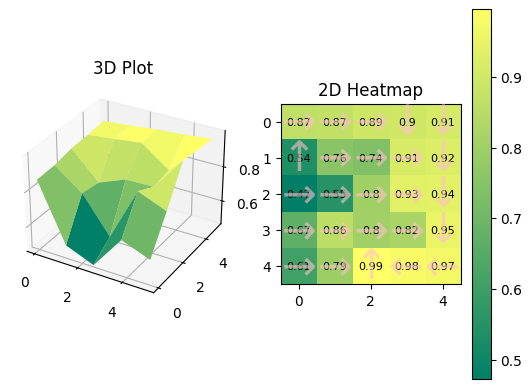

0.86508965	0.8703755	0.89180684	0.89802694	0.9088757	
0.53762984	0.75609314	0.73816717	0.9147093	0.92334723	
0.4732748	0.5524547	0.8011131	0.93410456	0.93971634	
0.66837656	0.85807073	0.8040246	0.8207482	0.9508635	
0.60721195	0.7937963	0.99498427	0.9799564	0.9671593	
buffer_size 519
519
519


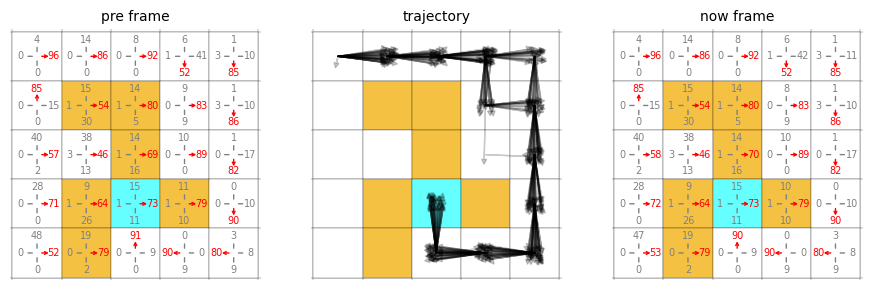

  4%|███▋                                                                                   | 850/20000 [04:57<1:33:45,  3.40it/s]

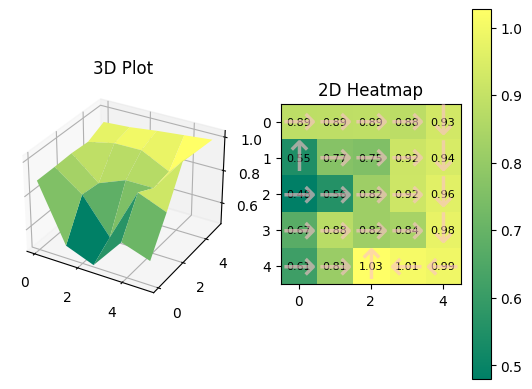

0.8857151	0.88636625	0.89001936	0.8827231	0.9302865	
0.54560363	0.76840925	0.7541985	0.91790915	0.9406874	
0.4799428	0.5589806	0.8194687	0.9196255	0.9611611	
0.67107916	0.87658554	0.8197266	0.83746237	0.9772871	
0.6137232	0.8096568	1.027077	1.0071992	0.99387074	
buffer_size 512
512
512


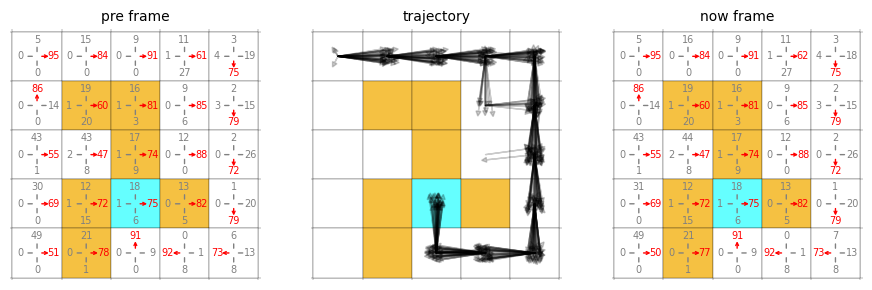

  4%|███▉                                                                                   | 900/20000 [05:14<1:33:33,  3.40it/s]

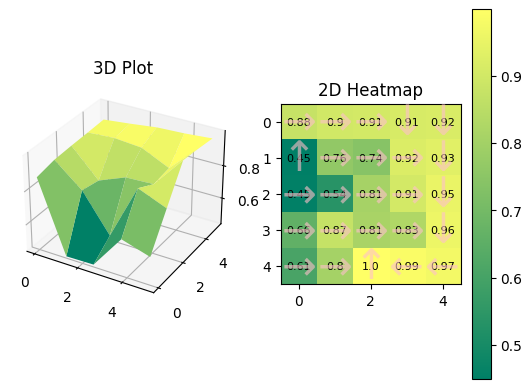

0.87680805	0.90030074	0.90705216	0.9115076	0.9171269	
0.44892806	0.7646608	0.7412136	0.9209311	0.93405336	
0.45210075	0.538693	0.8074217	0.90670955	0.95385605	
0.6597151	0.8727961	0.8139651	0.8291034	0.960665	
0.60777503	0.80400807	0.99954283	0.98850524	0.97360986	
buffer_size 519
519
519


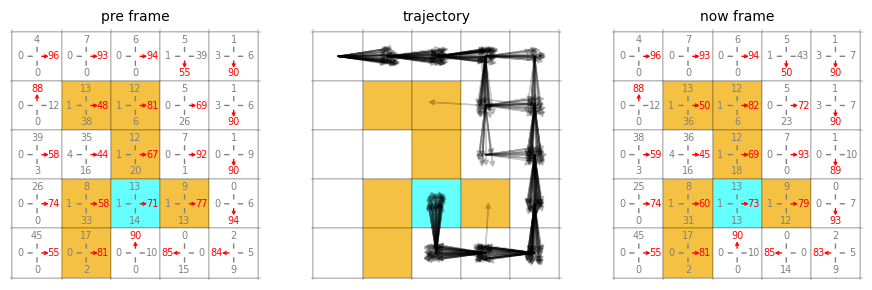

  5%|████▏                                                                                  | 950/20000 [05:32<1:27:36,  3.62it/s]

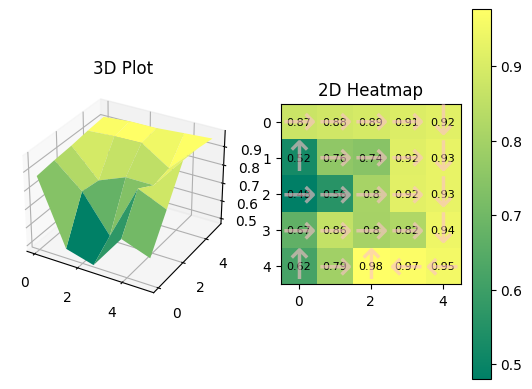

0.8722563	0.88481045	0.8932017	0.907218	0.91699505	
0.5222928	0.7593272	0.7442076	0.9151813	0.93035144	
0.48025578	0.55968136	0.8040037	0.9189668	0.9311488	
0.6714548	0.8601762	0.80306715	0.82244676	0.94199383	
0.61635715	0.7936526	0.97619927	0.9695643	0.9521375	
buffer_size 522
522
522


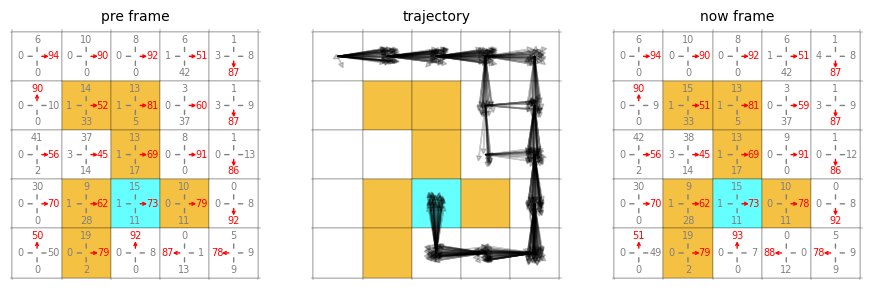

  5%|████▎                                                                                 | 1000/20000 [05:49<1:31:26,  3.46it/s]

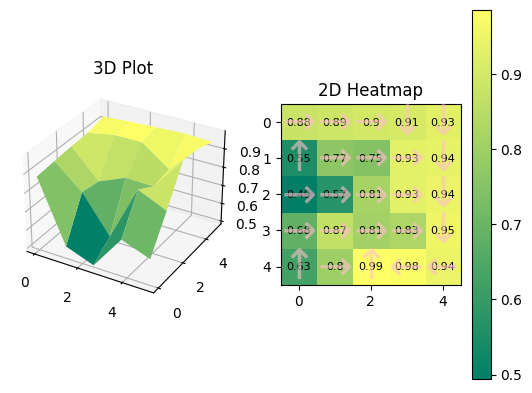

0.8797255	0.89044917	0.90050524	0.90571815	0.9288649	
0.54936576	0.76681584	0.75084835	0.9318726	0.9389201	
0.49377352	0.5714837	0.81247455	0.93286896	0.94497687	
0.6805644	0.86580014	0.8082993	0.82878554	0.9512018	
0.6251086	0.79890424	0.9851548	0.9765257	0.944315	
buffer_size 515
515
515


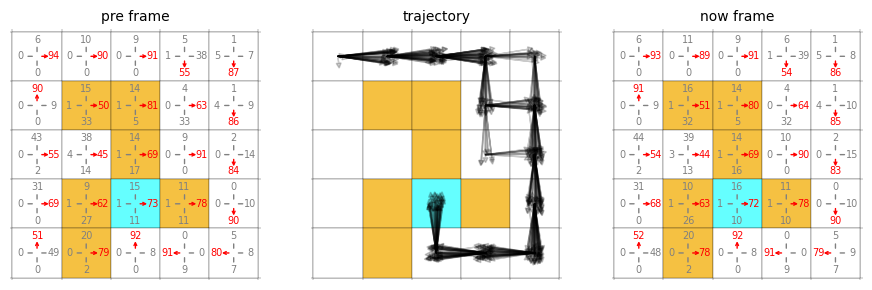

  5%|████▌                                                                                 | 1050/20000 [06:07<1:30:30,  3.49it/s]

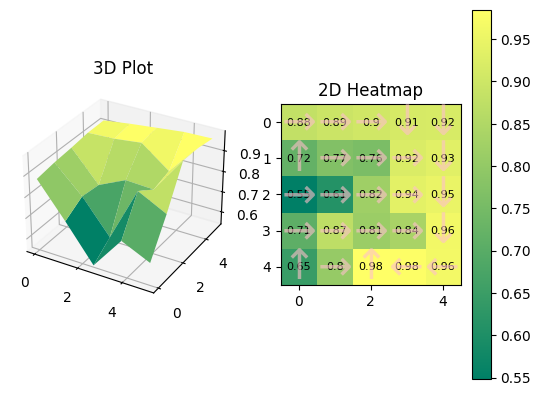

0.8804369	0.8944925	0.9029262	0.91468346	0.91621697	
0.7193197	0.77032554	0.75925004	0.92014956	0.93351555	
0.547953	0.6121117	0.82031727	0.93551815	0.9476162	
0.7084117	0.8722236	0.8133457	0.8364582	0.96138906	
0.6466081	0.8043159	0.9847213	0.9809308	0.96467257	
buffer_size 515
515
515


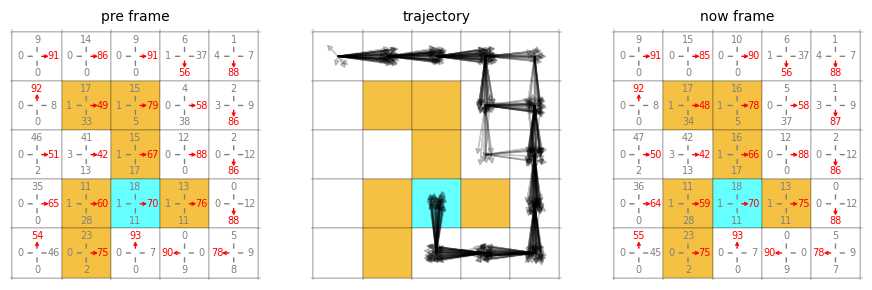

  6%|████▋                                                                                 | 1100/20000 [06:24<1:32:42,  3.40it/s]

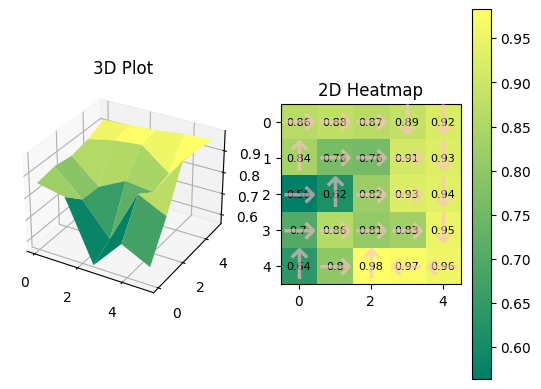

0.86355275	0.8781412	0.8660109	0.8854562	0.9203178	
0.83775765	0.76216525	0.75691867	0.91189456	0.9265896	
0.5638062	0.61592674	0.81999654	0.92519635	0.9353227	
0.7022992	0.8606962	0.80532795	0.8291136	0.95048755	
0.6383748	0.7989858	0.98283815	0.97245485	0.9550181	
buffer_size 524
524
524


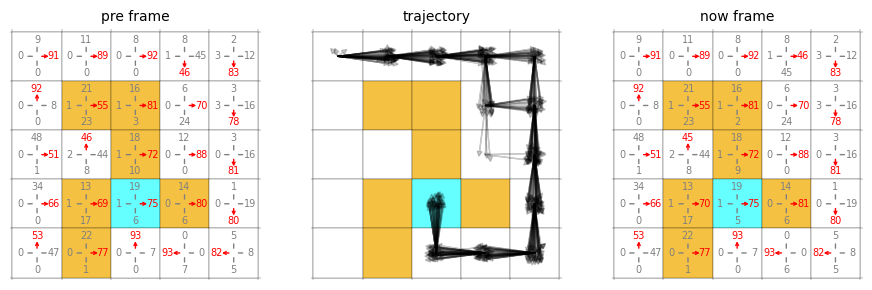

  6%|████▉                                                                                 | 1150/20000 [06:42<1:29:54,  3.49it/s]

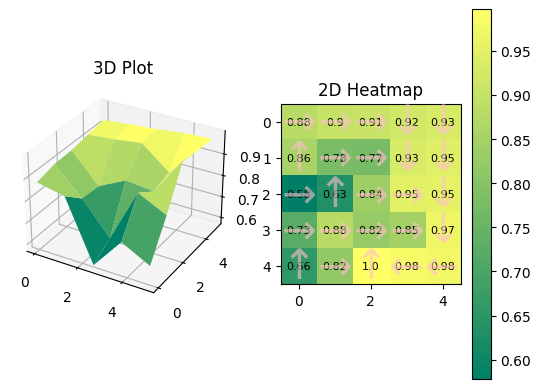

0.8811934	0.9026394	0.9061123	0.9210218	0.9331325	
0.8557737	0.78063107	0.77394485	0.9314834	0.94505525	
0.57789063	0.6346264	0.83693707	0.94876087	0.95450807	
0.72520876	0.88050985	0.8231231	0.8483213	0.96928716	
0.6577275	0.81773496	0.9976485	0.9838439	0.9762368	
buffer_size 518
518
518


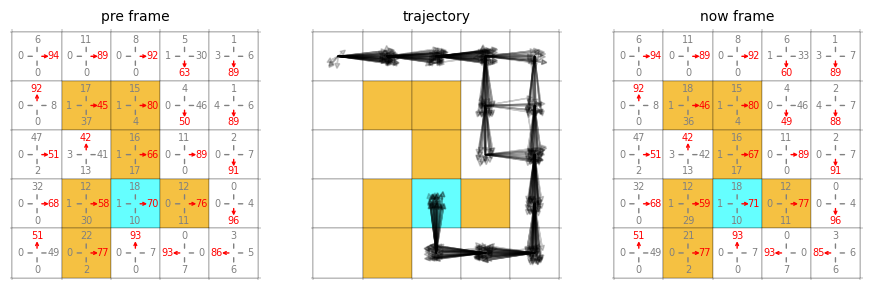

  6%|█████▏                                                                                | 1200/20000 [06:59<1:28:22,  3.55it/s]

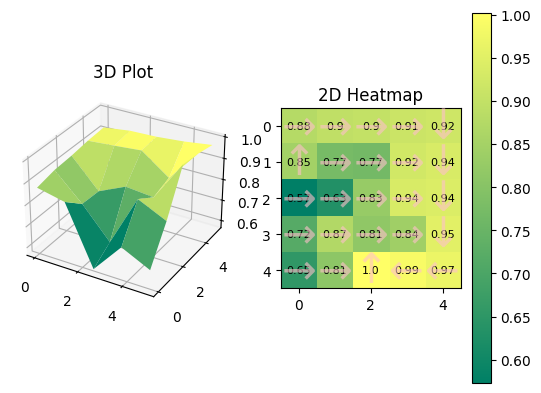

0.8765223	0.8954924	0.9015173	0.9128776	0.91854846	
0.84853107	0.7734084	0.7684712	0.92316157	0.9359658	
0.5729934	0.63065445	0.8272697	0.9350334	0.9404237	
0.71820295	0.8716346	0.81466526	0.8417552	0.9518238	
0.65381587	0.8096483	1.0014886	0.98889166	0.9696434	
buffer_size 513
513
513


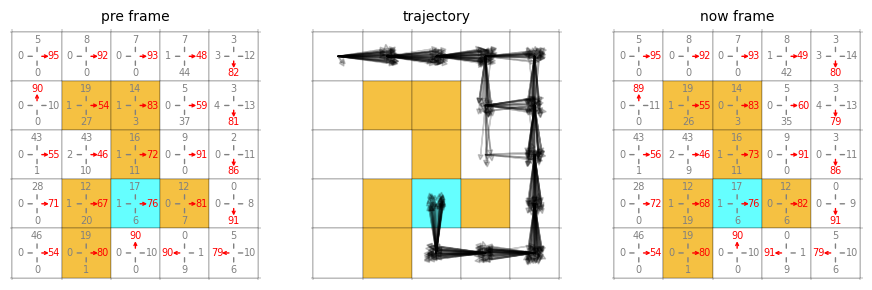

  6%|█████▍                                                                                | 1250/20000 [07:17<1:30:05,  3.47it/s]

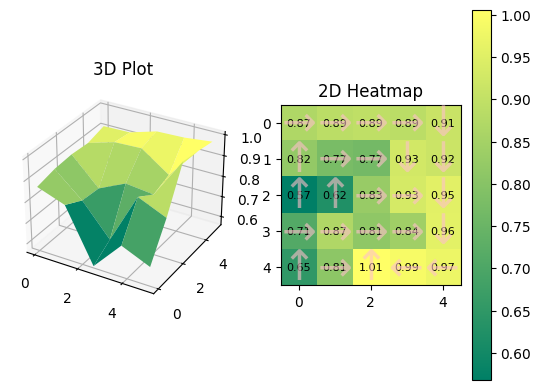

0.8673997	0.88789064	0.8949118	0.8889384	0.9123007	
0.8208181	0.7747622	0.7666021	0.9280335	0.9157181	
0.5678741	0.6243311	0.8281977	0.93346244	0.9544698	
0.7097259	0.8686292	0.8135993	0.84180814	0.959099	
0.65116477	0.8102531	1.0053185	0.990908	0.9742389	
buffer_size 519
519
519


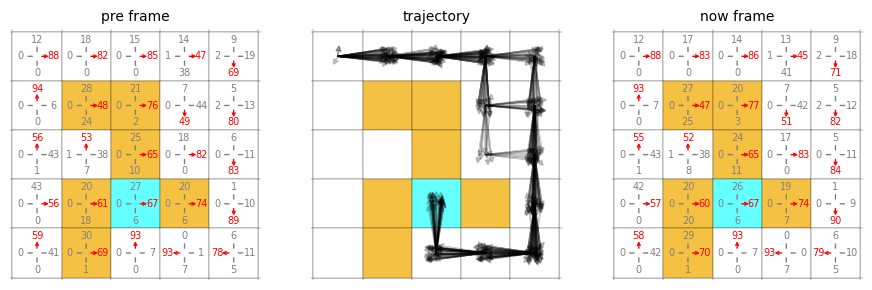

  6%|█████▌                                                                                | 1300/20000 [07:34<1:27:24,  3.57it/s]

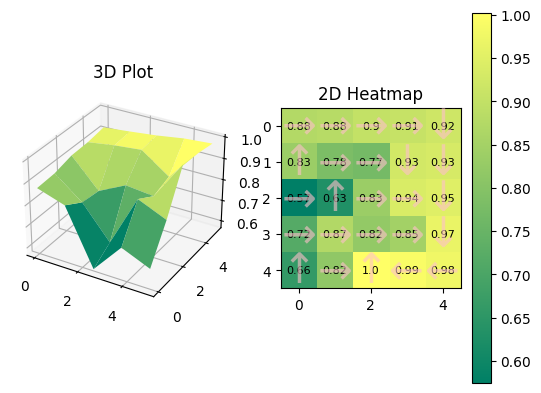

0.8751707	0.8806484	0.90287447	0.90648293	0.91953015	
0.83356893	0.78146803	0.7706597	0.925154	0.9325888	
0.57446563	0.6303241	0.8342792	0.93813384	0.9469483	
0.7175087	0.8721224	0.820766	0.84779537	0.9661852	
0.66091764	0.81539965	1.0016232	0.99140763	0.976266	
buffer_size 517
517
517


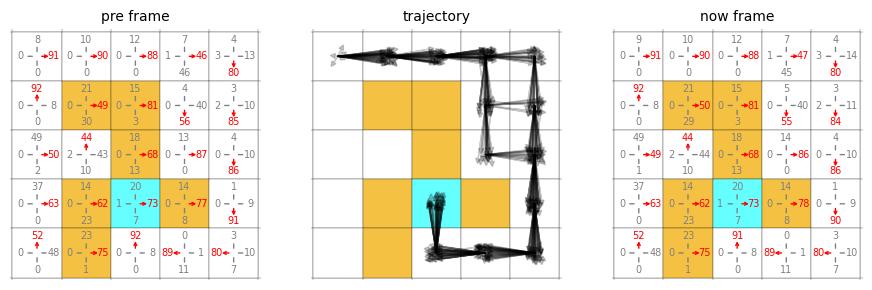

  7%|█████▊                                                                                | 1350/20000 [07:52<1:31:36,  3.39it/s]

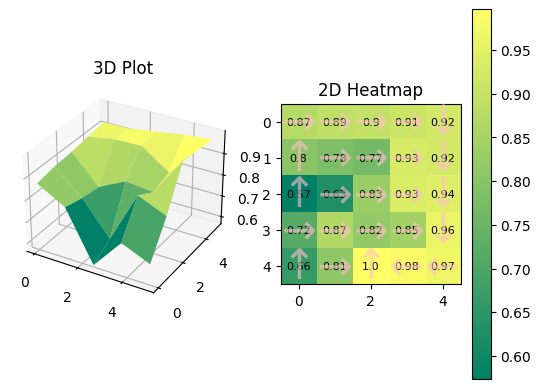

0.87418693	0.88997227	0.89625794	0.9096219	0.9210253	
0.80364305	0.78039885	0.76795197	0.93024766	0.92379177	
0.5736405	0.6271237	0.83068186	0.93341744	0.9404384	
0.7183522	0.86712396	0.8172012	0.8453696	0.9608766	
0.662304	0.81122494	0.99646986	0.983445	0.97060615	
buffer_size 529
529
529


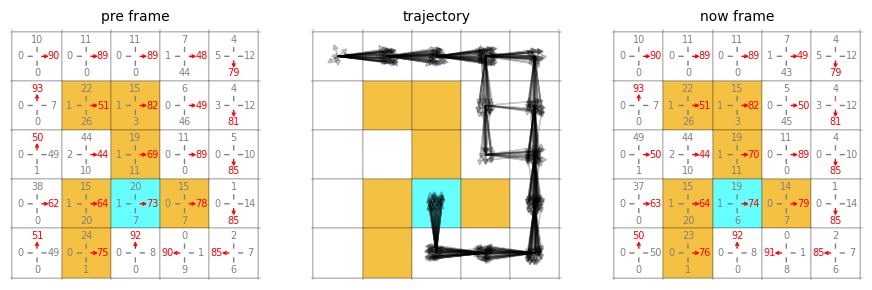

  7%|██████                                                                                | 1400/20000 [08:09<1:26:19,  3.59it/s]

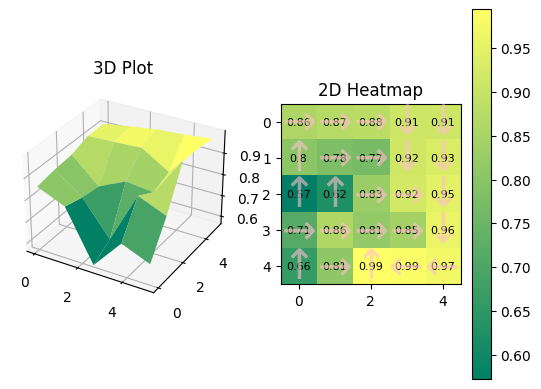

0.8575135	0.8735093	0.88137853	0.91050416	0.9112533	
0.8042057	0.7805455	0.7685604	0.9153192	0.931453	
0.5723386	0.62345773	0.82828474	0.9224647	0.94954556	
0.71411973	0.86291456	0.8145777	0.8455176	0.9589374	
0.660655	0.8101465	0.99413	0.9864627	0.97281367	
buffer_size 512
512
512


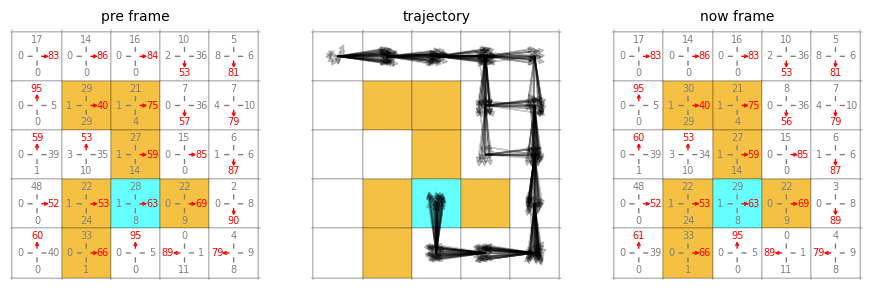

  7%|██████▏                                                                               | 1450/20000 [08:26<1:30:25,  3.42it/s]

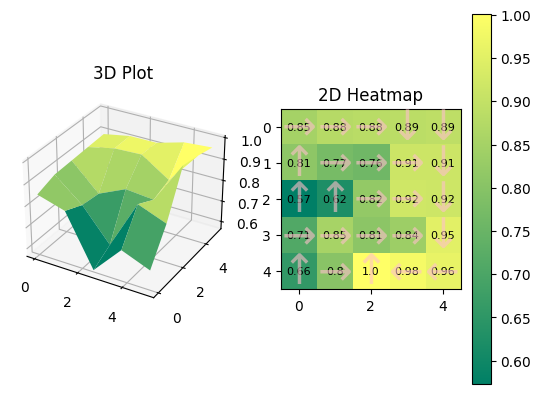

0.849091	0.8784296	0.8825219	0.88687843	0.89103657	
0.81136644	0.772477	0.76118886	0.9146234	0.91479737	
0.57303756	0.62216526	0.81965667	0.9200921	0.91603583	
0.70942485	0.85229576	0.80749434	0.83591056	0.95179415	
0.6569448	0.8019135	1.0006418	0.983813	0.9617395	
buffer_size 514
514
514


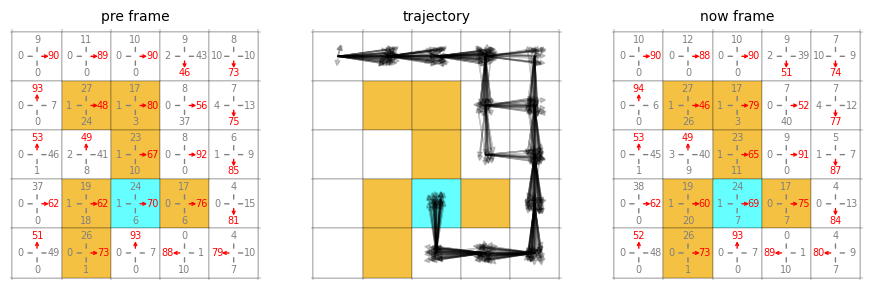

  8%|██████▍                                                                               | 1500/20000 [08:43<1:22:36,  3.73it/s]

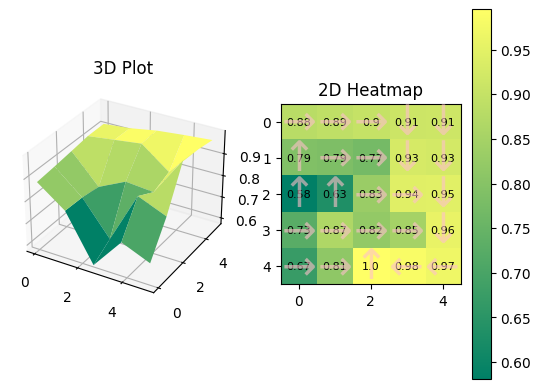

0.88163036	0.8906133	0.90125835	0.9126297	0.91325927	
0.7900693	0.7859369	0.7715263	0.9279996	0.9251588	
0.58102375	0.6324699	0.83139616	0.943705	0.9461793	
0.72569764	0.8653447	0.81989324	0.84940356	0.9584002	
0.6720144	0.8124379	0.9952573	0.9841847	0.96848243	
buffer_size 514
514
514


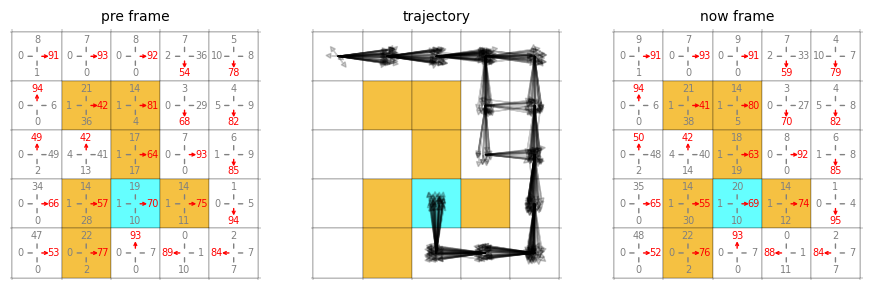

  8%|██████▋                                                                               | 1550/20000 [09:01<1:32:34,  3.32it/s]

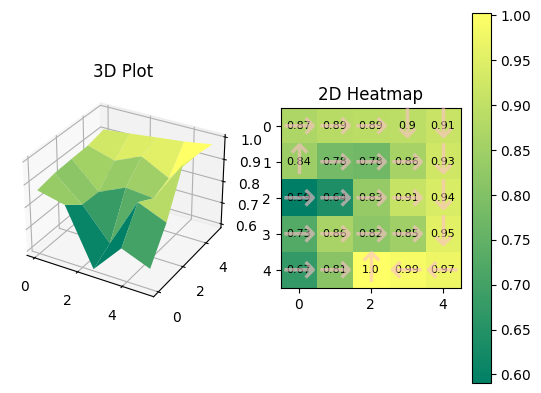

0.87066996	0.88645905	0.89180744	0.89540666	0.9135847	
0.842307	0.77970815	0.77521175	0.8586781	0.9262034	
0.5905153	0.63941896	0.8308025	0.9115873	0.94082487	
0.72535425	0.8638072	0.8182818	0.8471154	0.95428777	
0.67403007	0.81094325	1.0021935	0.9892002	0.97416556	
buffer_size 513
513
513


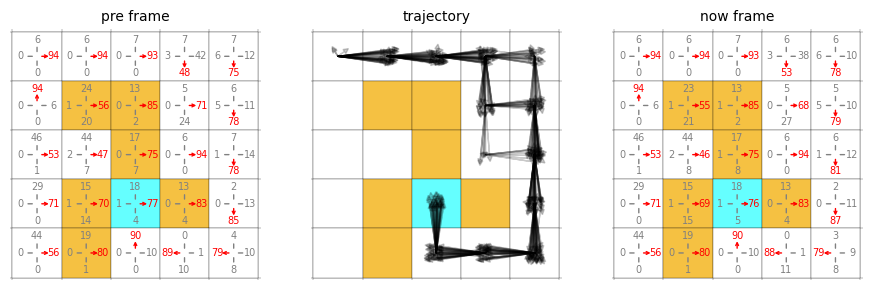

  8%|██████▉                                                                               | 1600/20000 [09:18<1:30:06,  3.40it/s]

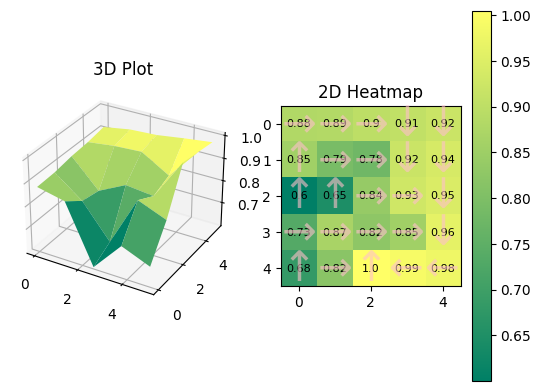

0.88082814	0.8851481	0.89871734	0.9054925	0.9190043	
0.85431844	0.7935475	0.77737385	0.9201806	0.93915564	
0.6001231	0.64643896	0.8380766	0.92694044	0.94556785	
0.73358643	0.86841357	0.8246288	0.85496205	0.962614	
0.682557	0.81912345	1.0041646	0.9904265	0.9774279	
buffer_size 512
512
512


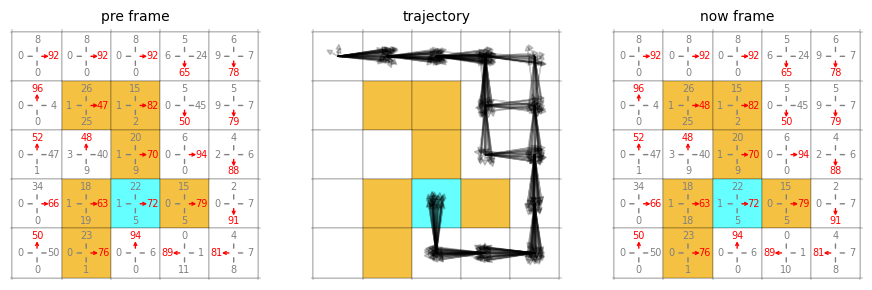

  8%|███████                                                                               | 1650/20000 [09:36<1:25:23,  3.58it/s]

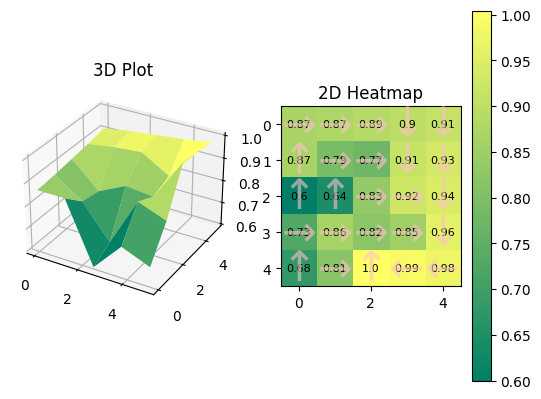

0.8661655	0.8740028	0.8853497	0.89632803	0.9112082	
0.866391	0.79141915	0.77480036	0.91401756	0.9320898	
0.5994674	0.6446408	0.8335786	0.9244779	0.94432074	
0.7298806	0.86168337	0.8210259	0.85254747	0.95788556	
0.6797573	0.8146161	1.0034353	0.9916336	0.9755653	
buffer_size 515
515
515


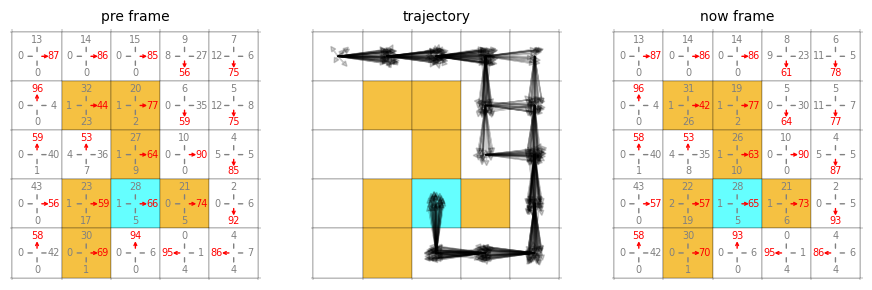

  8%|███████▎                                                                              | 1700/20000 [09:53<1:26:30,  3.53it/s]

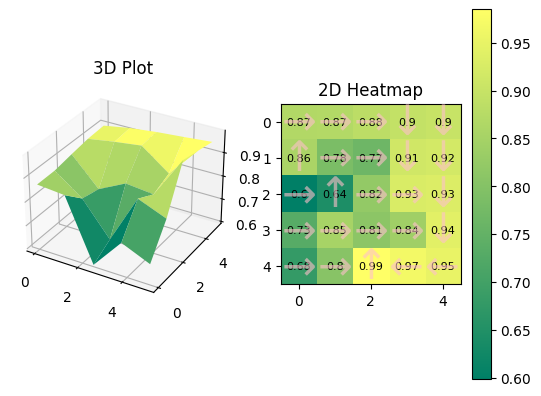

0.8680881	0.8691995	0.8830043	0.89519596	0.8998703	
0.8576689	0.7844453	0.7656683	0.91301954	0.9194344	
0.59871113	0.6436843	0.8235676	0.9277848	0.93220663	
0.73052764	0.852196	0.81121635	0.84173715	0.9413171	
0.6787988	0.8044255	0.98527443	0.96850085	0.9515896	
buffer_size 517
517
517


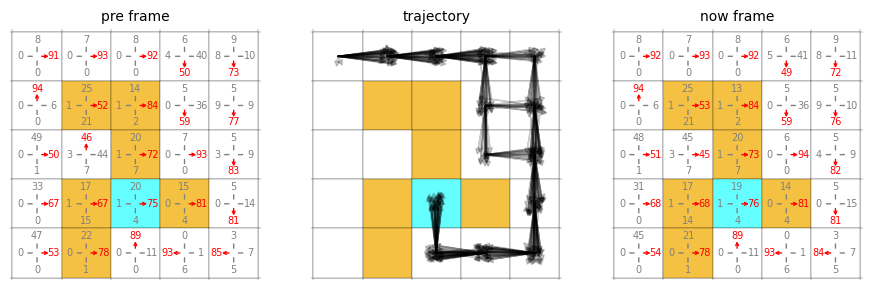

  9%|███████▌                                                                              | 1750/20000 [10:10<1:26:19,  3.52it/s]

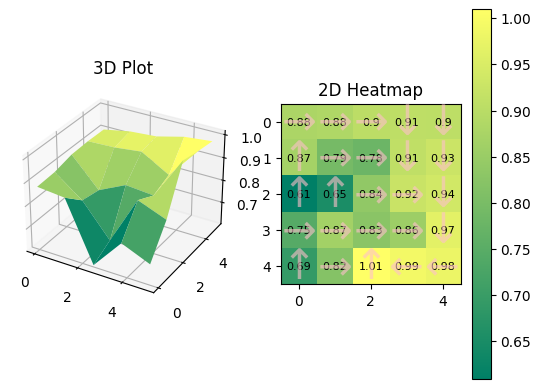

0.87958926	0.88440937	0.9034661	0.9068065	0.90480196	
0.8676899	0.7946133	0.778723	0.91098946	0.9274437	
0.6092737	0.6527973	0.8361648	0.92476964	0.9364257	
0.74509996	0.86648935	0.8256151	0.8555881	0.9662599	
0.6927315	0.8186197	1.0095148	0.99163824	0.9786164	
buffer_size 514
514
514


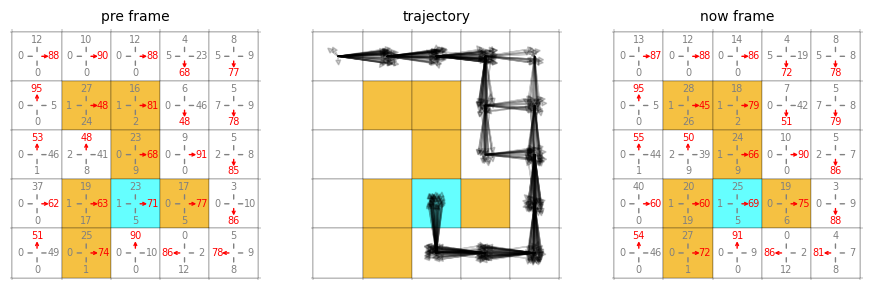

  9%|███████▋                                                                              | 1800/20000 [10:27<1:23:57,  3.61it/s]

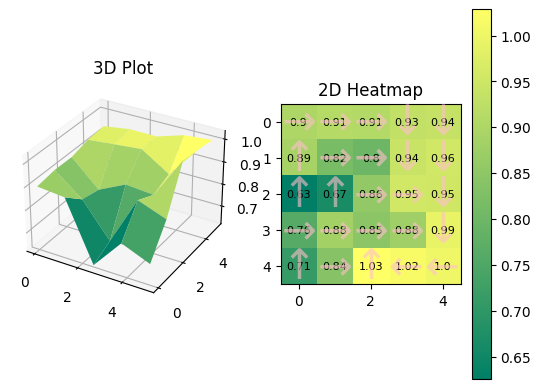

0.89890534	0.9115969	0.9104422	0.9315656	0.93823755	
0.8873389	0.8168448	0.798503	0.9430442	0.9558278	
0.6260526	0.66689426	0.85667825	0.9546443	0.95453775	
0.76249266	0.8846722	0.8461317	0.87705314	0.9919572	
0.7110341	0.83859366	1.0284536	1.0165207	1.0026517	
buffer_size 519
519
519


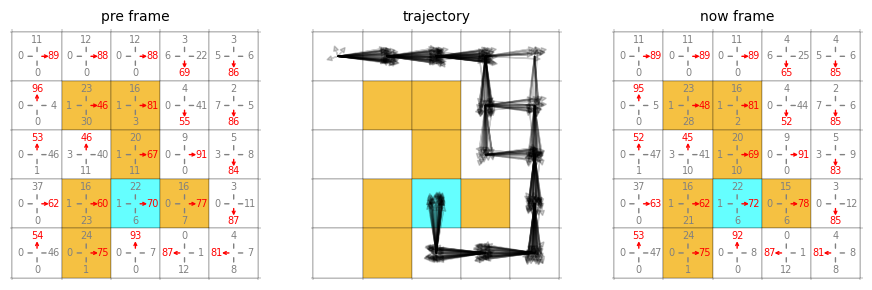

  9%|███████▉                                                                              | 1850/20000 [10:44<1:25:18,  3.55it/s]

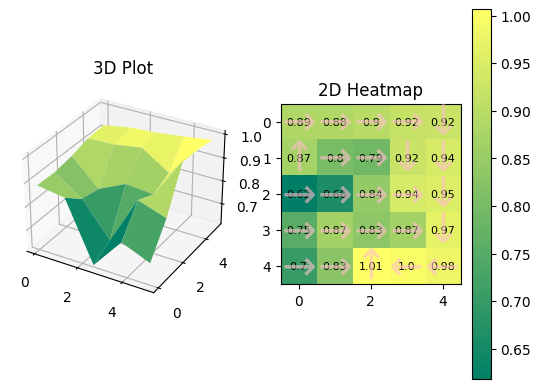

0.8865917	0.88440573	0.89718187	0.91931415	0.9240954	
0.86867404	0.8047025	0.78831494	0.92311406	0.9442955	
0.6180465	0.66112304	0.8430939	0.94155824	0.95229745	
0.753476	0.867784	0.8325926	0.86618364	0.96582055	
0.70405185	0.82776034	1.006764	0.99641836	0.98231816	
buffer_size 524
524
524


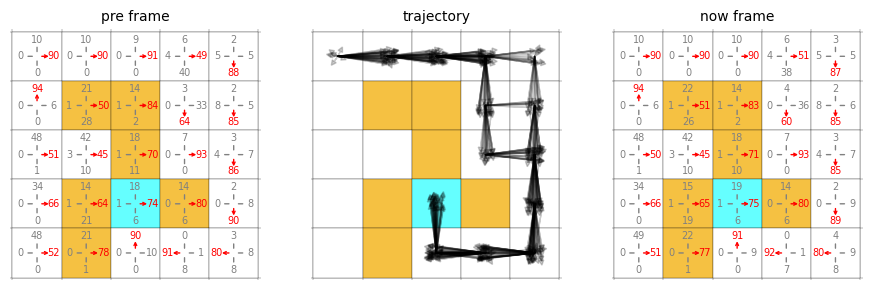

 10%|████████▏                                                                             | 1900/20000 [11:01<1:24:52,  3.55it/s]

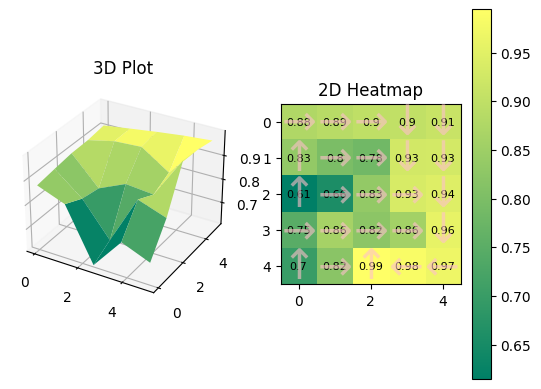

0.8768996	0.88865817	0.8993567	0.90166676	0.91253006	
0.83356845	0.79763913	0.78324986	0.9270388	0.9285896	
0.61455286	0.65701485	0.8344517	0.93381846	0.94434667	
0.7475661	0.8613229	0.82372725	0.8582126	0.95801353	
0.7002572	0.8207052	0.9945649	0.98477054	0.96802557	
buffer_size 515
515
515


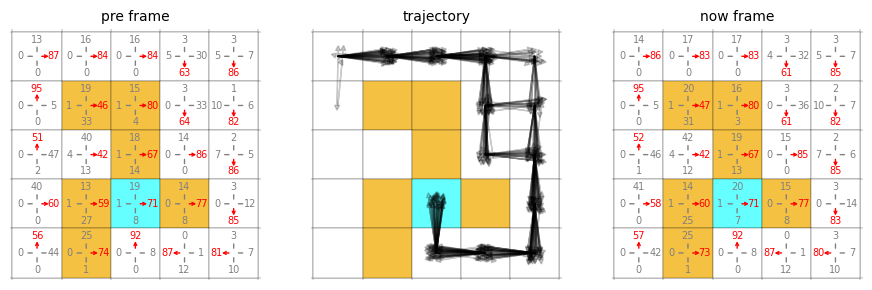

 10%|████████▍                                                                             | 1950/20000 [11:18<1:24:28,  3.56it/s]

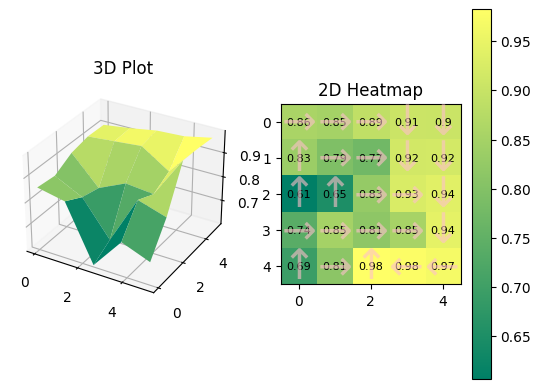

0.85742664	0.84947646	0.88979495	0.905813	0.9038856	
0.8344463	0.79363465	0.77454853	0.9153652	0.91903126	
0.6061981	0.6494826	0.82640564	0.9258934	0.93804336	
0.73816884	0.8488399	0.81498194	0.85222185	0.9439527	
0.69351035	0.8128971	0.982442	0.9771768	0.9673941	
buffer_size 514
514
514


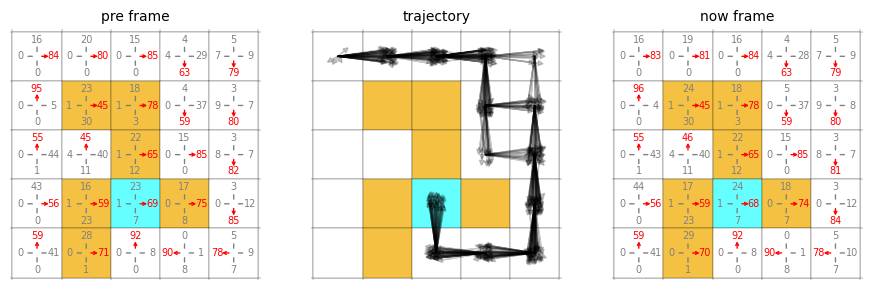

 10%|████████▌                                                                             | 2000/20000 [11:35<1:23:35,  3.59it/s]

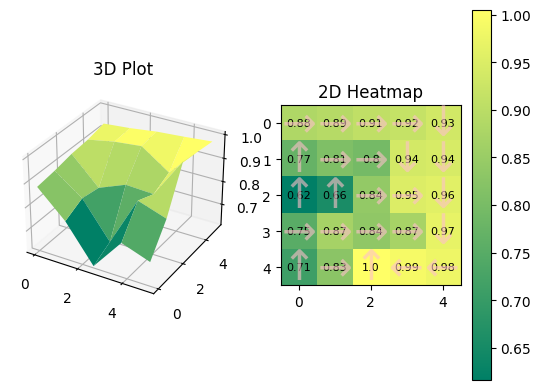

0.8821213	0.892794	0.90864086	0.9160222	0.9332285	
0.77224135	0.8092005	0.79512274	0.9376757	0.94344187	
0.6163548	0.6562716	0.8419703	0.949873	0.9582722	
0.75354075	0.8680496	0.83591235	0.8696635	0.96690047	
0.7112086	0.82798207	1.004412	0.9899869	0.97740257	
buffer_size 522
522
522


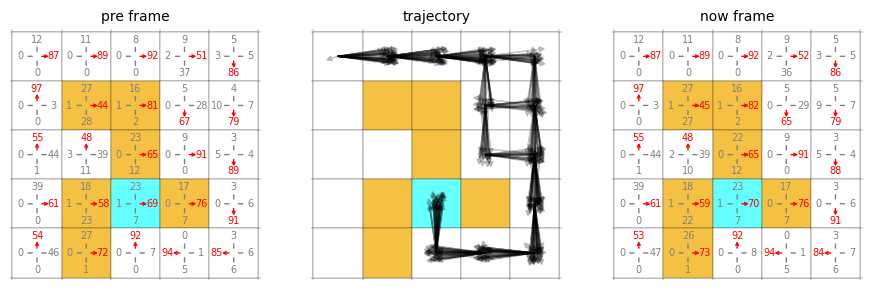

 10%|████████▊                                                                             | 2050/20000 [11:52<1:23:53,  3.57it/s]

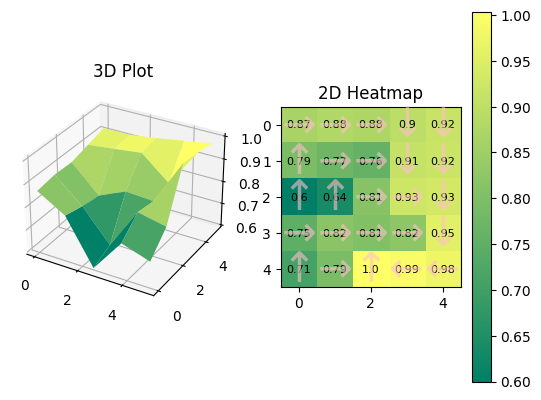

0.8663959	0.87874067	0.87516785	0.8966425	0.9168339	
0.7948199	0.7730846	0.75918275	0.91015047	0.91837335	
0.59951895	0.6359734	0.81291	0.92534804	0.93498504	
0.7489192	0.81937253	0.80534446	0.824254	0.9545019	
0.708288	0.7936306	1.0029736	0.99217504	0.97524685	
buffer_size 512
512
512


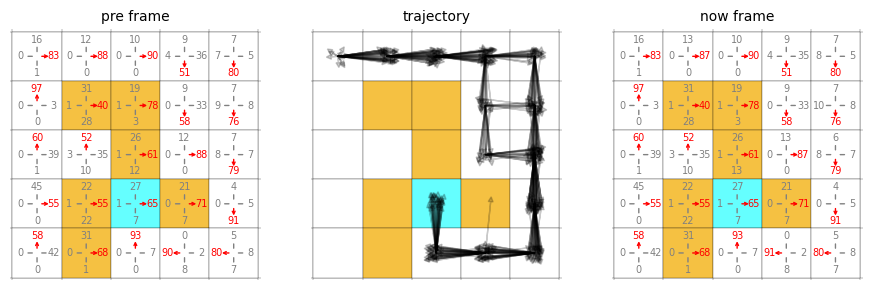

 10%|█████████                                                                             | 2100/20000 [12:10<1:25:48,  3.48it/s]

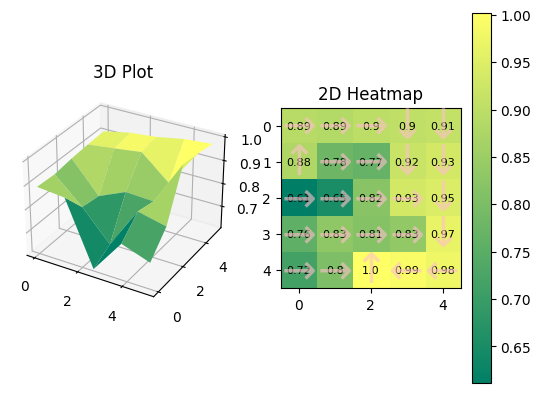

0.89129233	0.88717306	0.8983574	0.90489686	0.90898097	
0.88055885	0.78027606	0.7681818	0.9185382	0.9333081	
0.61141527	0.6538628	0.82014656	0.9343169	0.9452313	
0.7584454	0.83153987	0.8142109	0.83442926	0.9669514	
0.7164996	0.80438554	1.0015992	0.9916352	0.9769031	
buffer_size 512
512
512


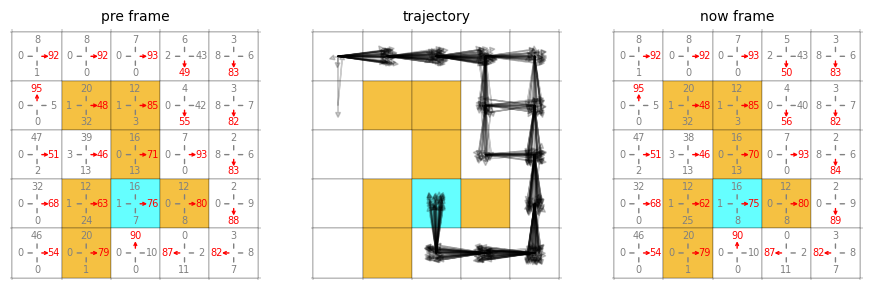

 11%|█████████▏                                                                            | 2150/20000 [12:27<1:23:57,  3.54it/s]

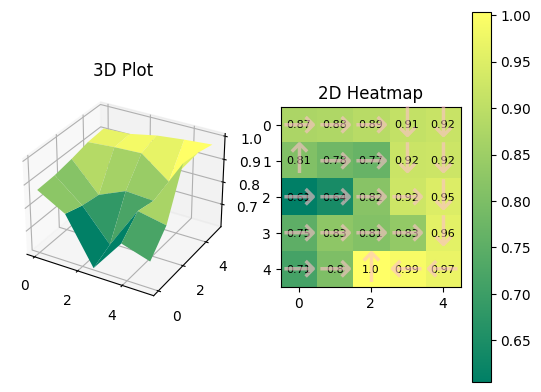

0.8730593	0.8777962	0.8917774	0.9103329	0.9169744	
0.8057164	0.7799095	0.7660812	0.9194912	0.9236276	
0.6050982	0.64269114	0.8174796	0.9248725	0.9475336	
0.75193155	0.8271766	0.80967855	0.8339269	0.9606769	
0.71321297	0.8023584	1.0029877	0.99169874	0.9707309	
buffer_size 516
516
516


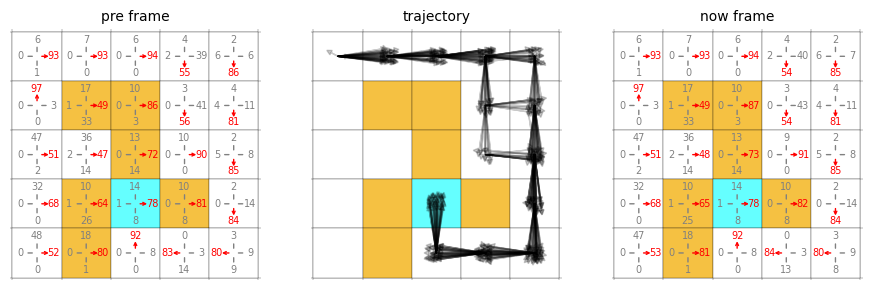

 11%|█████████▍                                                                            | 2200/20000 [12:44<1:23:11,  3.57it/s]

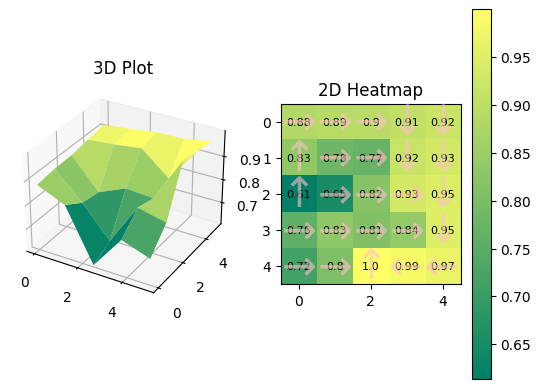

0.8824635	0.89267206	0.8950404	0.90765786	0.91917604	
0.8325168	0.7822251	0.7683365	0.91730636	0.93225163	
0.6136093	0.65269583	0.818299	0.9323126	0.9466248	
0.758595	0.83083254	0.8107983	0.8364367	0.9496865	
0.7174653	0.8040548	0.9999193	0.9856278	0.9688295	
buffer_size 520
520
520


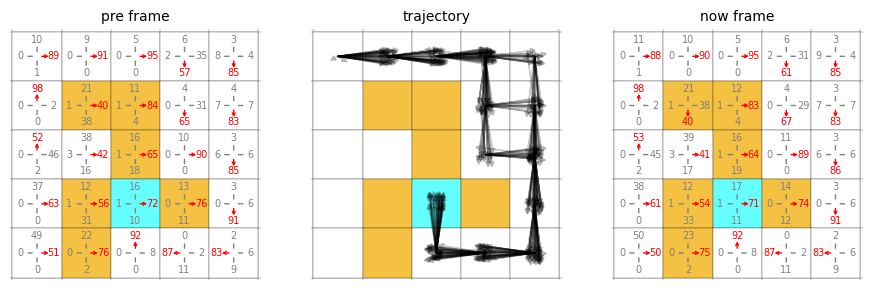

 11%|█████████▋                                                                            | 2250/20000 [13:01<1:23:48,  3.53it/s]

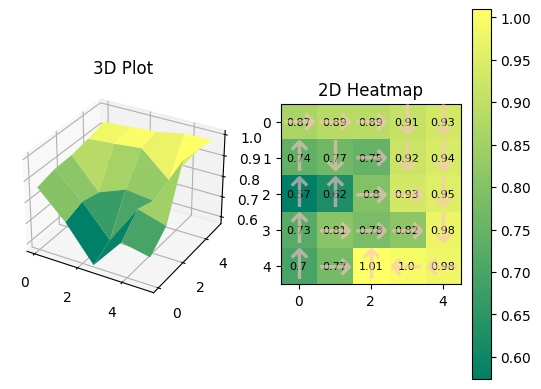

0.8650335	0.8879268	0.8914342	0.90911794	0.9335545	
0.73973984	0.7693949	0.7477603	0.9198259	0.9424681	
0.5739676	0.6224661	0.7993898	0.9334802	0.95312434	
0.7253549	0.8119942	0.7840744	0.81708187	0.9766834	
0.6977418	0.7732561	1.0094764	0.9952941	0.9821981	
buffer_size 514
514
514


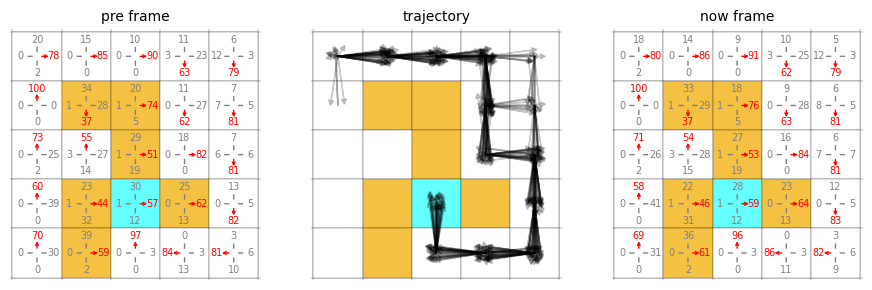

 12%|█████████▉                                                                            | 2300/20000 [13:18<1:22:29,  3.58it/s]

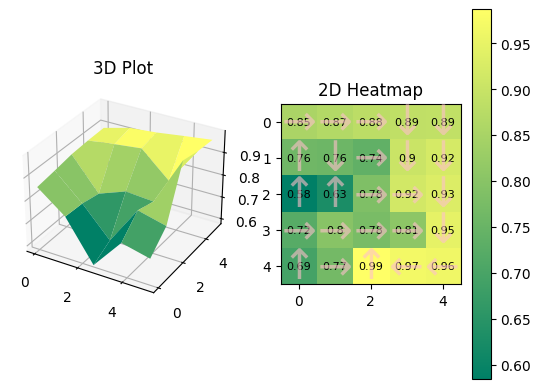

0.85498893	0.8672173	0.8813389	0.88685817	0.8892236	
0.7622898	0.756947	0.7391666	0.90257806	0.9203048	
0.58473575	0.62842846	0.7844818	0.9162812	0.9309479	
0.72269547	0.7993016	0.7754245	0.8070749	0.9470592	
0.69325197	0.76837176	0.987095	0.9697565	0.962046	
buffer_size 515
515
515


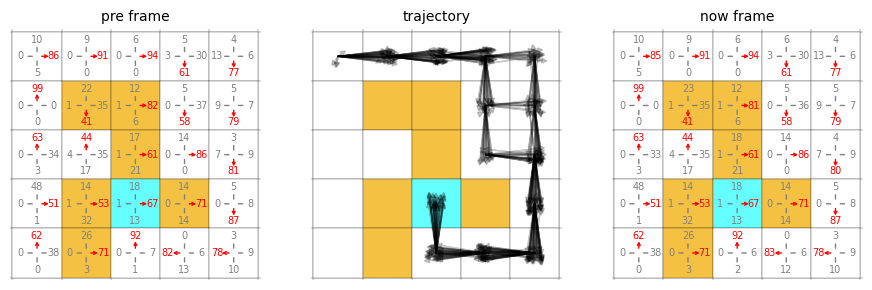

 12%|██████████                                                                            | 2350/20000 [13:35<1:24:53,  3.46it/s]

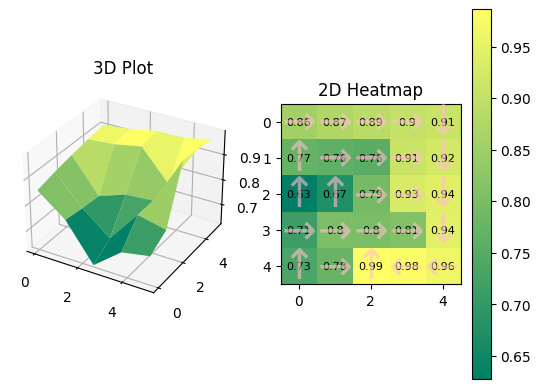

0.855775	0.87415314	0.88877714	0.90164554	0.91028297	
0.7731894	0.762905	0.7558377	0.9101777	0.9230962	
0.62778765	0.6747867	0.7932334	0.93037224	0.9417268	
0.71394116	0.8013036	0.80093193	0.8111942	0.9433844	
0.73395944	0.77607644	0.98595726	0.97974086	0.9649061	
buffer_size 512
512
512


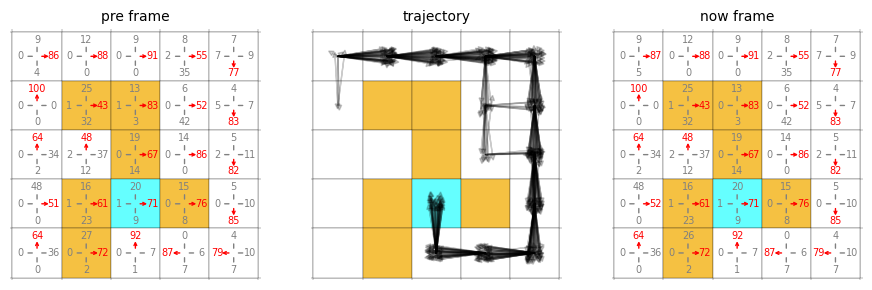

 12%|██████████▎                                                                           | 2400/20000 [13:52<1:20:38,  3.64it/s]

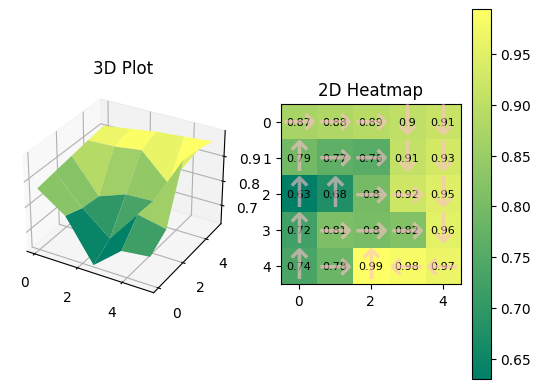

0.86894447	0.8812004	0.89222515	0.90401685	0.914391	
0.7937668	0.7679431	0.759099	0.9080168	0.9301098	
0.6301951	0.6767644	0.79904366	0.9226343	0.9463569	
0.72311544	0.8081779	0.80423903	0.81769717	0.95506275	
0.7356363	0.78324395	0.993806	0.98207414	0.9654461	
buffer_size 512
512
512


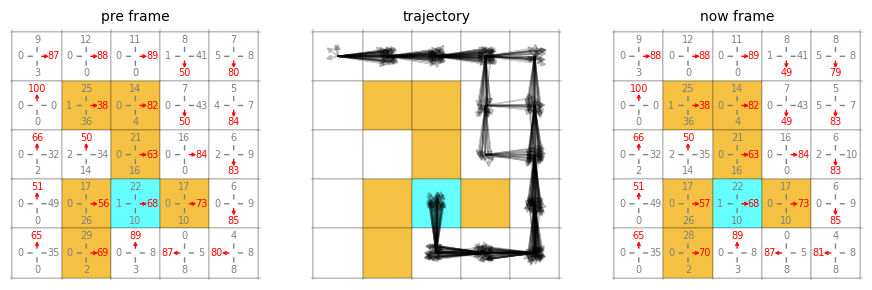

 12%|██████████▌                                                                           | 2450/20000 [14:09<1:20:21,  3.64it/s]

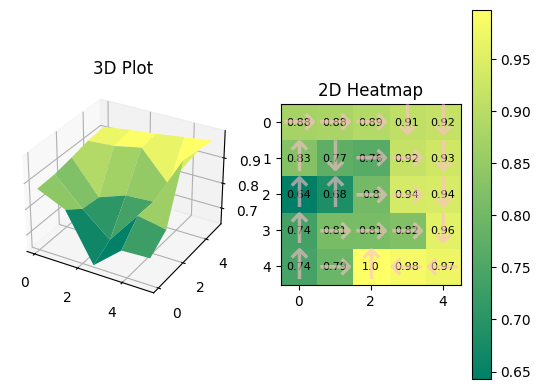

0.87500453	0.87897426	0.89241993	0.9084959	0.91607493	
0.826951	0.7738032	0.76477414	0.9161186	0.9311928	
0.64267606	0.68392175	0.80380934	0.9382357	0.94300663	
0.73545986	0.8117724	0.81043607	0.8237285	0.95846707	
0.74047357	0.79087985	0.9971838	0.98454714	0.9726313	
buffer_size 519
519
519


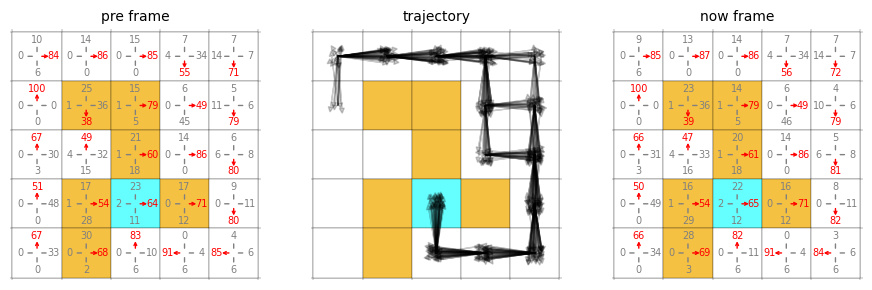

 12%|██████████▊                                                                           | 2500/20000 [14:26<1:22:47,  3.52it/s]

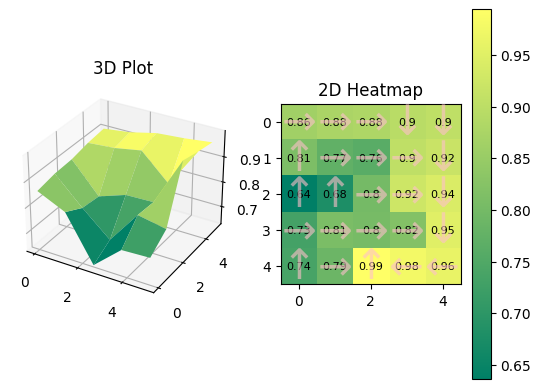

0.8617213	0.876132	0.8805878	0.895923	0.90435743	
0.8118384	0.7719965	0.7627605	0.9040265	0.9175348	
0.6362411	0.6775402	0.8002156	0.9230559	0.94202137	
0.73142064	0.80906403	0.80350316	0.8213414	0.95000505	
0.7361651	0.78777266	0.99437416	0.9764935	0.9625772	
buffer_size 514
514
514


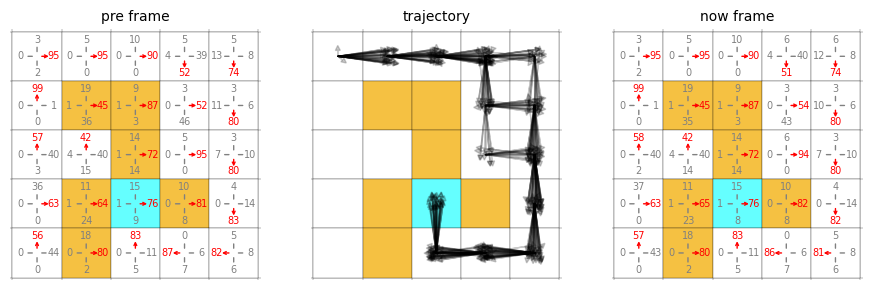

 13%|██████████▉                                                                           | 2550/20000 [14:43<1:21:40,  3.56it/s]

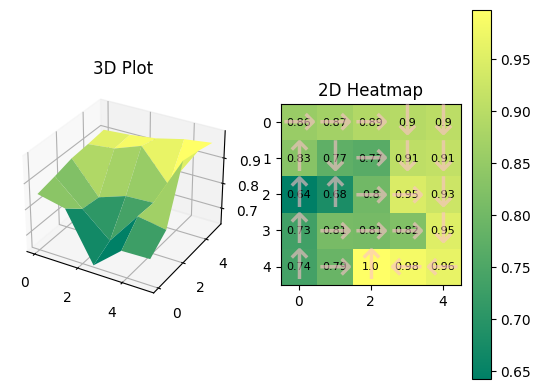

0.85532874	0.8709854	0.8897104	0.89589465	0.9045275	
0.8315594	0.7746295	0.7651363	0.9067028	0.9120328	
0.642594	0.6809311	0.8016362	0.94546354	0.92588276	
0.73466957	0.80970365	0.8066236	0.8224168	0.9507712	
0.7376431	0.79063207	0.9974487	0.98298514	0.9647152	
buffer_size 515
515
515


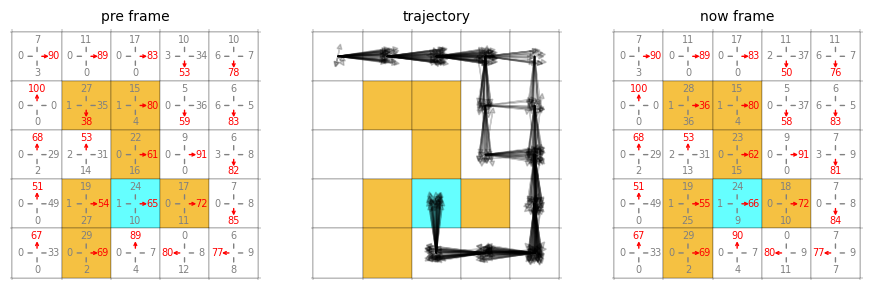

 13%|███████████▏                                                                          | 2600/20000 [15:00<1:21:21,  3.56it/s]

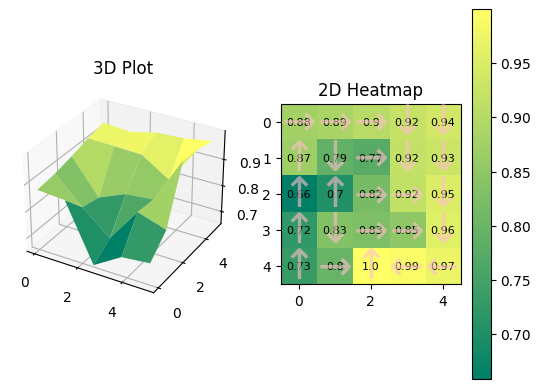

0.8774213	0.8864506	0.9025784	0.92314637	0.9369758	
0.86991626	0.79098976	0.7748213	0.92012143	0.9283841	
0.6588976	0.7043642	0.81817156	0.91636896	0.95146126	
0.72300494	0.834168	0.8277758	0.8507171	0.9567084	
0.7336234	0.79968077	0.9994484	0.99057895	0.97378105	
buffer_size 519
519
519


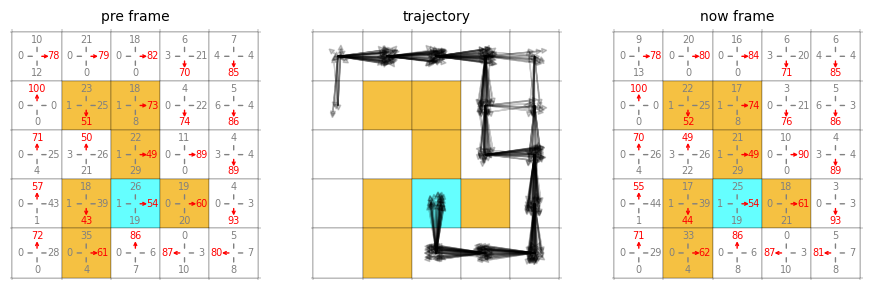

 13%|███████████▍                                                                          | 2650/20000 [15:17<1:21:29,  3.55it/s]

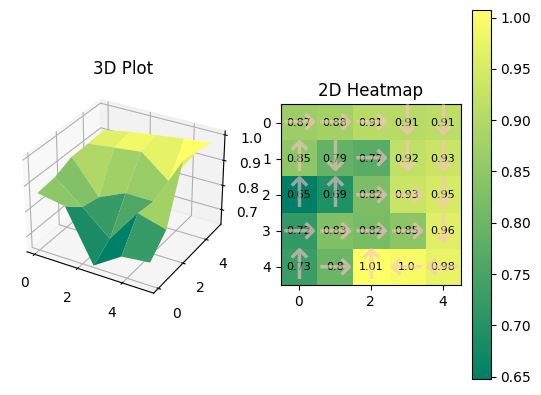

0.8678061	0.8766953	0.90510595	0.90726054	0.91270953	
0.8484851	0.7894642	0.7729474	0.91992885	0.934216	
0.6471095	0.6945989	0.8217452	0.93229055	0.9483688	
0.7188393	0.83044475	0.81963176	0.8451922	0.963376	
0.73097694	0.7987837	1.0074682	0.9955085	0.9752021	
buffer_size 515
515
515


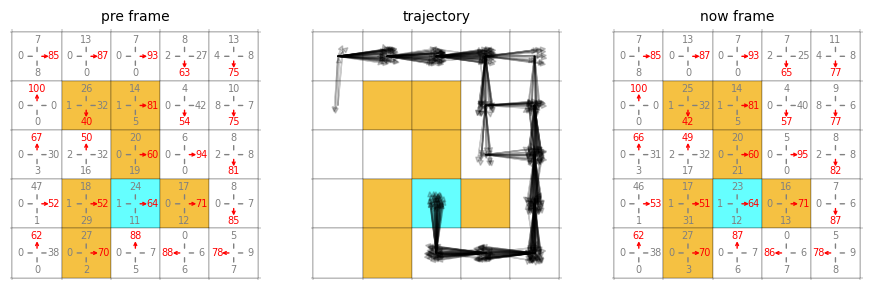

 14%|███████████▌                                                                          | 2700/20000 [15:34<1:22:23,  3.50it/s]

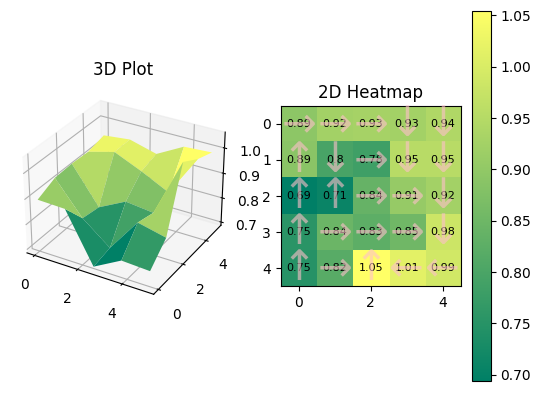

0.89291954	0.92475986	0.92866004	0.9252658	0.9425417	
0.88911366	0.79555833	0.7833916	0.95365286	0.95391834	
0.6940975	0.7090434	0.83858573	0.90619016	0.9243994	
0.7543647	0.84461474	0.8259765	0.8522234	0.9823662	
0.74848926	0.81870425	1.054149	1.0137516	0.9886724	
buffer_size 512
512
512


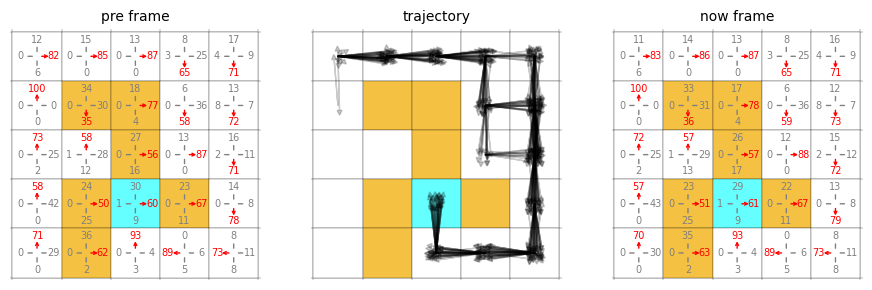

 14%|███████████▊                                                                          | 2750/20000 [15:51<1:20:40,  3.56it/s]

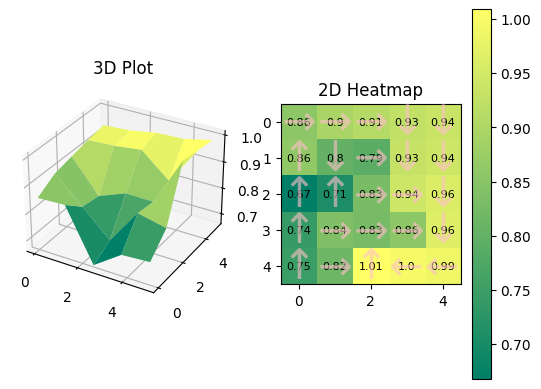

0.8569357	0.89655286	0.911147	0.92553437	0.93634033	
0.8613809	0.8016265	0.78951067	0.9308732	0.94278693	
0.66762316	0.70544386	0.83017343	0.9432038	0.9603548	
0.7401781	0.83944255	0.8281636	0.85602367	0.964109	
0.74712527	0.81518143	1.0089995	0.99659413	0.9868734	
buffer_size 519
519
519


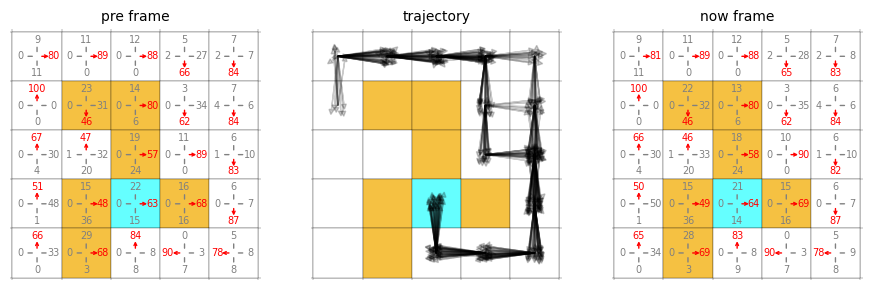

 14%|████████████                                                                          | 2800/20000 [16:08<1:22:36,  3.47it/s]

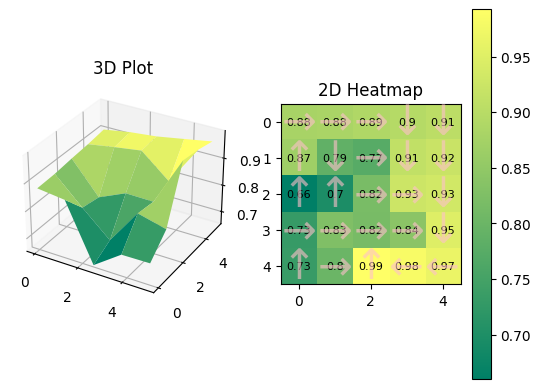

0.87909424	0.8820099	0.8899875	0.8961938	0.90555567	
0.86707	0.78706443	0.77423376	0.91195434	0.92169106	
0.66003096	0.6968491	0.81851584	0.9260509	0.9318886	
0.7314806	0.8266819	0.81683606	0.8419148	0.9487882	
0.732979	0.80013543	0.99266106	0.9825811	0.96622837	
buffer_size 518
518
518


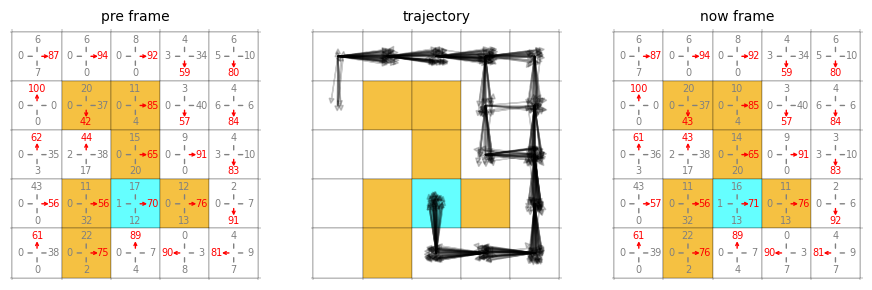

 14%|████████████▎                                                                         | 2850/20000 [16:25<1:20:45,  3.54it/s]

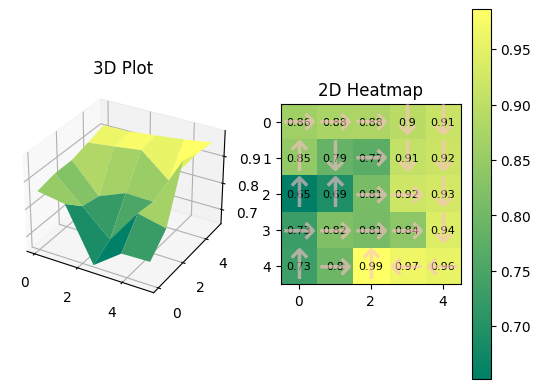

0.86195534	0.87635994	0.8772294	0.89547586	0.91468334	
0.84522796	0.7853532	0.77093697	0.90705866	0.9172078	
0.65220463	0.6915082	0.8121087	0.92096657	0.9283492	
0.727911	0.8194953	0.80910516	0.8366067	0.9403164	
0.7308948	0.7954223	0.986118	0.96524864	0.955214	
buffer_size 521
521
521


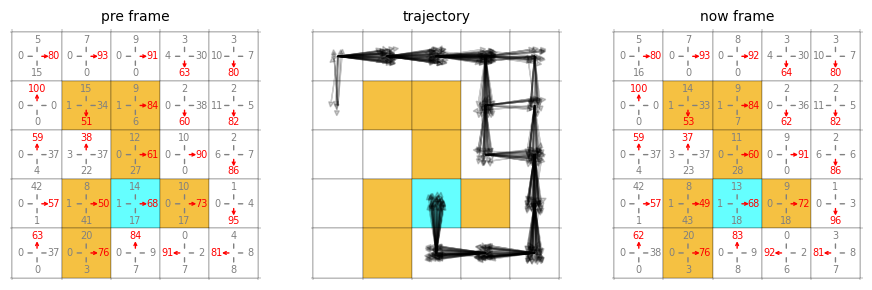

 14%|████████████▍                                                                         | 2900/20000 [16:43<1:19:53,  3.57it/s]

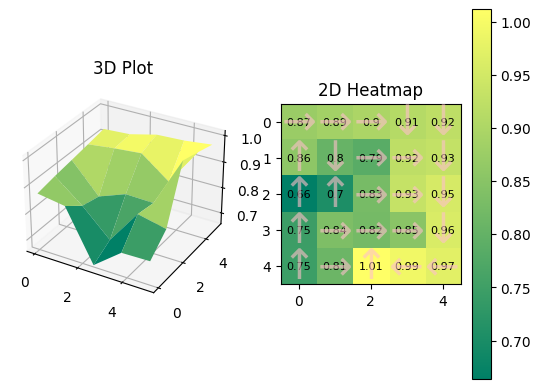

0.8734147	0.8873177	0.89841396	0.9102896	0.92272156	
0.85712737	0.8040293	0.7863535	0.92232305	0.92921424	
0.6639899	0.7036853	0.8260468	0.93159336	0.9547064	
0.7457906	0.835262	0.8228671	0.85227317	0.9597073	
0.7481007	0.81110936	1.0113933	0.99211806	0.9717137	
buffer_size 515
515
515


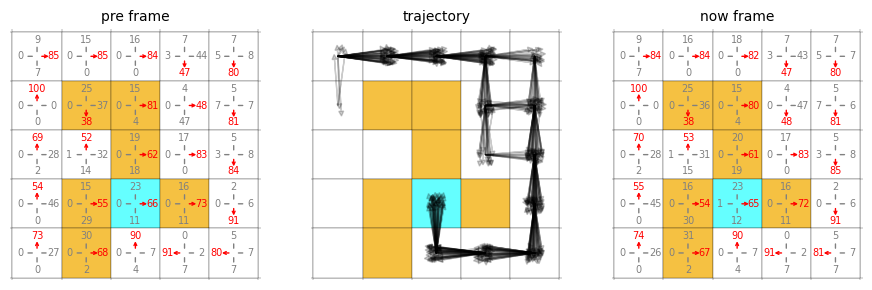

 15%|████████████▋                                                                         | 2950/20000 [16:59<1:19:30,  3.57it/s]

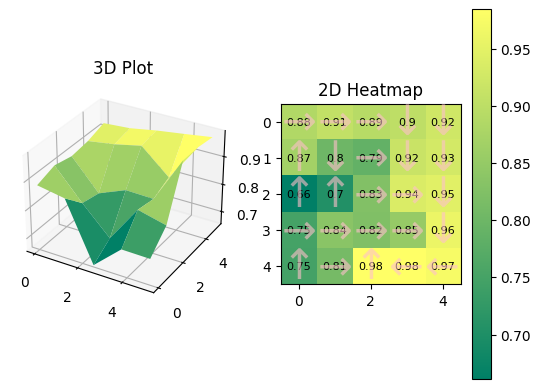

0.88476926	0.90674335	0.89289904	0.90205115	0.9230164	
0.8676716	0.80100745	0.7865238	0.91606617	0.9296574	
0.66109383	0.7041724	0.82640964	0.9366286	0.9463922	
0.7492385	0.83554906	0.8235501	0.85135734	0.9596141	
0.74756044	0.8107774	0.9844554	0.9835929	0.97361755	
buffer_size 519
519
519


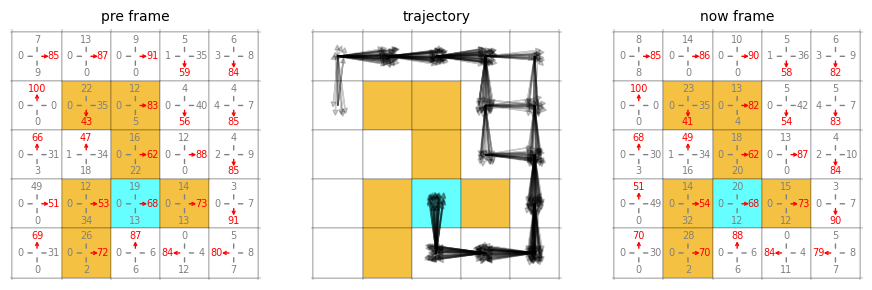

 15%|████████████▉                                                                         | 3000/20000 [17:17<1:19:07,  3.58it/s]

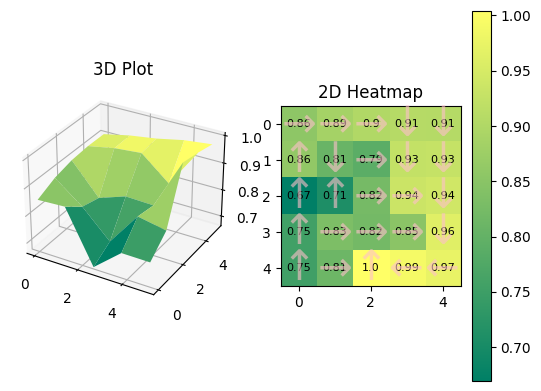

0.8552335	0.885267	0.901532	0.9071954	0.9063389	
0.86024195	0.80811	0.78930545	0.9261673	0.9273892	
0.66948456	0.70910174	0.82448155	0.93522316	0.94204146	
0.7545186	0.8329587	0.82097507	0.85117835	0.9625565	
0.7534369	0.81281674	1.0036657	0.99059916	0.97393274	
buffer_size 517
517
517


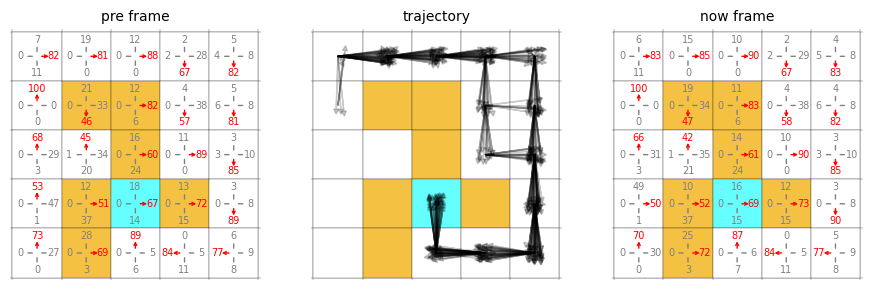

 15%|█████████████                                                                         | 3050/20000 [17:34<1:20:07,  3.53it/s]

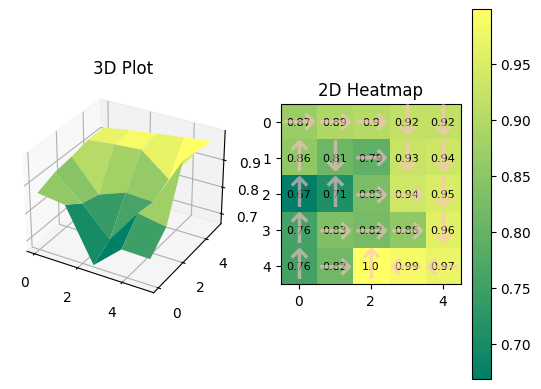

0.8697866	0.8945401	0.90415907	0.9190972	0.9201478	
0.85652745	0.81048596	0.79208255	0.9290776	0.93569076	
0.66850084	0.7087478	0.828537	0.9358754	0.9487699	
0.75853217	0.83474433	0.8231764	0.85586655	0.9615452	
0.7562683	0.8162079	0.9989977	0.9871608	0.9731363	
buffer_size 519
519
519


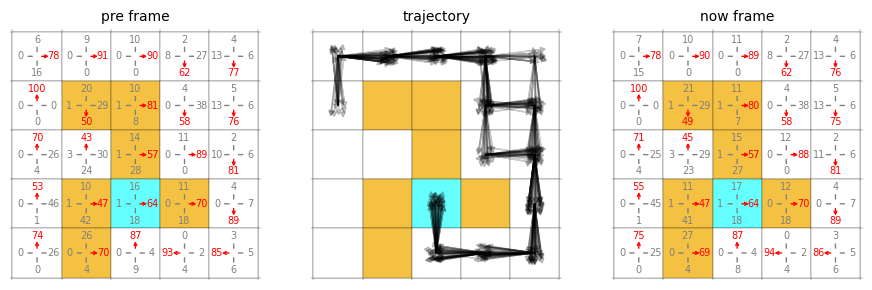

 16%|█████████████▎                                                                        | 3100/20000 [17:51<1:18:41,  3.58it/s]

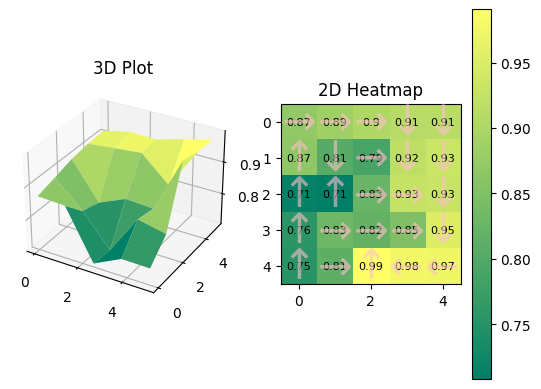

0.8699722	0.8853936	0.9017961	0.9103216	0.9127983	
0.8664148	0.80557454	0.7881918	0.91871905	0.9311627	
0.71341765	0.7083086	0.8252573	0.9268862	0.9291663	
0.75573325	0.83118665	0.81950164	0.8505249	0.9527519	
0.75454426	0.81252754	0.9905729	0.97675276	0.9734142	
buffer_size 519
519
519


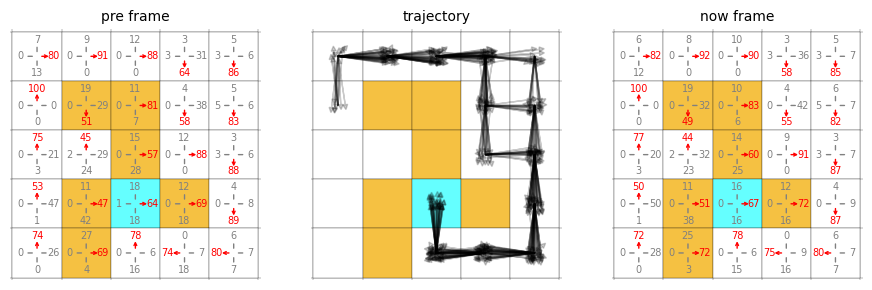

 16%|█████████████▌                                                                        | 3150/20000 [18:08<1:19:29,  3.53it/s]

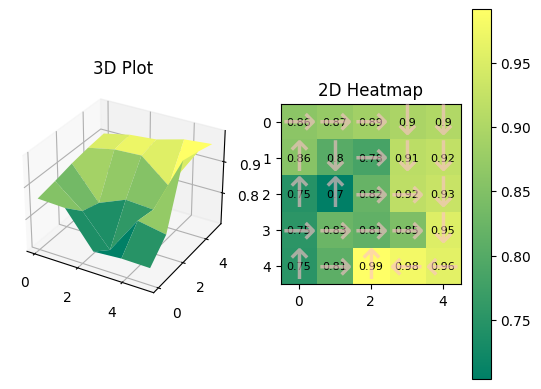

0.8614379	0.87313545	0.8869717	0.89665365	0.9032259	
0.85772073	0.80318165	0.7845158	0.9142901	0.9216498	
0.74744153	0.70422506	0.8204452	0.9183035	0.92917	
0.7536323	0.8252386	0.8146328	0.8461505	0.9521812	
0.75222874	0.808555	0.9912456	0.97685516	0.9603125	
buffer_size 518
518
518


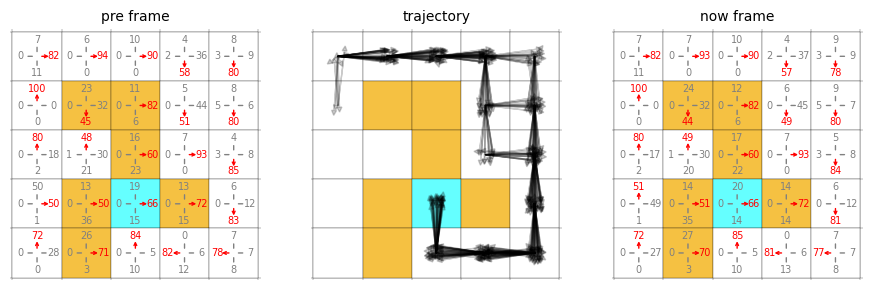

 16%|█████████████▊                                                                        | 3200/20000 [18:25<1:18:35,  3.56it/s]

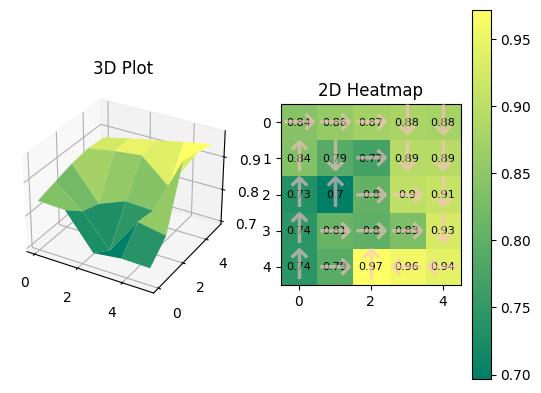

0.8416544	0.8571445	0.8722801	0.8808352	0.87616813	
0.83843005	0.79153216	0.771685	0.89402914	0.8949938	
0.7342898	0.696407	0.80446815	0.9037913	0.9106854	
0.7447758	0.80968845	0.79997814	0.83160114	0.9276885	
0.7429884	0.79409575	0.9718213	0.95734	0.942778	
buffer_size 527
527
527


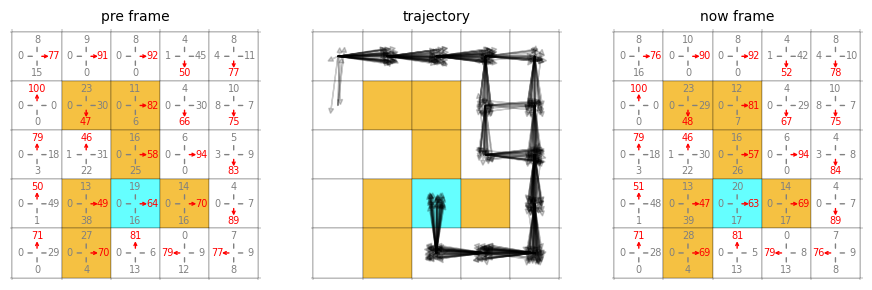

 16%|█████████████▉                                                                        | 3250/20000 [18:42<1:17:13,  3.62it/s]

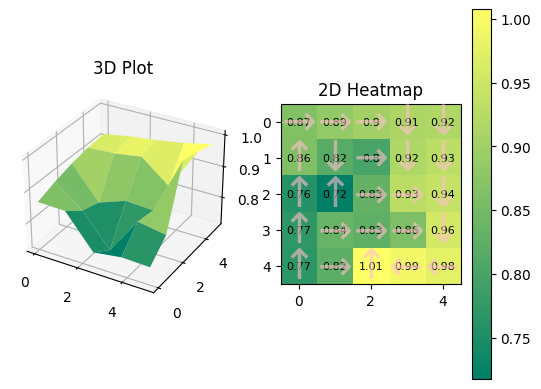

0.86553884	0.8863277	0.9021103	0.9125591	0.9164347	
0.86342365	0.8191665	0.7999964	0.91681194	0.93205434	
0.75867224	0.71782917	0.83150464	0.9300919	0.9428714	
0.7717539	0.8362634	0.82630545	0.86051786	0.95657367	
0.7689609	0.82208323	1.0073569	0.99225205	0.97592497	
buffer_size 516
516
516


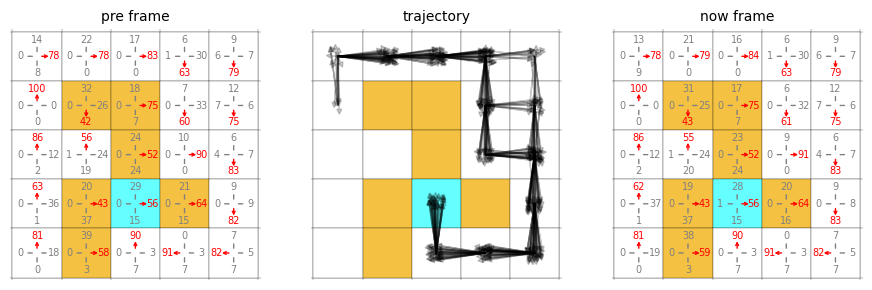

 16%|██████████████▏                                                                       | 3300/20000 [18:59<1:17:56,  3.57it/s]

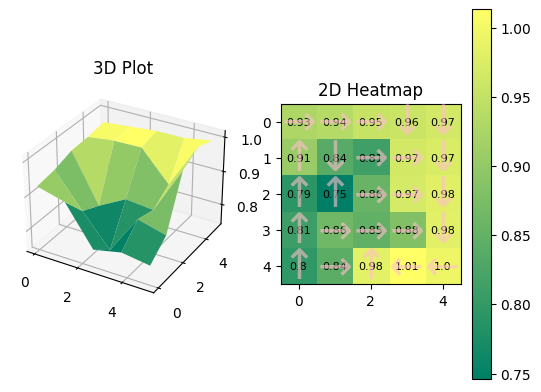

0.92777014	0.9365781	0.9542345	0.9574654	0.9654242	
0.9062011	0.83841646	0.8122655	0.9669189	0.9730291	
0.79207253	0.7459619	0.85568935	0.96864146	0.9805062	
0.8100295	0.862944	0.84779686	0.8824696	0.9810557	
0.7980373	0.8412291	0.98453295	1.0130911	0.99501204	
buffer_size 524
524
524


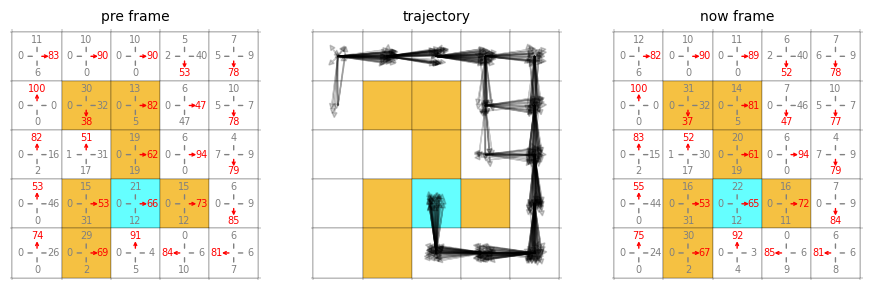

 17%|██████████████▍                                                                       | 3350/20000 [19:16<1:18:00,  3.56it/s]

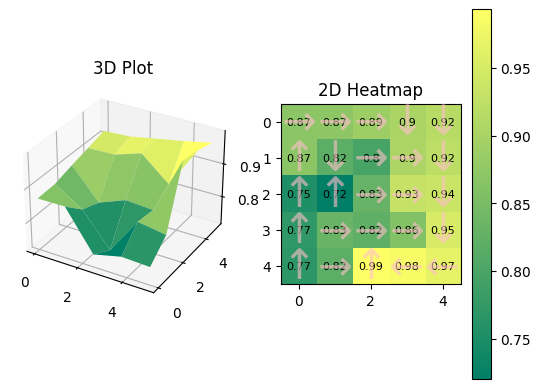

0.87007916	0.87264603	0.88861144	0.902414	0.91714895	
0.8703321	0.8192168	0.7976911	0.90428084	0.92163503	
0.75304854	0.7205758	0.82957846	0.9302479	0.93644994	
0.7729834	0.8319852	0.823783	0.86029536	0.9507167	
0.7692678	0.81855106	0.99299175	0.983503	0.9672771	
buffer_size 522
522
522


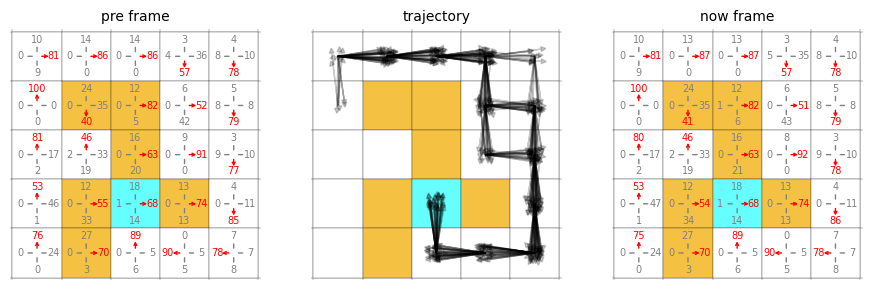

 17%|██████████████▌                                                                       | 3400/20000 [19:33<1:19:00,  3.50it/s]

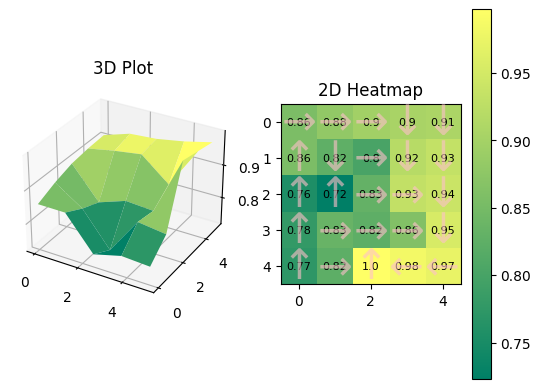

0.85651606	0.88021994	0.8972933	0.9045691	0.9080832	
0.8559631	0.82498646	0.8015111	0.91955614	0.933897	
0.7561045	0.7229667	0.83041257	0.93121	0.9397229	
0.77808046	0.8346618	0.82466304	0.8630353	0.9537393	
0.773031	0.8236082	0.99728614	0.98499405	0.9730233	
buffer_size 527
527
527


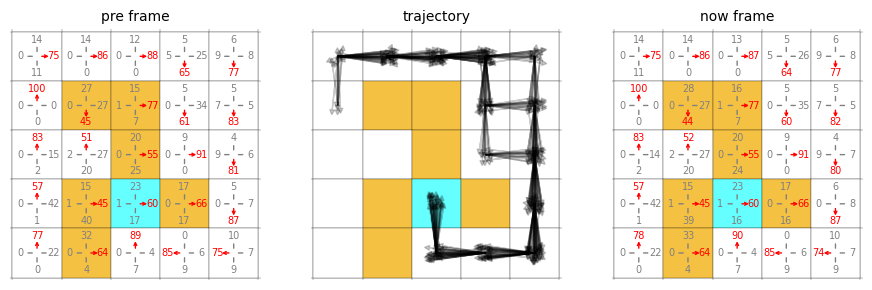

 17%|██████████████▊                                                                       | 3450/20000 [19:50<1:17:41,  3.55it/s]

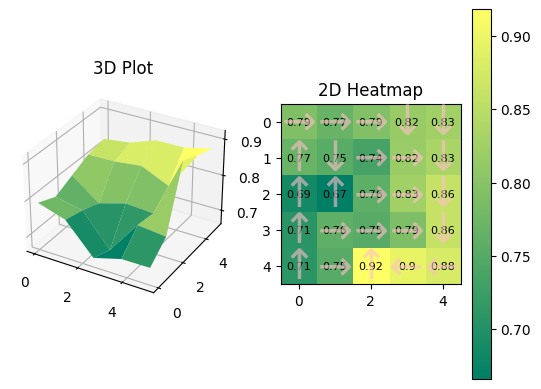

0.79254794	0.7703285	0.7931462	0.8159455	0.82534194	
0.7685102	0.75492734	0.7356179	0.8166467	0.834828	
0.686422	0.6661509	0.7576767	0.8252251	0.8608707	
0.7081995	0.76002467	0.7525815	0.79036045	0.861169	
0.7089408	0.7519987	0.917953	0.8954307	0.8782686	
buffer_size 521
521
521


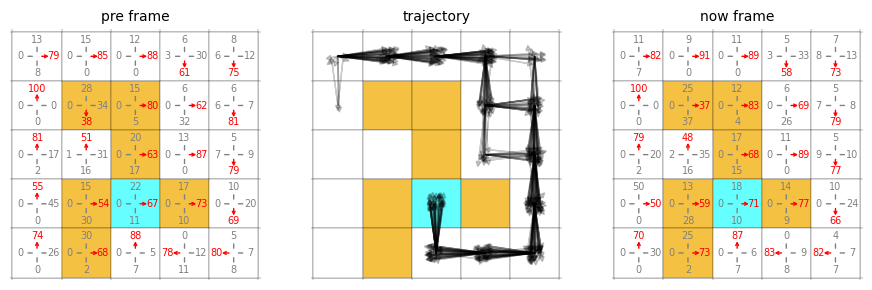

 18%|███████████████                                                                       | 3500/20000 [20:07<1:17:24,  3.55it/s]

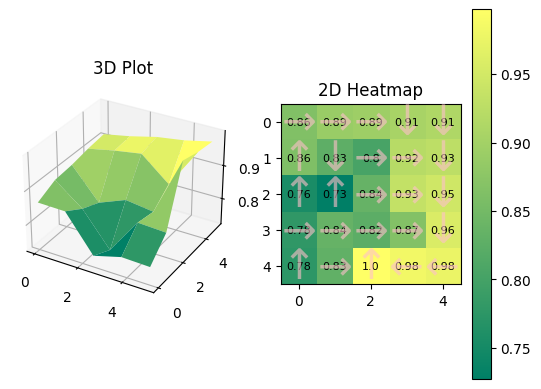

0.8634864	0.889382	0.8948761	0.9055021	0.9124507	
0.86187506	0.82708704	0.8034043	0.9213531	0.92735636	
0.75547296	0.7272452	0.8357924	0.933962	0.9464141	
0.7781328	0.8353311	0.82474256	0.86573935	0.95775545	
0.7755084	0.8309909	0.99733055	0.9829248	0.97547543	
buffer_size 513
513
513


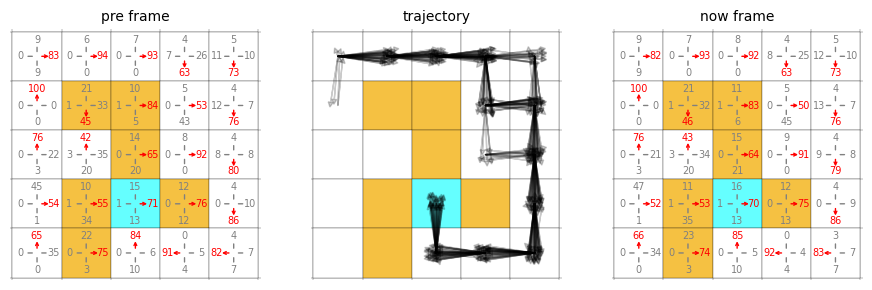

 18%|███████████████▎                                                                      | 3550/20000 [20:24<1:17:16,  3.55it/s]

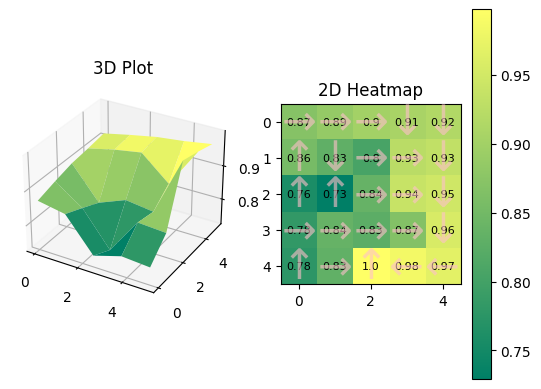

0.8698773	0.8863457	0.90054476	0.9072381	0.91568244	
0.8550549	0.8307949	0.80495	0.925013	0.9321763	
0.75771344	0.7292835	0.8369574	0.9381935	0.94704765	
0.7823458	0.8370636	0.826215	0.8684151	0.95612526	
0.7761448	0.8315051	0.9976688	0.9841968	0.96863925	
buffer_size 521
521
521


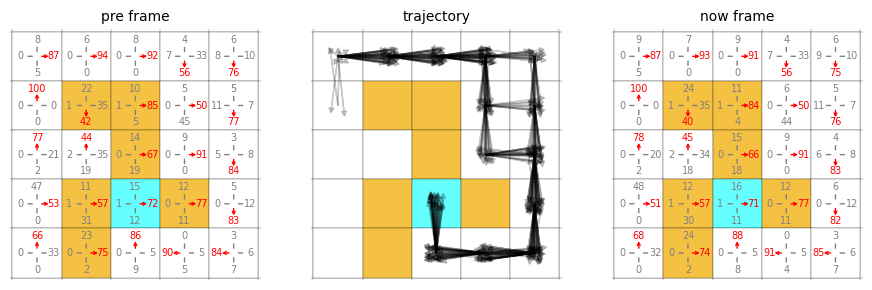

 18%|███████████████▍                                                                      | 3600/20000 [20:41<1:16:06,  3.59it/s]

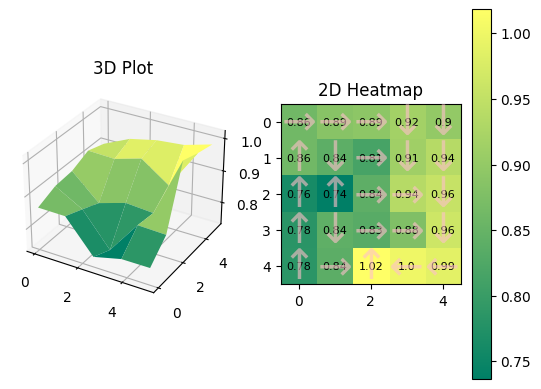

0.8630041	0.88667536	0.89220786	0.91621715	0.89879024	
0.8620495	0.83905685	0.814786	0.9129199	0.93685275	
0.7625216	0.7365444	0.84050614	0.93707347	0.9550233	
0.78348154	0.84137636	0.8341083	0.87759733	0.96266437	
0.78396106	0.83813506	1.0181923	0.99991626	0.98667705	
buffer_size 520
520
520


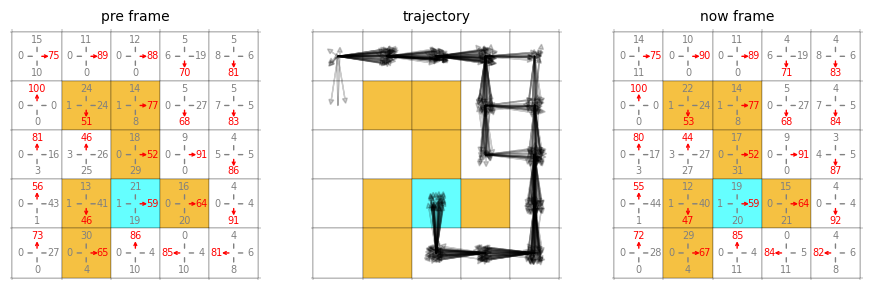

 18%|███████████████▋                                                                      | 3650/20000 [20:58<1:16:41,  3.55it/s]

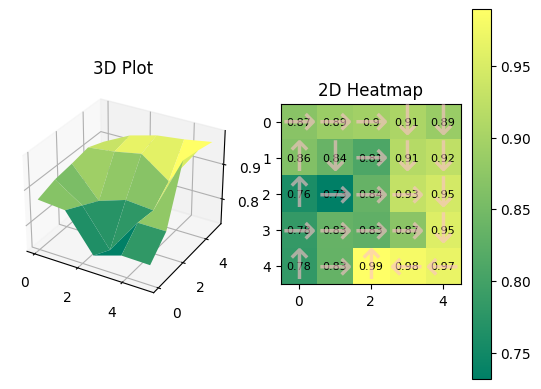

0.87010074	0.8880585	0.895297	0.9053936	0.88644725	
0.8632355	0.8365857	0.8097199	0.91420454	0.92497575	
0.75918657	0.7316302	0.8353748	0.9288525	0.9453939	
0.7845993	0.8346656	0.8286323	0.8725449	0.95442003	
0.78300214	0.8343668	0.9895244	0.9799454	0.9675138	
buffer_size 524
524
524


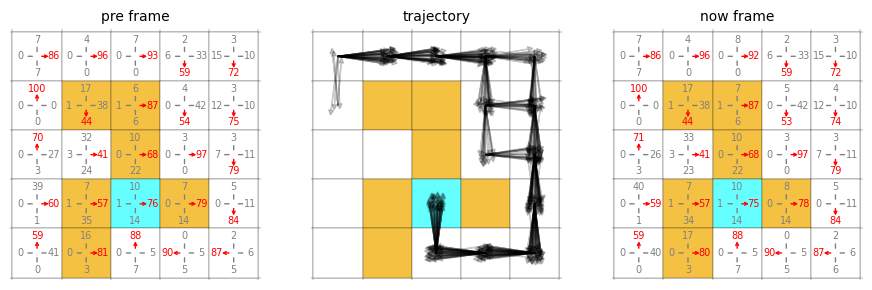

 18%|███████████████▉                                                                      | 3700/20000 [21:16<1:17:23,  3.51it/s]

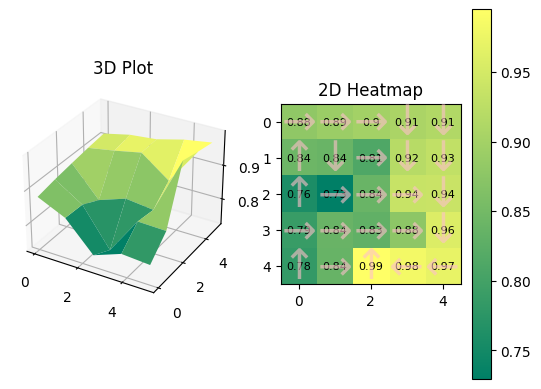

0.879611	0.8905693	0.8991082	0.90702224	0.91334796	
0.84267783	0.839666	0.81222963	0.92008996	0.93046594	
0.75877786	0.7294676	0.84011424	0.9357817	0.9380368	
0.78876364	0.83892775	0.83076525	0.8760245	0.9580101	
0.78283334	0.83629763	0.9948548	0.98165154	0.9705602	
buffer_size 520
520
520


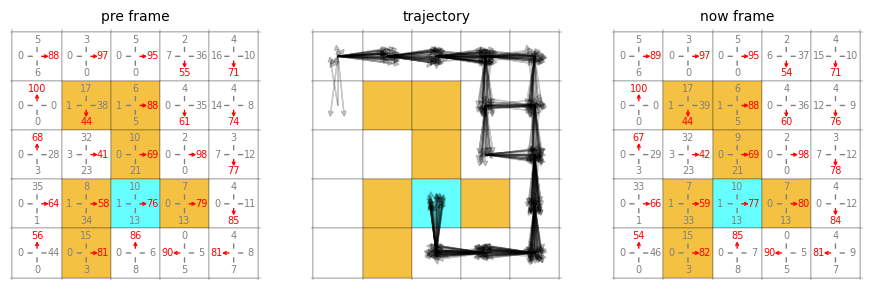

 19%|████████████████▏                                                                     | 3750/20000 [21:33<1:14:59,  3.61it/s]

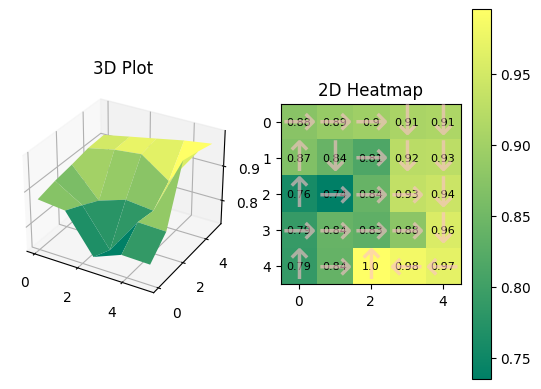

0.87547183	0.88899815	0.89766407	0.90855753	0.9114175	
0.8671119	0.84189296	0.8148097	0.92482686	0.9267447	
0.7591073	0.7353802	0.84049404	0.9330853	0.9416238	
0.79066765	0.8407016	0.8321276	0.87777627	0.9568038	
0.78868115	0.8382312	0.9952754	0.98267317	0.96822166	
buffer_size 516
516
516


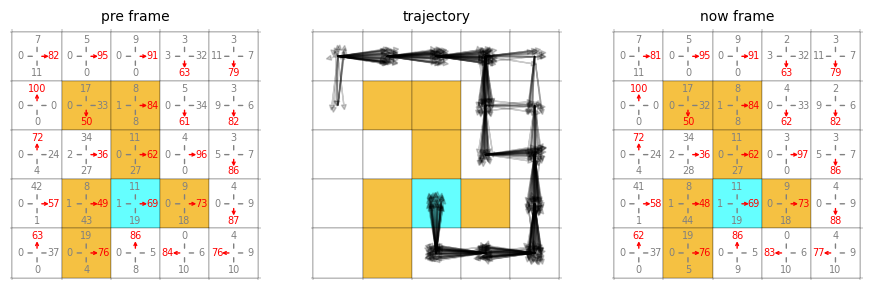

 19%|████████████████▎                                                                     | 3800/20000 [21:50<1:15:47,  3.56it/s]

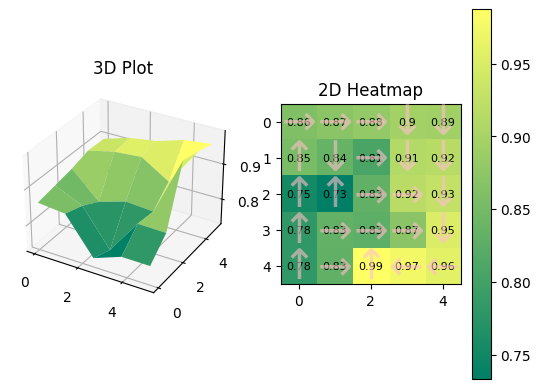

0.86095405	0.870694	0.8804574	0.895585	0.8940453	
0.8534761	0.8356828	0.80761755	0.9124957	0.9167764	
0.7532276	0.73329943	0.8310163	0.91881794	0.92794114	
0.7819034	0.8319473	0.8256705	0.8707933	0.9510465	
0.781608	0.83027166	0.9873547	0.97476655	0.96006024	
buffer_size 528
528
528


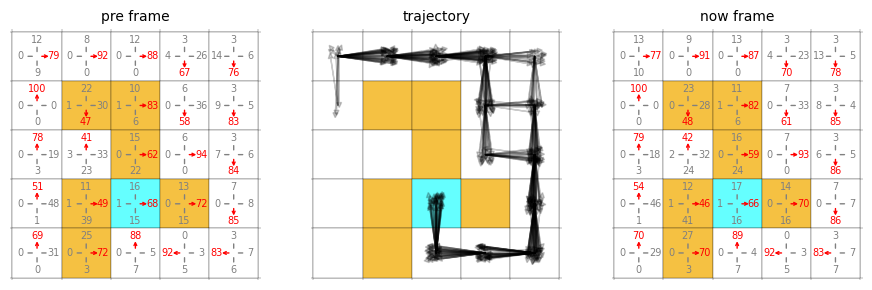

 19%|████████████████▌                                                                     | 3850/20000 [22:07<1:14:19,  3.62it/s]

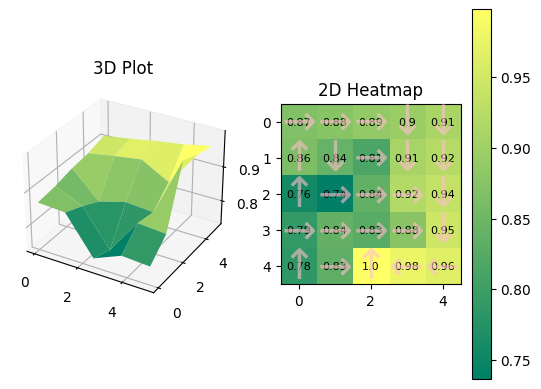

0.86850506	0.87554646	0.88874483	0.895668	0.9111325	
0.8636771	0.8408717	0.8138573	0.908736	0.9231488	
0.7564741	0.73663944	0.8357038	0.9205237	0.936936	
0.7897228	0.8396719	0.829443	0.8767609	0.9479323	
0.7848612	0.83344895	0.9979843	0.9776178	0.9643842	
buffer_size 516
516
516


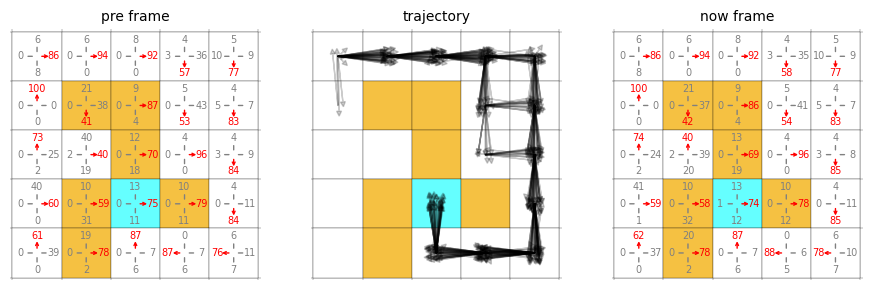

 20%|████████████████▊                                                                     | 3900/20000 [22:24<1:14:21,  3.61it/s]

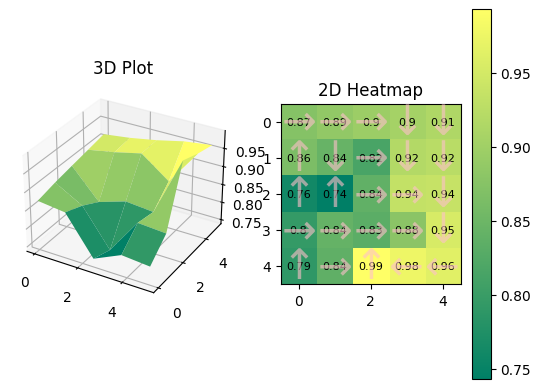

0.8738872	0.8862283	0.89576054	0.90495336	0.91439486	
0.864903	0.8442465	0.81580496	0.91830015	0.9237311	
0.7612504	0.7433667	0.8396081	0.9351702	0.9369155	
0.79590344	0.8426031	0.8327725	0.8794967	0.9534695	
0.789219	0.8371308	0.9929038	0.97554445	0.96317625	
buffer_size 517
517
517


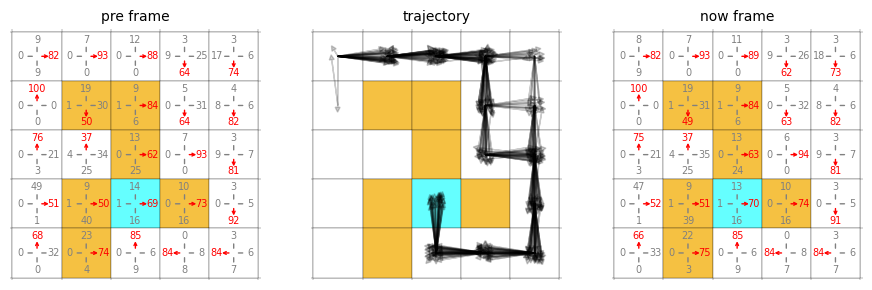

 20%|████████████████▉                                                                     | 3950/20000 [22:41<1:14:38,  3.58it/s]

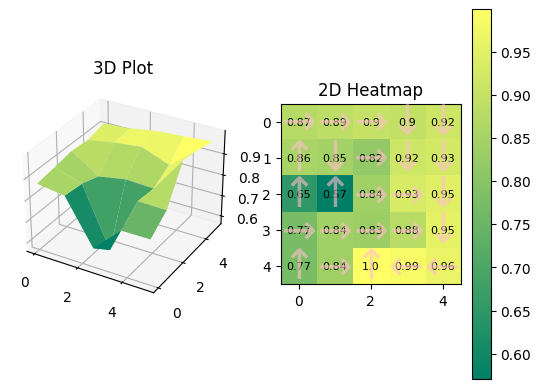

0.8739308	0.88781726	0.9022179	0.89577174	0.91628796	
0.85684353	0.84716606	0.8179823	0.91695833	0.9256961	
0.6512239	0.5705316	0.8404944	0.93117964	0.9467697	
0.774421	0.8416843	0.83454233	0.8817669	0.95495486	
0.7749493	0.83898574	0.9994252	0.985405	0.9649663	
buffer_size 522
522
522


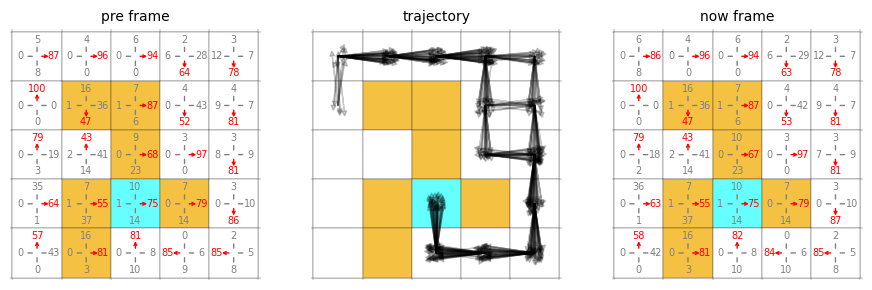

 20%|█████████████████▏                                                                    | 4000/20000 [22:58<1:15:00,  3.56it/s]

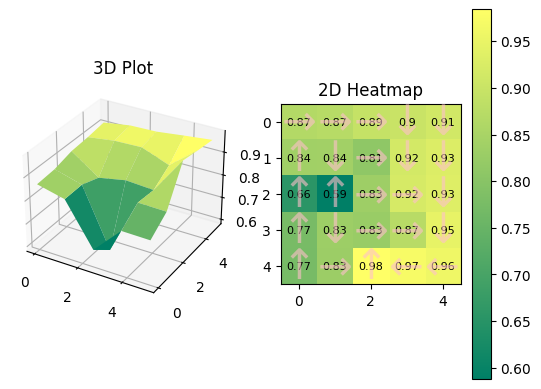

0.86617005	0.87258047	0.8939125	0.90039825	0.9115681	
0.8373938	0.8392364	0.8106327	0.9158003	0.92940205	
0.65550226	0.58786273	0.8333405	0.9192142	0.9325515	
0.7749829	0.8323554	0.8253985	0.87403536	0.94640213	
0.7728723	0.82949954	0.9841286	0.97038203	0.95918256	
buffer_size 522
522
522


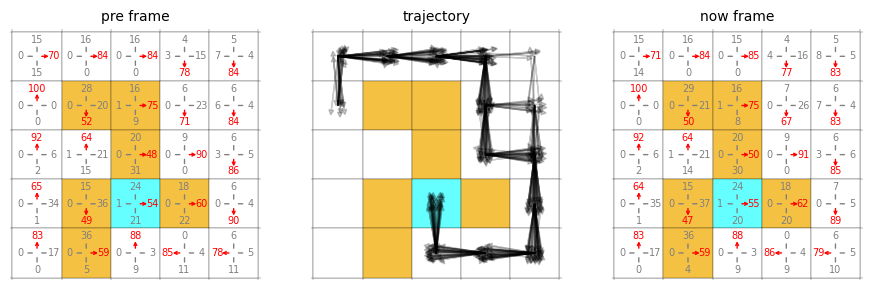

 20%|█████████████████▍                                                                    | 4050/20000 [23:15<1:14:49,  3.55it/s]

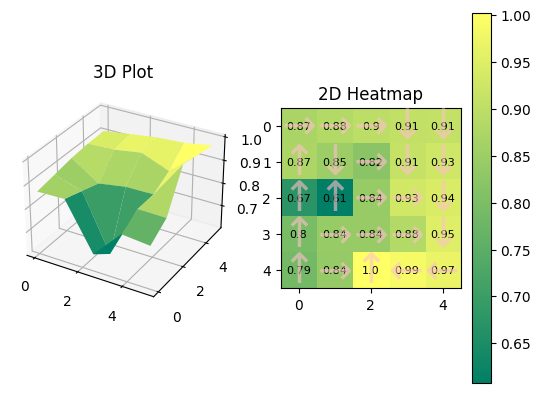

0.87056905	0.88485634	0.8992998	0.90755934	0.90973973	
0.8734536	0.8481283	0.8216506	0.91222215	0.92688143	
0.6732668	0.6077381	0.8410135	0.9307444	0.9431984	
0.79683626	0.84063274	0.84255755	0.884139	0.9504978	
0.7853127	0.8385806	1.0016458	0.9862695	0.9704094	
buffer_size 528
528
528


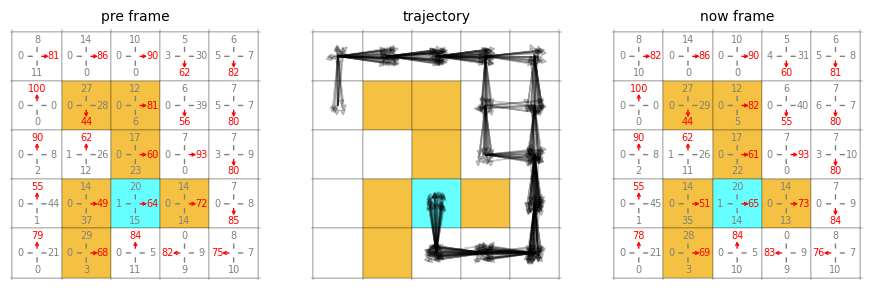

 20%|█████████████████▋                                                                    | 4100/20000 [23:32<1:15:50,  3.49it/s]

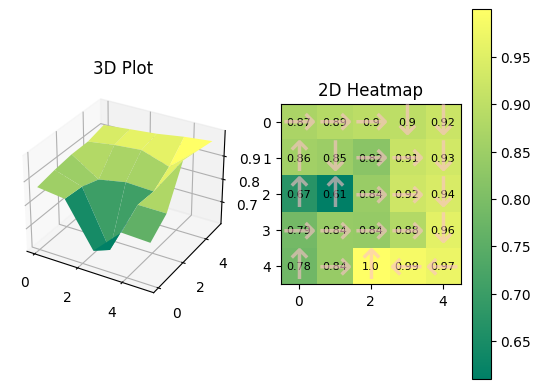

0.8717723	0.8871044	0.8974285	0.89845026	0.91768944	
0.8569423	0.84912014	0.82150435	0.91469705	0.92953277	
0.672766	0.61005783	0.84350944	0.9244355	0.94032156	
0.78716743	0.8414954	0.8378196	0.88492894	0.9578111	
0.7817017	0.84037495	0.99990356	0.9857117	0.9703237	
buffer_size 515
515
515


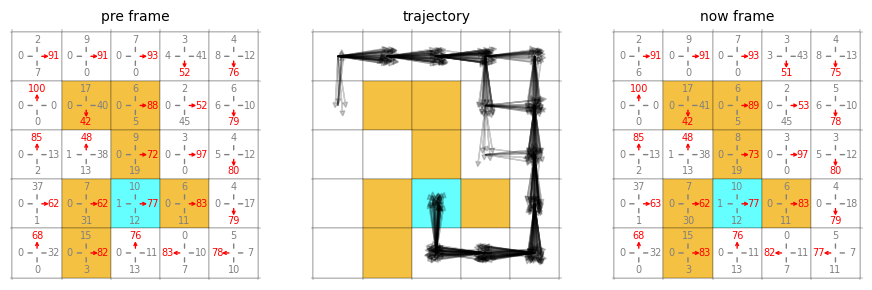

 21%|█████████████████▊                                                                    | 4150/20000 [23:49<1:12:40,  3.64it/s]

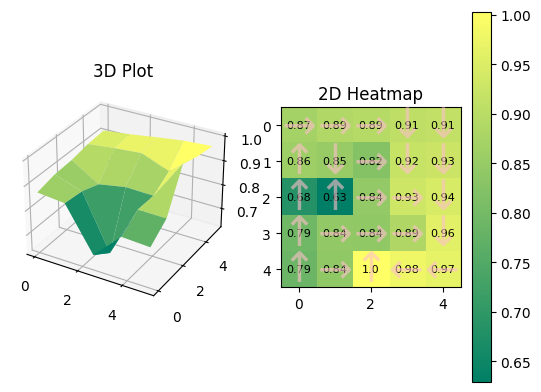

0.87023354	0.8880908	0.8930195	0.90718246	0.9129618	
0.8599564	0.85137624	0.8242122	0.91979605	0.92626506	
0.68363357	0.62916636	0.84449494	0.92949367	0.9430372	
0.793695	0.84317535	0.84159386	0.88609535	0.95802855	
0.78752583	0.84163105	1.0021527	0.977739	0.965751	
buffer_size 523
523
523


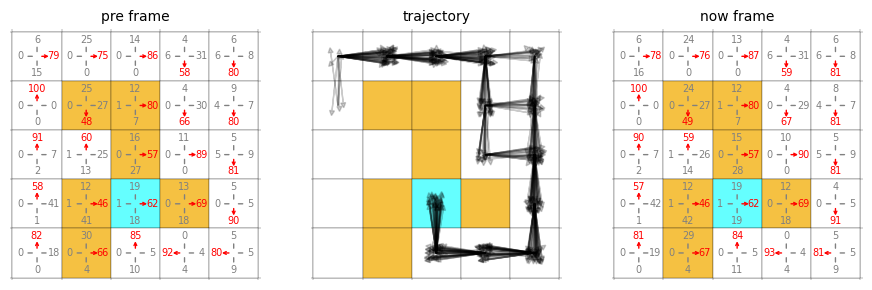

 21%|██████████████████                                                                    | 4200/20000 [24:06<1:14:23,  3.54it/s]

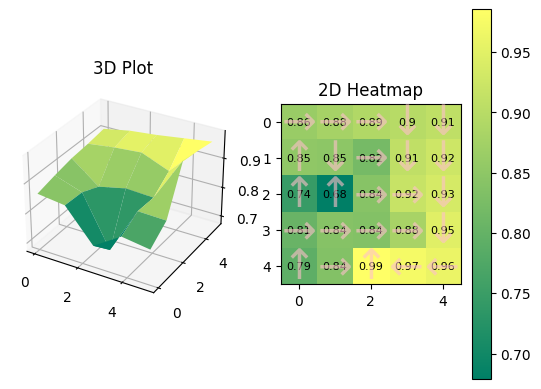

0.86290634	0.87859106	0.89178383	0.898118	0.90764797	
0.85169315	0.84795463	0.8208581	0.9099333	0.9249878	
0.74485415	0.6789223	0.8414576	0.91764736	0.9344739	
0.80517757	0.8395958	0.8373395	0.8807255	0.94740474	
0.79165554	0.8366734	0.9854673	0.97325075	0.96044874	
buffer_size 520
520
520


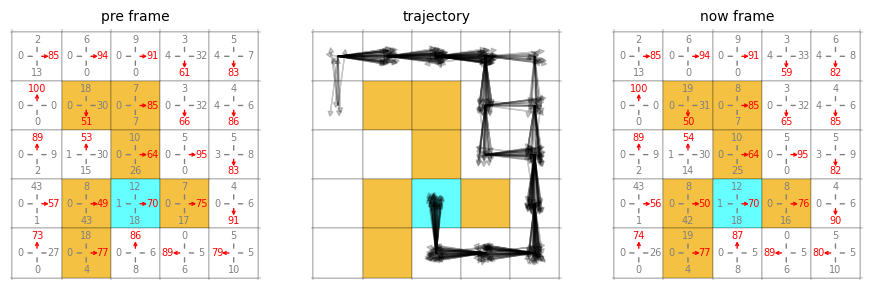

 21%|██████████████████▎                                                                   | 4250/20000 [24:24<1:17:24,  3.39it/s]

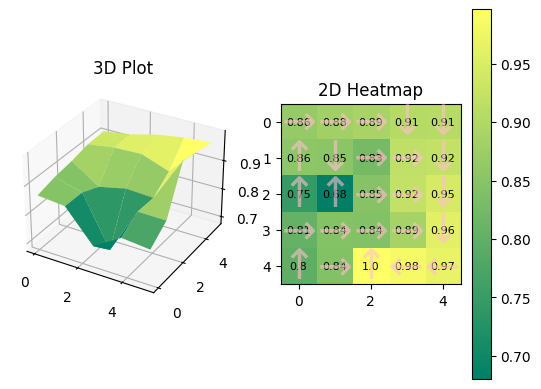

0.86450064	0.88109404	0.89036465	0.9051166	0.9076168	
0.85575795	0.854101	0.8262863	0.9181891	0.9216093	
0.7467829	0.6801553	0.84729946	0.92166775	0.9451962	
0.80627644	0.84479517	0.84284467	0.88731045	0.9599991	
0.79656017	0.8433194	0.9967711	0.98362947	0.9674781	
buffer_size 516
516
516


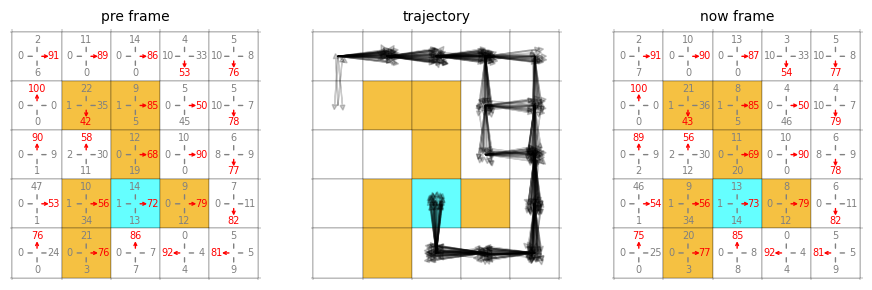

 22%|██████████████████▍                                                                   | 4300/20000 [24:41<1:16:27,  3.42it/s]

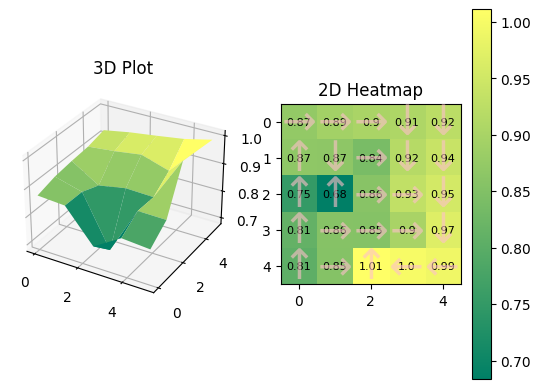

0.8739785	0.8925369	0.90132594	0.9073442	0.9231149	
0.8674334	0.8659239	0.83971226	0.9171306	0.9406215	
0.752126	0.6838723	0.8579842	0.9309548	0.953753	
0.81294453	0.85640955	0.8546407	0.90014446	0.9680724	
0.8050177	0.85456955	1.0111371	1.0005566	0.9911407	
buffer_size 522
522
522


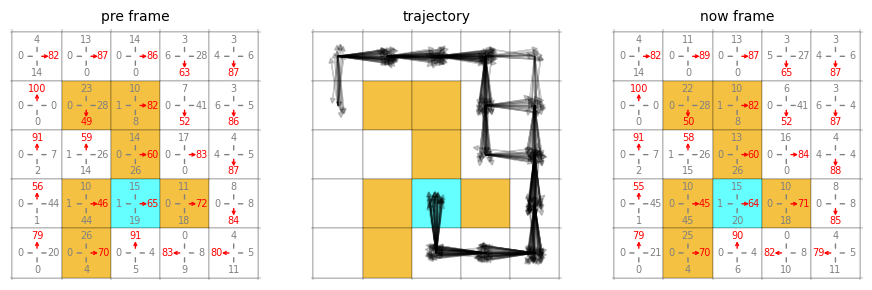

 22%|██████████████████▋                                                                   | 4350/20000 [24:59<1:16:31,  3.41it/s]

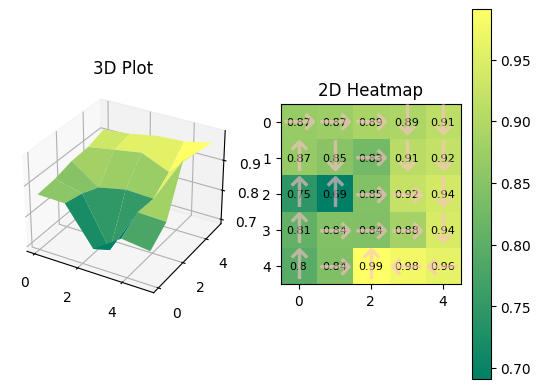

0.86869013	0.87464255	0.89026237	0.894423	0.9125371	
0.8663753	0.8526242	0.82716674	0.90923464	0.9211079	
0.7451543	0.69122297	0.84633183	0.9239063	0.9382234	
0.80786693	0.8446564	0.84224224	0.88499784	0.9430923	
0.79612136	0.8410848	0.9906753	0.9770654	0.9621967	
buffer_size 515
515
515


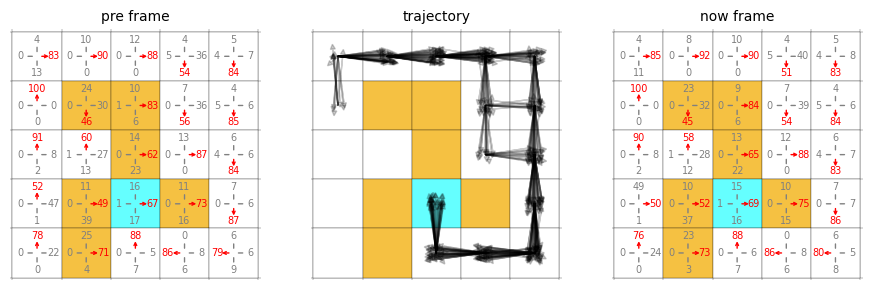

 22%|██████████████████▉                                                                   | 4400/20000 [25:17<1:11:16,  3.65it/s]

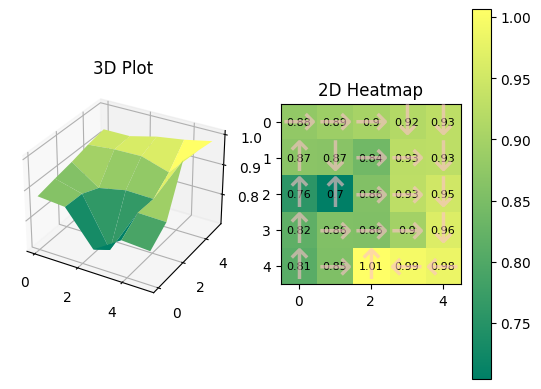

0.8771765	0.89027584	0.90180796	0.9172281	0.9280781	
0.86916465	0.86594474	0.8396236	0.9255552	0.92838264	
0.75672364	0.7038791	0.8581773	0.9274392	0.95060706	
0.8164085	0.8574053	0.8556849	0.89858335	0.96421474	
0.80999136	0.8547635	1.0065119	0.99452454	0.98342997	
buffer_size 524
524
524


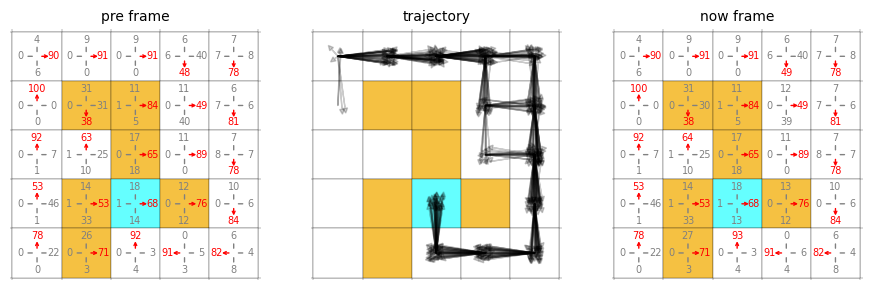

 22%|███████████████████▏                                                                  | 4450/20000 [25:34<1:16:34,  3.38it/s]

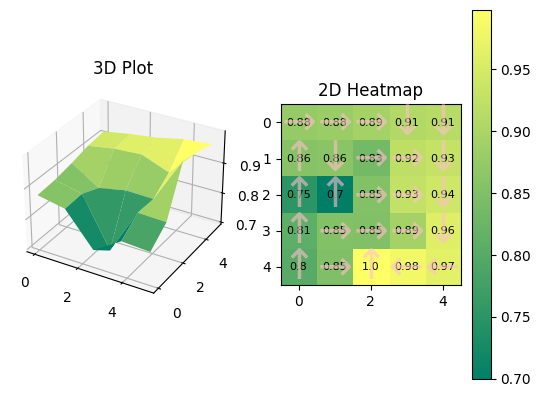

0.8753146	0.8804151	0.8923571	0.90763474	0.91476214	
0.85776067	0.86068606	0.8346652	0.92155933	0.9296719	
0.7508714	0.69927907	0.8526064	0.92703605	0.94099724	
0.8084864	0.85240865	0.8504232	0.89240193	0.95948386	
0.80282927	0.8493882	0.99816763	0.984782	0.9665735	
buffer_size 516
516
516


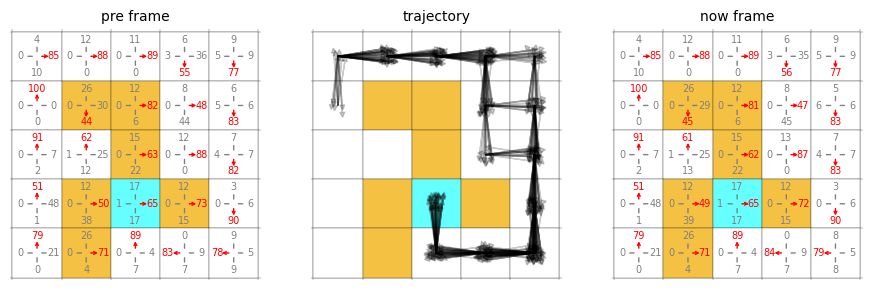

 22%|███████████████████▎                                                                  | 4500/20000 [25:51<1:12:14,  3.58it/s]

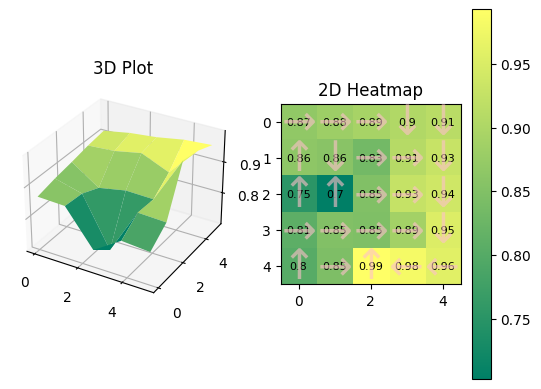

0.8674805	0.8816179	0.89196134	0.9042609	0.91280115	
0.86396694	0.85848355	0.83302593	0.90996623	0.928247	
0.75147223	0.70252204	0.8496562	0.92671454	0.93725824	
0.80878973	0.85019654	0.8471818	0.8892572	0.95212877	
0.80153084	0.846151	0.9927697	0.9811319	0.9583516	
buffer_size 522
522
522


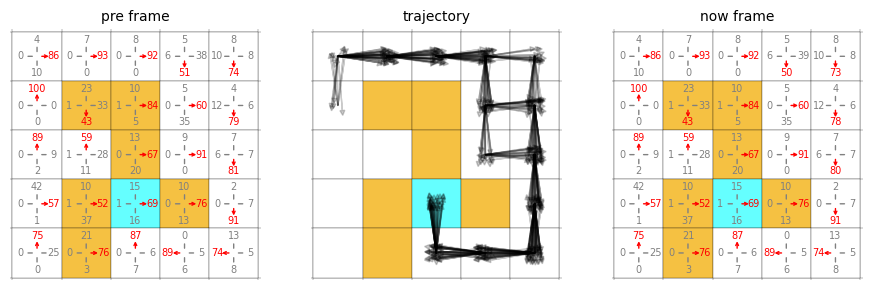

 23%|███████████████████▌                                                                  | 4550/20000 [26:08<1:12:45,  3.54it/s]

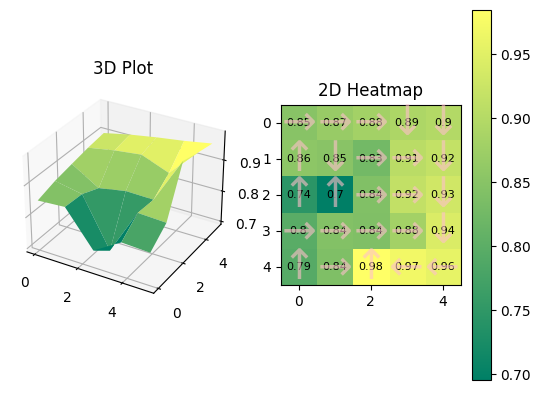

0.84966457	0.86798406	0.8797848	0.89127696	0.8994129	
0.85527295	0.8511573	0.82656276	0.905898	0.91681147	
0.7448657	0.6960609	0.84236103	0.9156109	0.9306165	
0.7983467	0.8436947	0.8403093	0.8814751	0.94227636	
0.79404354	0.8394505	0.98450255	0.9690105	0.9567555	
buffer_size 517
517
517


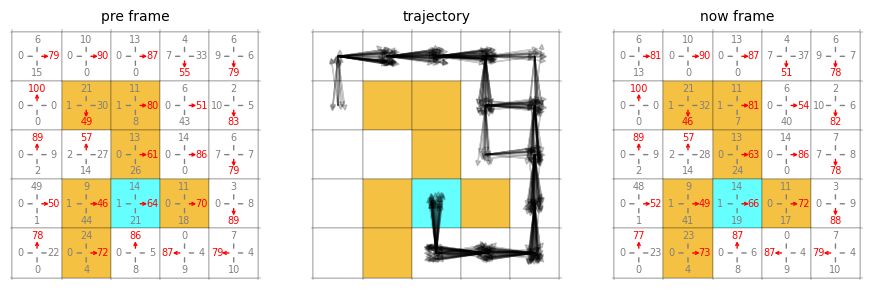

 23%|███████████████████▊                                                                  | 4600/20000 [26:26<1:15:24,  3.40it/s]

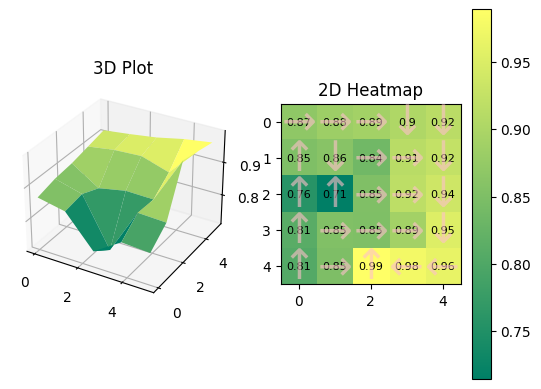

0.8682028	0.8830408	0.8898471	0.90236187	0.91500044	
0.85120887	0.8607652	0.83682734	0.91379994	0.9245321	
0.7569668	0.7145939	0.8529134	0.91768074	0.93574685	
0.8105104	0.8537915	0.85079706	0.89116246	0.9526221	
0.80528164	0.8498609	0.9890911	0.9766554	0.9641926	
buffer_size 521
521
521


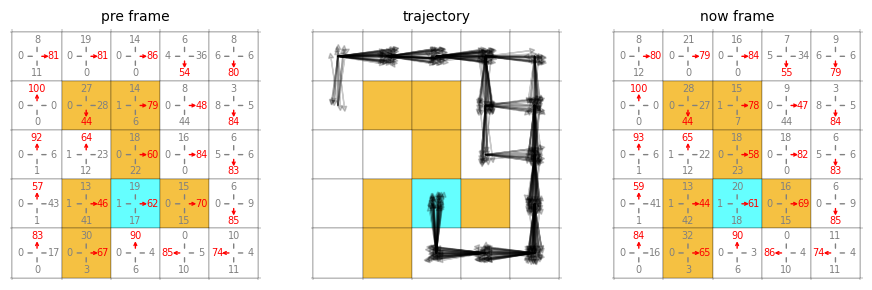

 23%|███████████████████▉                                                                  | 4650/20000 [26:43<1:11:34,  3.57it/s]

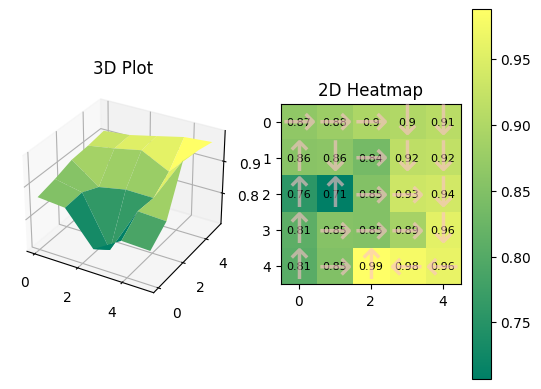

0.86511636	0.8787727	0.8972084	0.90185094	0.91030926	
0.85771936	0.861645	0.8358196	0.91569984	0.91891074	
0.7570566	0.7068418	0.85214865	0.93270105	0.9376361	
0.8095892	0.8540069	0.8508751	0.8899848	0.956764	
0.8061842	0.8494643	0.9879234	0.97746104	0.96366864	
buffer_size 513
513
513


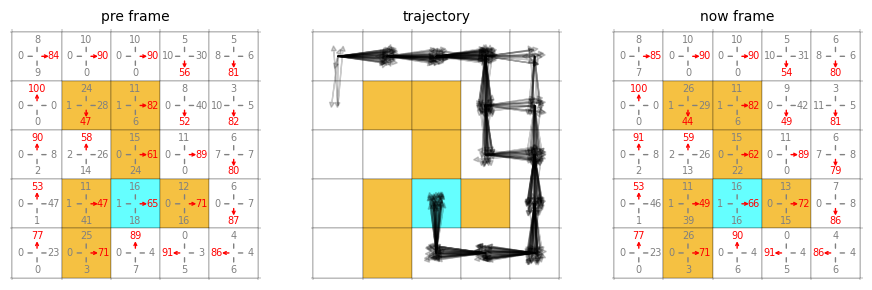

 24%|████████████████████▏                                                                 | 4700/20000 [27:00<1:11:22,  3.57it/s]

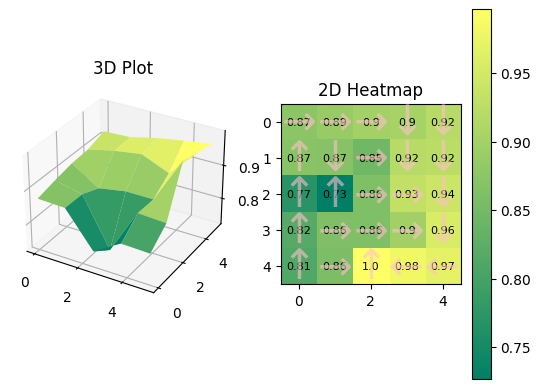

0.8742584	0.8877629	0.8987	0.9027803	0.9205626	
0.87099445	0.8697579	0.84676814	0.9200169	0.9239253	
0.767856	0.7266519	0.8610154	0.93198717	0.94253576	
0.8179419	0.8625444	0.860676	0.89787567	0.95575964	
0.81390417	0.85824215	0.99644315	0.98093164	0.96818364	
buffer_size 518
518
518


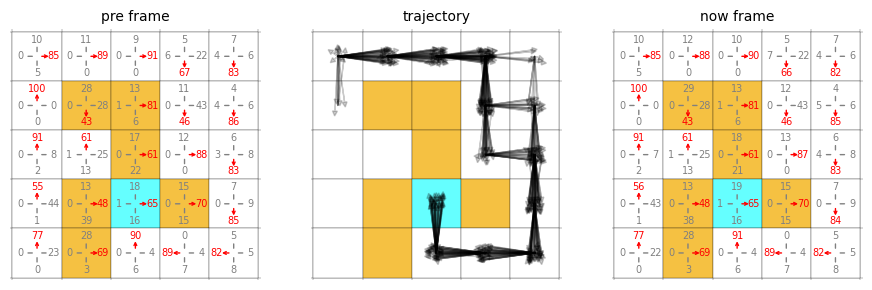

 24%|████████████████████▍                                                                 | 4750/20000 [27:17<1:10:48,  3.59it/s]

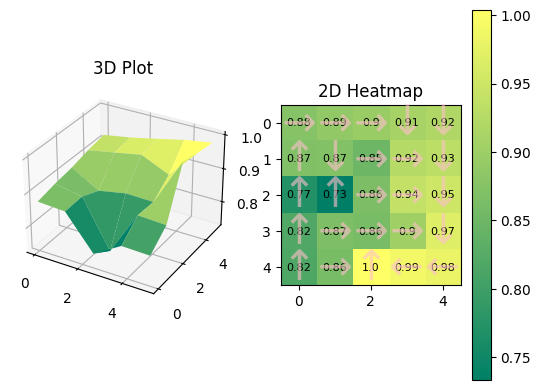

0.8754122	0.8877366	0.89631706	0.91027385	0.9196015	
0.87057424	0.87286556	0.8492341	0.9247519	0.93286705	
0.77107954	0.7334338	0.8648325	0.9399578	0.95014817	
0.82006514	0.86615145	0.86307764	0.90303886	0.9682701	
0.8178316	0.8621651	1.0035399	0.9900952	0.98109263	
buffer_size 515
515
515


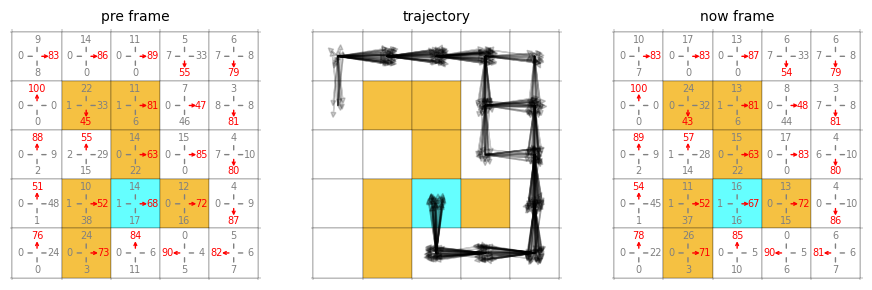

 24%|████████████████████▋                                                                 | 4800/20000 [27:34<1:12:13,  3.51it/s]

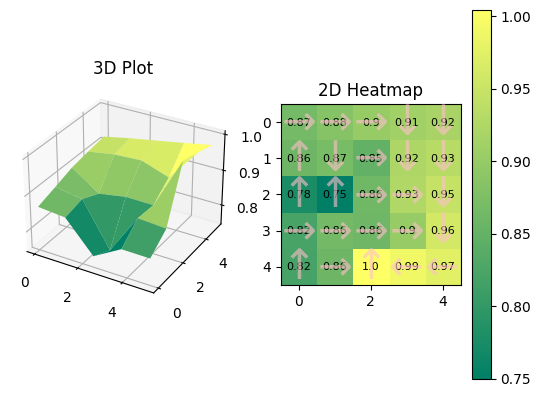

0.8668036	0.8832817	0.9006214	0.9101938	0.91787326	
0.8599496	0.87183946	0.84814745	0.92249966	0.9333974	
0.7755408	0.7494968	0.86151206	0.92643774	0.94656074	
0.820198	0.86406755	0.86068046	0.8999344	0.9604926	
0.81941575	0.85939723	1.0044142	0.9903712	0.9747294	
buffer_size 520
520
520


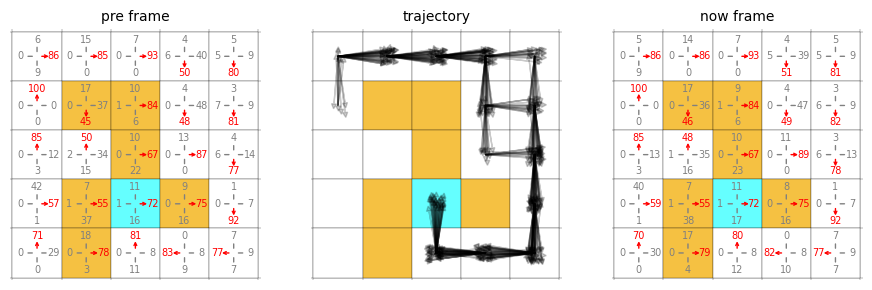

 24%|████████████████████▊                                                                 | 4850/20000 [27:52<1:09:16,  3.64it/s]

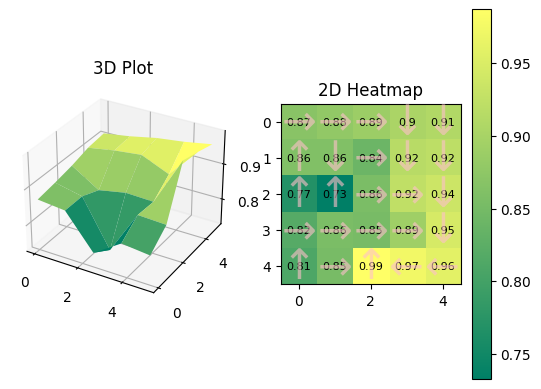

0.8694378	0.87799954	0.8884181	0.9032895	0.90941924	
0.86171424	0.861727	0.84052575	0.91598463	0.92110115	
0.7676039	0.7327256	0.8552853	0.9242911	0.9362529	
0.81841826	0.85571563	0.8525423	0.89120007	0.94577616	
0.8101339	0.85204524	0.98711795	0.9738442	0.9590991	
buffer_size 524
524
524


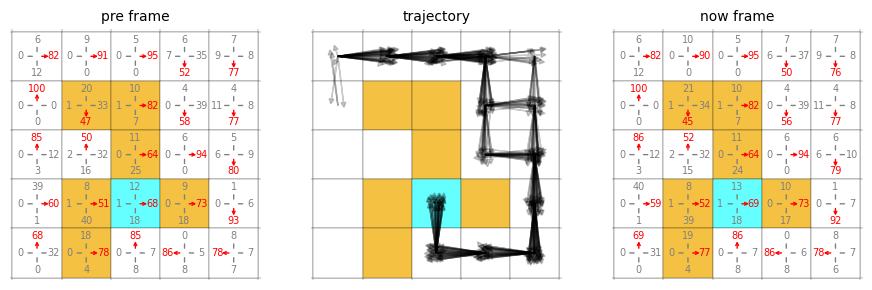

 24%|█████████████████████                                                                 | 4900/20000 [28:09<1:10:12,  3.58it/s]

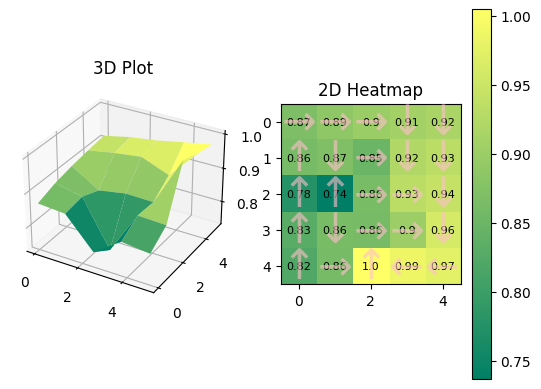

0.8692094	0.8880445	0.8997654	0.9083922	0.91534865	
0.8631427	0.87144613	0.84947944	0.92216194	0.932603	
0.77566546	0.7367229	0.86349297	0.93235815	0.94362223	
0.8317834	0.8646022	0.8617244	0.90073454	0.9595039	
0.8230245	0.86137366	1.0044371	0.9866271	0.9741781	
buffer_size 515
515
515


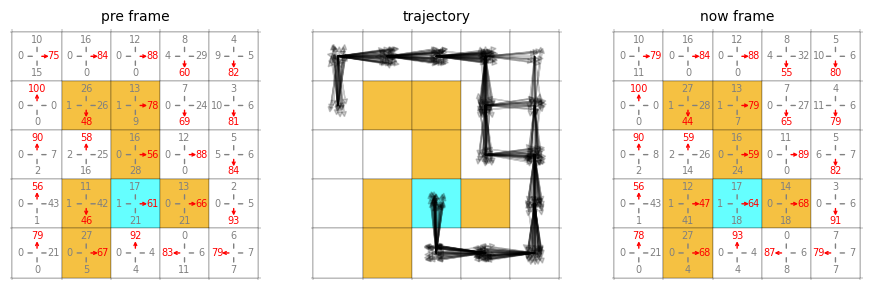

 25%|█████████████████████▎                                                                | 4950/20000 [28:26<1:10:35,  3.55it/s]

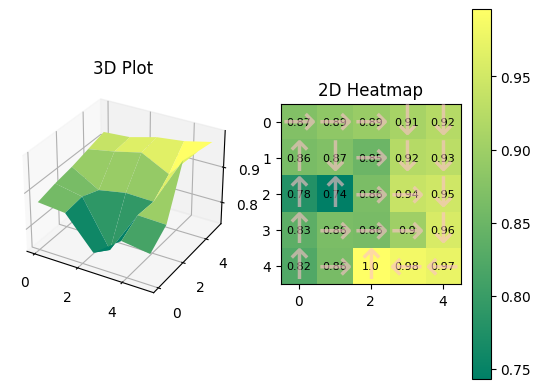

0.87151873	0.885152	0.89461654	0.9085579	0.92267805	
0.86442304	0.87055063	0.8503188	0.9221867	0.9278158	
0.7776965	0.7428358	0.8645787	0.9399246	0.94763637	
0.8348494	0.8645443	0.86232543	0.9007835	0.9566129	
0.8238629	0.86172026	0.9959506	0.9842589	0.97434336	
buffer_size 519
519
519


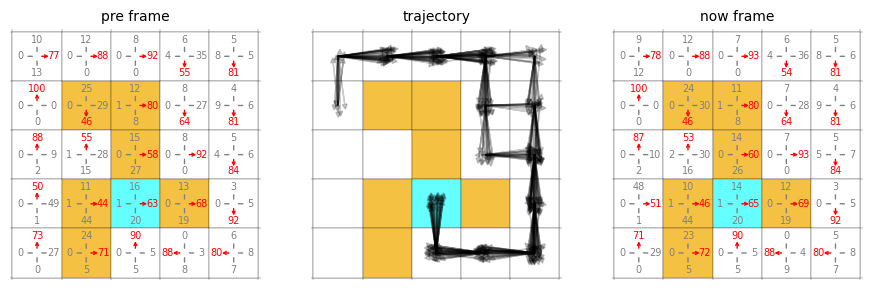

 25%|█████████████████████▌                                                                | 5000/20000 [28:43<1:10:20,  3.55it/s]

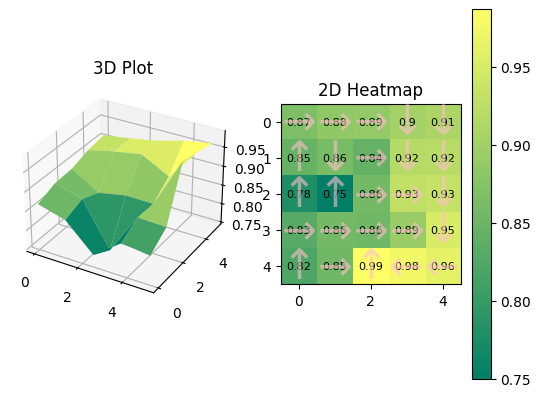

0.8657053	0.88433284	0.8872641	0.90292686	0.9099875	
0.84550434	0.8635118	0.8435003	0.9182662	0.9204743	
0.7767866	0.74962324	0.85728043	0.9300956	0.9325968	
0.830493	0.858053	0.8561779	0.8921984	0.9516704	
0.8214445	0.85494286	0.9871233	0.97501373	0.9638446	
buffer_size 514
514
514


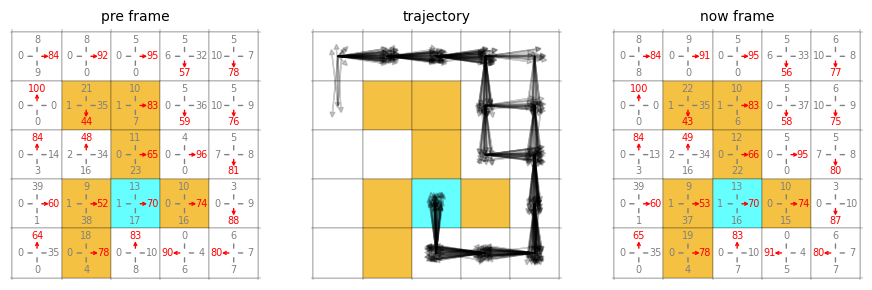

 25%|█████████████████████▋                                                                | 5050/20000 [29:00<1:09:51,  3.57it/s]

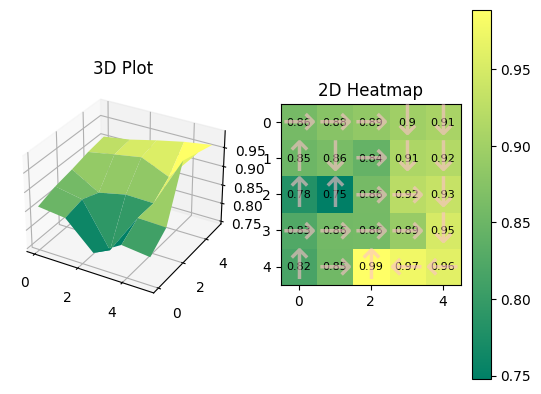

0.85927105	0.87584275	0.88589597	0.8985431	0.907007	
0.8508654	0.862545	0.8436513	0.9113022	0.91792035	
0.78094006	0.7475693	0.8596022	0.9235798	0.93496895	
0.8256712	0.8569099	0.858001	0.89125264	0.95009124	
0.81715477	0.8541883	0.9888942	0.9749973	0.96118045	
buffer_size 529
529
529


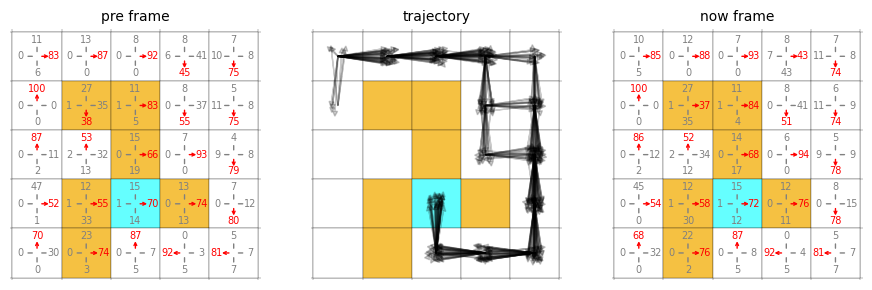

 26%|█████████████████████▉                                                                | 5100/20000 [29:17<1:08:53,  3.60it/s]

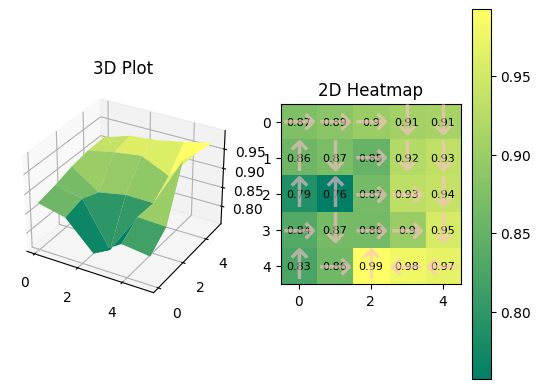

0.8745892	0.8852552	0.8993404	0.9080142	0.9097637	
0.85853195	0.8707483	0.85139763	0.92185163	0.9325267	
0.7881019	0.75771224	0.8651842	0.93186283	0.939464	
0.8353551	0.86576617	0.8645519	0.898828	0.95397985	
0.82629305	0.86236316	0.9919758	0.97911286	0.96947074	
buffer_size 526
526
526


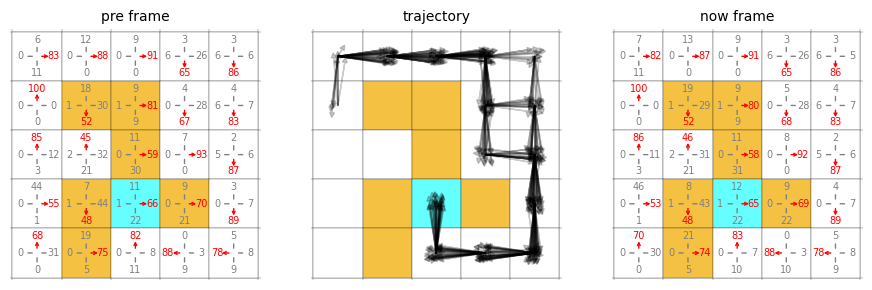

 26%|██████████████████████▏                                                               | 5150/20000 [29:34<1:09:58,  3.54it/s]

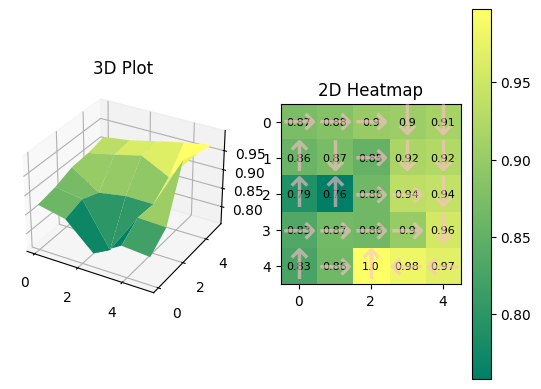

0.8729019	0.88282454	0.90026385	0.90423656	0.9143448	
0.85710096	0.87186325	0.85250944	0.9190606	0.9244234	
0.7892484	0.75798285	0.864715	0.9363087	0.9405981	
0.83282655	0.86653876	0.86439043	0.8992942	0.956432	
0.8266871	0.86339504	0.9971599	0.9817213	0.96897006	
buffer_size 519
519
519


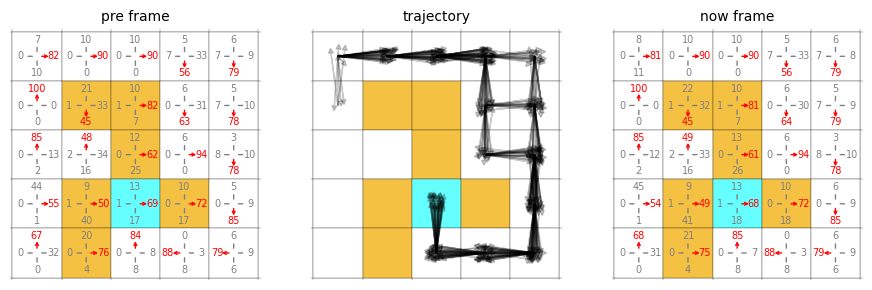

 26%|██████████████████████▎                                                               | 5200/20000 [29:51<1:09:21,  3.56it/s]

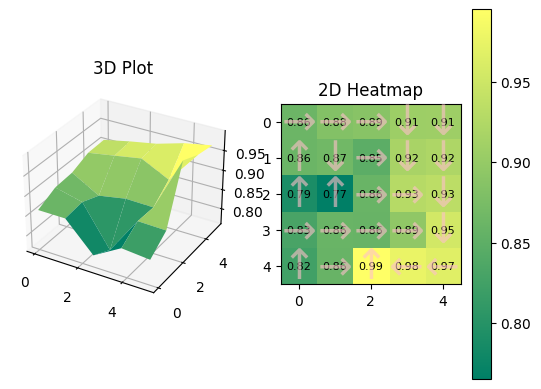

0.86216253	0.8841649	0.8878168	0.9061928	0.90781355	
0.8618969	0.8671701	0.8482667	0.91741955	0.9220922	
0.7902478	0.76516795	0.86073405	0.92910206	0.93428934	
0.83080757	0.86081755	0.85917664	0.8944315	0.9540652	
0.8244518	0.85887444	0.9949312	0.97563744	0.9670392	
buffer_size 515
515
515


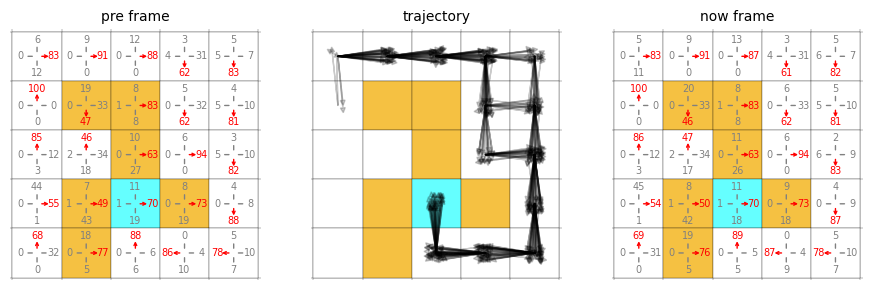

 26%|██████████████████████▌                                                               | 5250/20000 [30:08<1:09:08,  3.56it/s]

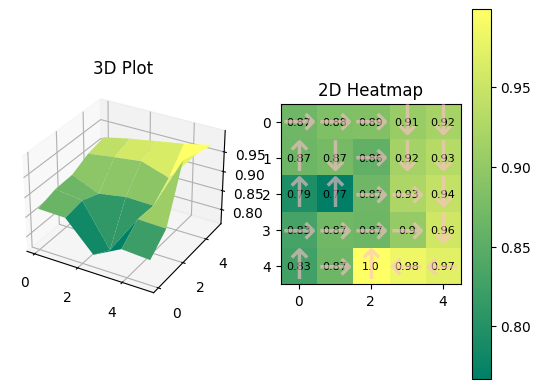

0.8682563	0.88264	0.8852689	0.9072267	0.91793346	
0.8661184	0.87389183	0.85602534	0.9165573	0.93243515	
0.7936351	0.7669991	0.86806726	0.92539454	0.9444752	
0.83084786	0.86842054	0.8662814	0.9019357	0.95607793	
0.8260382	0.86629844	0.9987924	0.98426855	0.9717823	
buffer_size 532
532
532


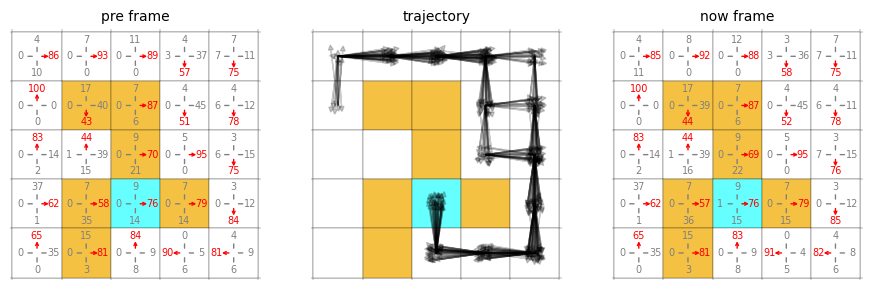

 26%|██████████████████████▊                                                               | 5300/20000 [30:25<1:09:16,  3.54it/s]

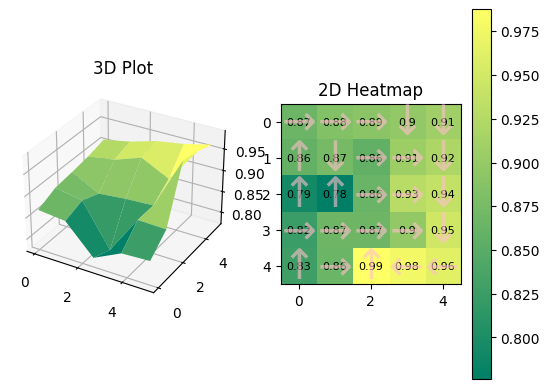

0.8657949	0.8847786	0.8904048	0.8974534	0.9082303	
0.85922456	0.87378395	0.85759497	0.90643847	0.9200222	
0.7934288	0.77624726	0.86382717	0.92906445	0.93820345	
0.82470876	0.8671852	0.8672858	0.89712685	0.9481661	
0.8279668	0.86494875	0.9875697	0.97819436	0.96338993	
buffer_size 516
516
516


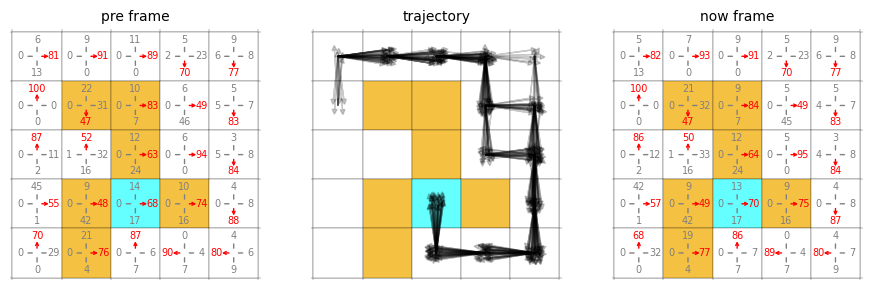

 27%|███████████████████████                                                               | 5350/20000 [30:42<1:08:25,  3.57it/s]

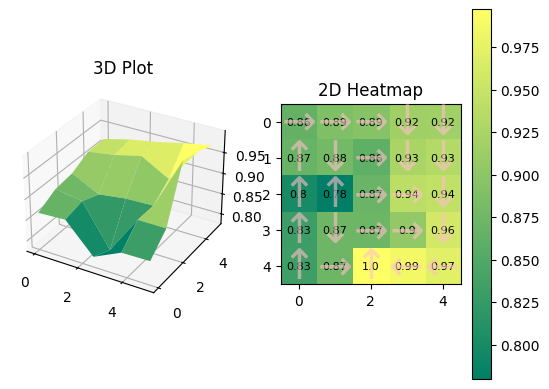

0.86479765	0.88813806	0.89419585	0.9158636	0.9169217	
0.8684571	0.8784746	0.86153626	0.9255527	0.93303716	
0.8000742	0.7798902	0.8706254	0.94077367	0.9441697	
0.83134174	0.8735343	0.8727739	0.90390205	0.95869225	
0.8326526	0.873422	0.9970996	0.98627096	0.9708729	
buffer_size 517
517
517


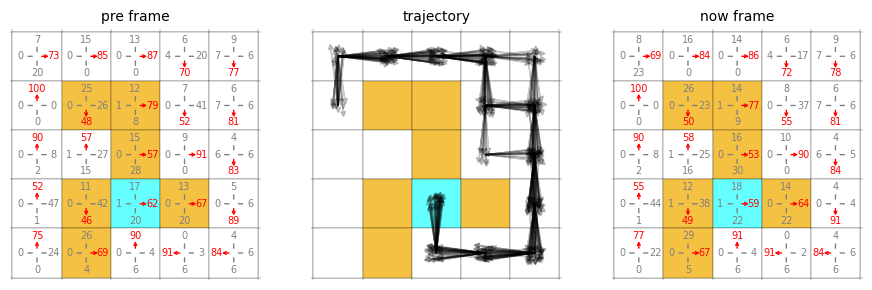

 27%|███████████████████████▏                                                              | 5400/20000 [31:00<1:08:24,  3.56it/s]

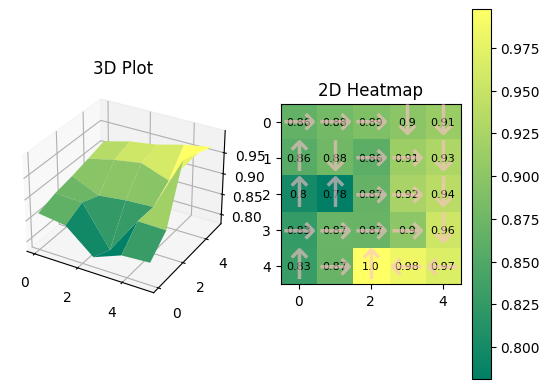

0.8649588	0.88002086	0.8886496	0.89981425	0.91191816	
0.85577905	0.87656707	0.85961497	0.91439486	0.92885387	
0.8004831	0.7813729	0.8673961	0.9246849	0.93836534	
0.8261241	0.8711901	0.87069243	0.90059066	0.9553913	
0.83018017	0.8698752	0.99742436	0.9835247	0.96716535	
buffer_size 521
521
521


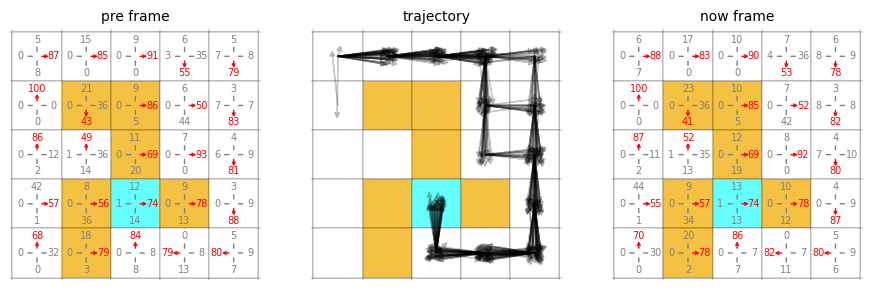

 27%|███████████████████████▍                                                              | 5450/20000 [31:17<1:10:45,  3.43it/s]

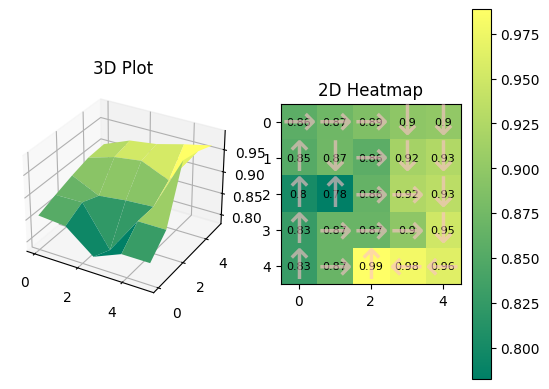

0.8572772	0.8725002	0.88629055	0.8976526	0.90042245	
0.8520774	0.87359726	0.857023	0.91598797	0.9253316	
0.8020394	0.7828349	0.86456096	0.9243568	0.9334767	
0.82827955	0.86822546	0.8683325	0.89727473	0.9494307	
0.8283905	0.86828095	0.9884752	0.97902274	0.9632337	
buffer_size 518
518
518


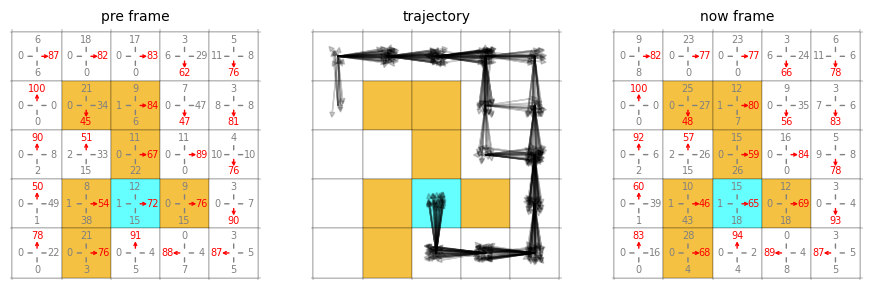

 28%|███████████████████████▋                                                              | 5500/20000 [31:34<1:07:42,  3.57it/s]

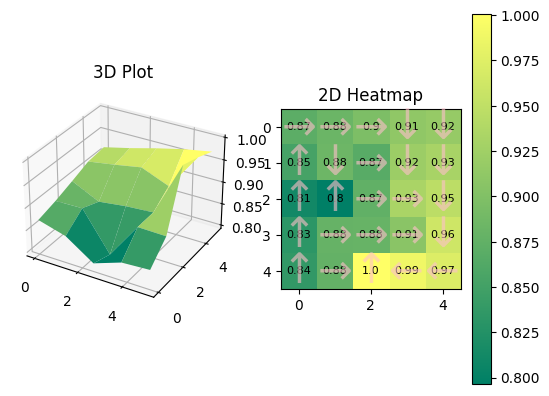

0.87055504	0.8820818	0.89667964	0.9121352	0.916808	
0.8530983	0.88354814	0.867027	0.9215852	0.93088734	
0.8110676	0.7966718	0.8748329	0.93231815	0.9467589	
0.83307576	0.8784901	0.8790966	0.9071822	0.9610392	
0.83681	0.8770324	1.0006161	0.9879429	0.971952	
buffer_size 514
514
514


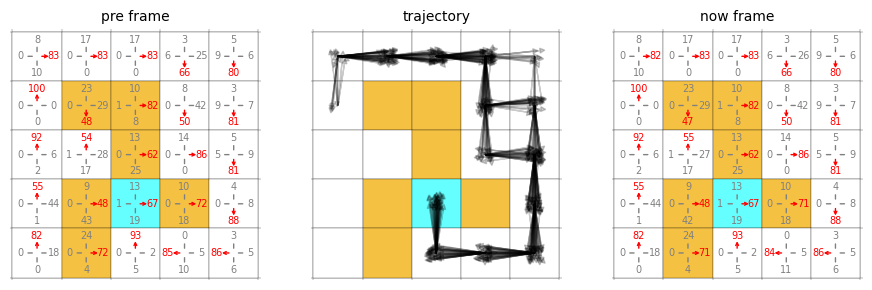

 28%|███████████████████████▊                                                              | 5550/20000 [31:51<1:08:25,  3.52it/s]

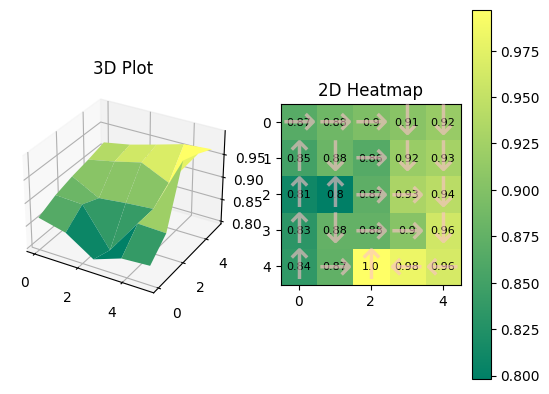

0.8657513	0.884524	0.89653444	0.9052181	0.9163314	
0.8508605	0.88171184	0.8648386	0.9172368	0.9270935	
0.81118464	0.79803896	0.87166095	0.9317255	0.9431237	
0.83283734	0.8760788	0.87649196	0.9036659	0.9599916	
0.836636	0.8735776	0.9971769	0.98298454	0.9648185	
buffer_size 528
528
528


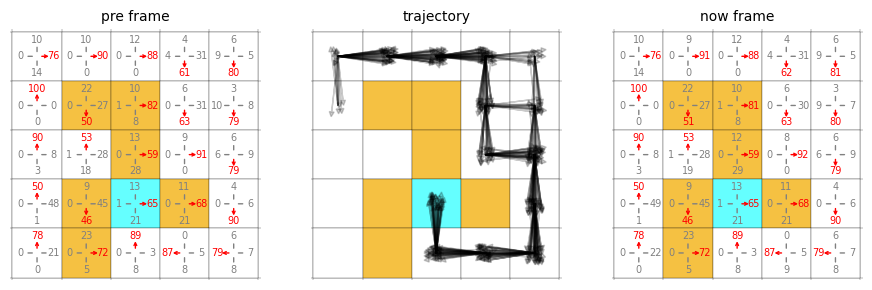

 28%|████████████████████████                                                              | 5600/20000 [32:08<1:06:31,  3.61it/s]

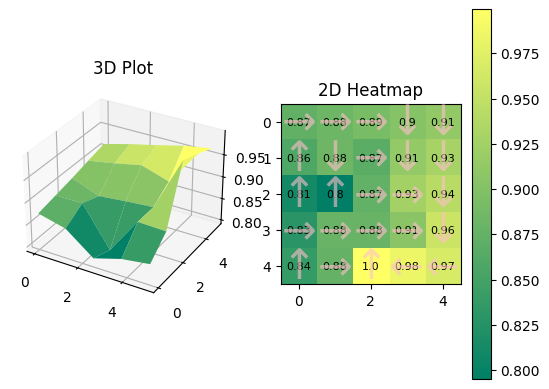

0.87358296	0.88261354	0.8916526	0.9021553	0.912202	
0.85818475	0.88318443	0.8679855	0.9128546	0.9282245	
0.8106084	0.7950232	0.8742423	0.92546904	0.9421061	
0.8292768	0.87843794	0.87914425	0.9060167	0.95728815	
0.8379787	0.876296	0.9992492	0.9845325	0.96753424	
buffer_size 515
515
515


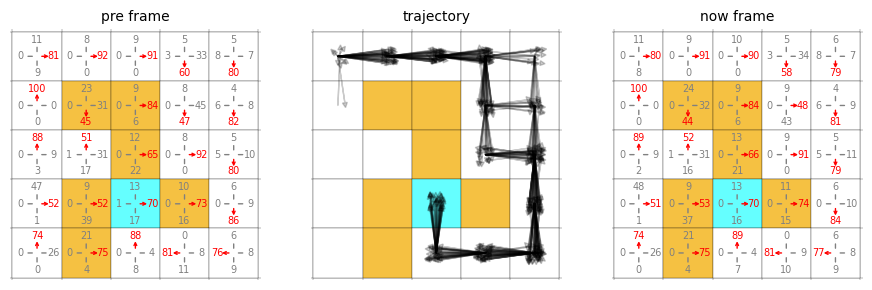

 28%|████████████████████████▎                                                             | 5650/20000 [32:25<1:07:38,  3.54it/s]

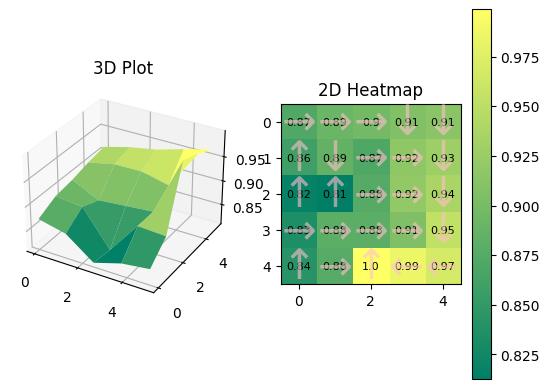

0.8727497	0.89103234	0.89700687	0.906689	0.91345274	
0.8596753	0.8857064	0.8702175	0.9180074	0.9276647	
0.81758446	0.81263506	0.875208	0.9189806	0.9374961	
0.83463717	0.88014156	0.8799403	0.90589005	0.953667	
0.8416709	0.87680197	0.9988715	0.9850943	0.9678181	
buffer_size 520
520
520


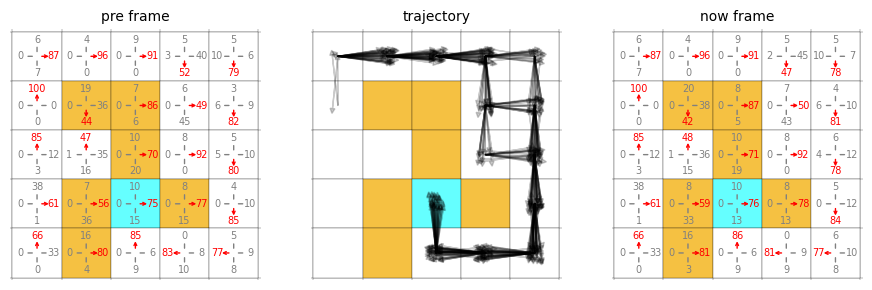

 28%|████████████████████████▌                                                             | 5700/20000 [32:42<1:08:45,  3.47it/s]

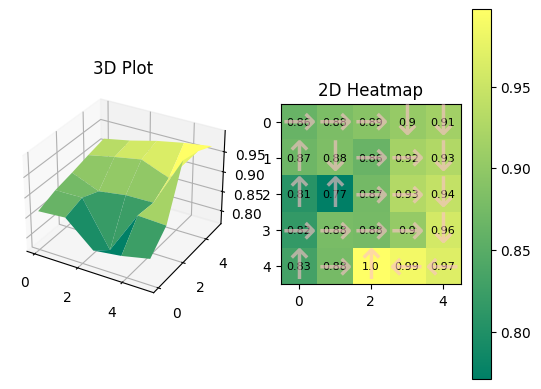

0.8636872	0.8814644	0.8919122	0.90399617	0.9147466	
0.8684819	0.8826083	0.864087	0.9177374	0.9277599	
0.80778944	0.77116764	0.87423384	0.9299963	0.9448136	
0.8166753	0.8791261	0.8754066	0.90277237	0.9578212	
0.8317132	0.87542343	0.9972587	0.98706096	0.9676992	
buffer_size 519
519
519


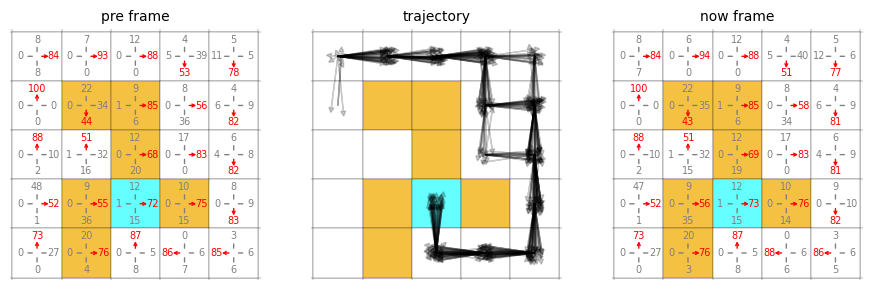

 29%|████████████████████████▋                                                             | 5750/20000 [32:59<1:06:52,  3.55it/s]

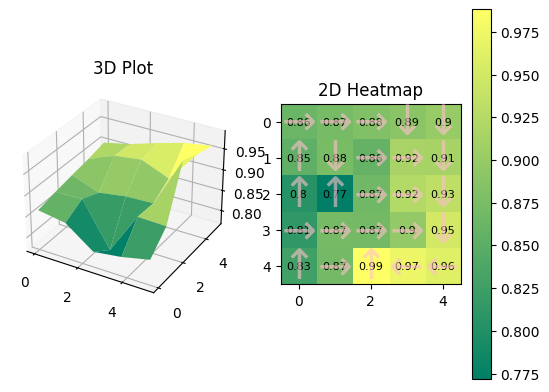

0.862743	0.8730508	0.8815652	0.88913685	0.89954907	
0.85227007	0.87553227	0.8575258	0.91512525	0.9129049	
0.80389005	0.77177024	0.8675777	0.92338556	0.93293315	
0.81284636	0.87214893	0.8701532	0.8964447	0.95041865	
0.82755375	0.87006295	0.9881542	0.9723236	0.96095103	
buffer_size 518
518
518


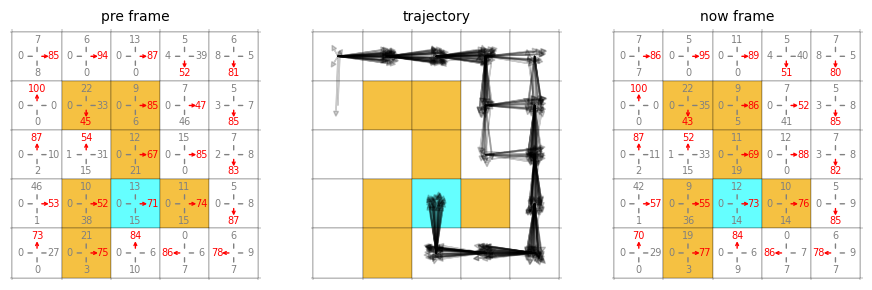

 29%|████████████████████████▉                                                             | 5800/20000 [33:17<1:07:17,  3.52it/s]

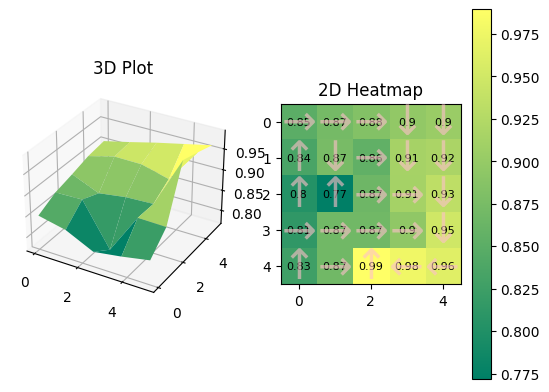

0.84964216	0.87179327	0.8834373	0.8965514	0.90322685	
0.8352968	0.8739188	0.855801	0.91318667	0.9180455	
0.8034457	0.7719424	0.86552036	0.9124721	0.9339005	
0.8134607	0.8695754	0.8686075	0.89507276	0.9480971	
0.8260262	0.8680496	0.9894533	0.9765539	0.96255004	
buffer_size 521
521
521


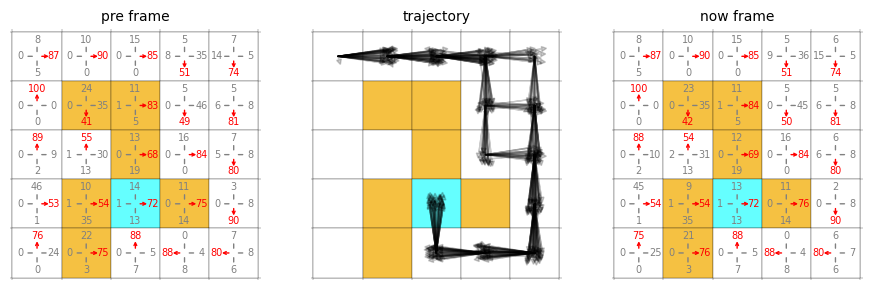

 29%|█████████████████████████▏                                                            | 5850/20000 [33:34<1:06:11,  3.56it/s]

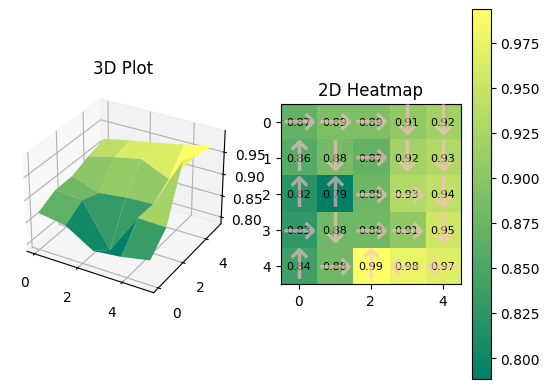

0.8689655	0.889347	0.89019144	0.90627635	0.9181316	
0.8589326	0.884083	0.86921513	0.92122334	0.93115604	
0.82083064	0.7886006	0.8771098	0.93330836	0.9417025	
0.82765234	0.88058645	0.88007057	0.90518665	0.95433265	
0.8402085	0.87895584	0.9936396	0.9769248	0.96679807	
buffer_size 514
514
514


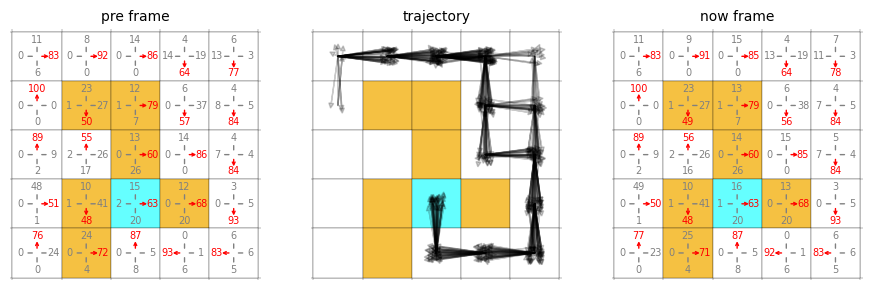

 30%|█████████████████████████▎                                                            | 5900/20000 [33:51<1:09:44,  3.37it/s]

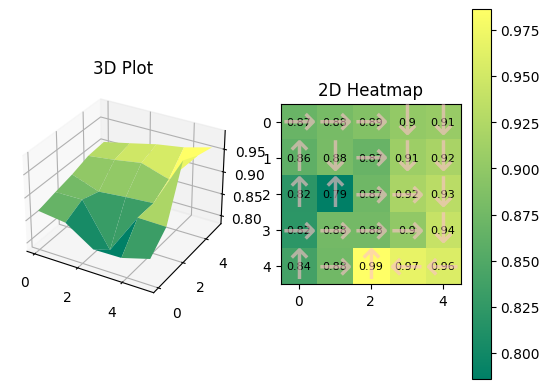

0.8687947	0.87938666	0.8888428	0.9018972	0.9055406	
0.8609098	0.88026696	0.8673948	0.90935767	0.9186032	
0.820699	0.785687	0.87294734	0.91905475	0.9322629	
0.8216712	0.87680906	0.87705797	0.8995335	0.94149685	
0.8392379	0.8752191	0.9863763	0.96822	0.9576521	
buffer_size 514
514
514


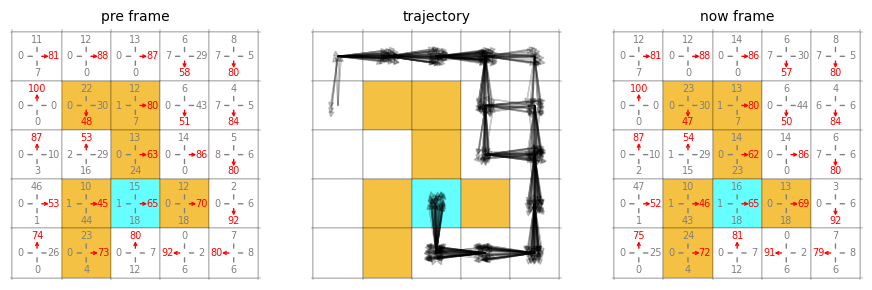

 30%|█████████████████████████▌                                                            | 5950/20000 [34:08<1:07:47,  3.45it/s]

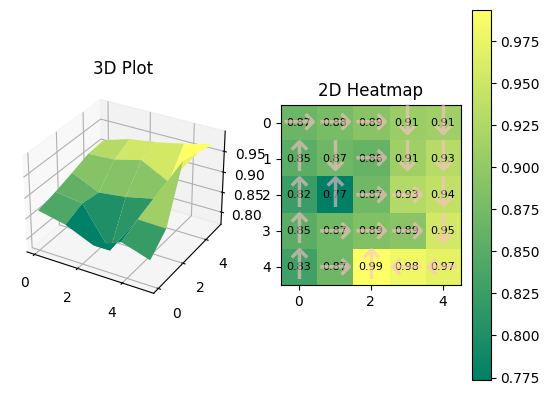

0.8669791	0.87832737	0.8921743	0.9076813	0.9111136	
0.8525871	0.8698155	0.862633	0.91140926	0.9311066	
0.8237357	0.77376306	0.8709486	0.9279058	0.9406731	
0.8524903	0.87081206	0.8859667	0.89327836	0.9547387	
0.83067477	0.8693478	0.99361753	0.9814462	0.97068113	
buffer_size 518
518
518


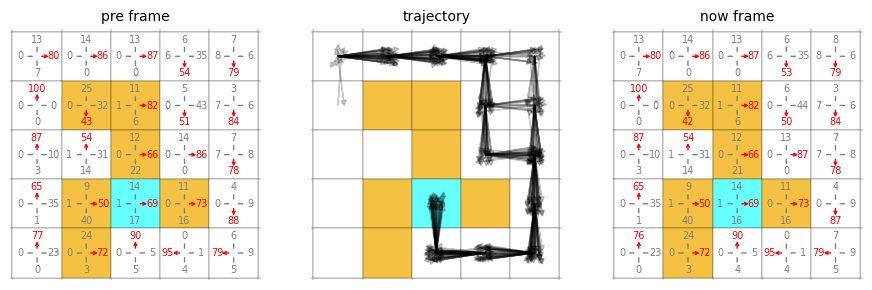

 30%|█████████████████████████▊                                                            | 6000/20000 [34:25<1:05:54,  3.54it/s]

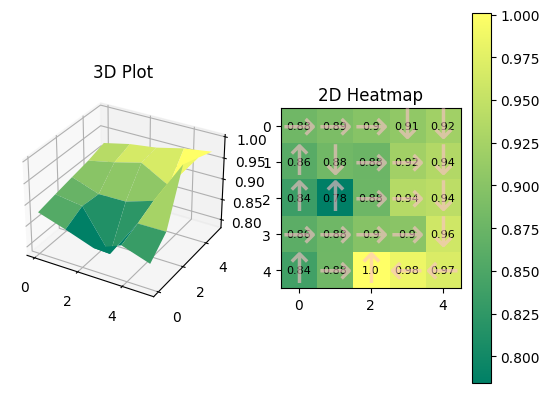

0.87982464	0.8897291	0.8988707	0.907725	0.920866	
0.8587904	0.8805113	0.87625027	0.92143214	0.9353516	
0.83549404	0.78435576	0.8771585	0.9381205	0.9438937	
0.86236775	0.8784603	0.89803207	0.9013492	0.95936	
0.8400283	0.8790227	1.0007325	0.98498094	0.96895313	
buffer_size 526
526
526


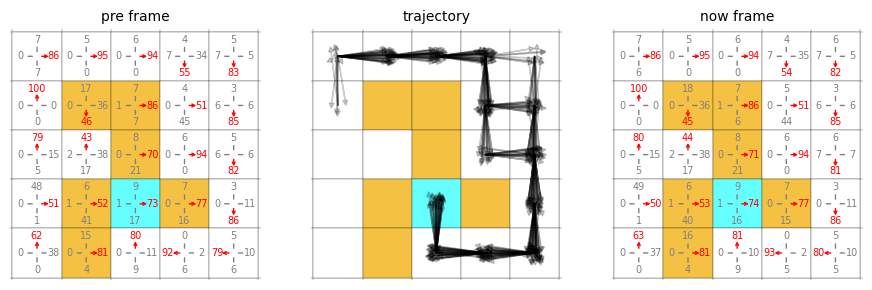

 30%|██████████████████████████                                                            | 6050/20000 [34:43<1:05:28,  3.55it/s]

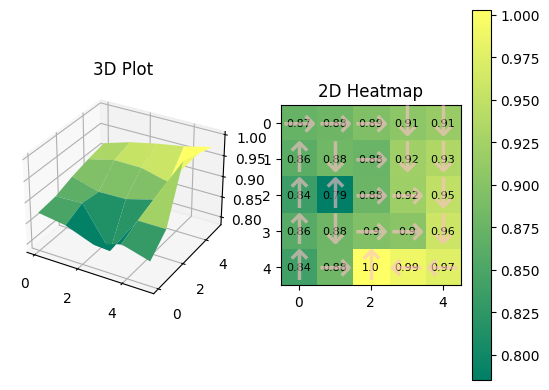

0.87294805	0.8786168	0.8941498	0.9054278	0.9143088	
0.86277676	0.8819246	0.87568754	0.9208401	0.9342334	
0.837544	0.785216	0.8772253	0.9201821	0.9479465	
0.8590765	0.87928486	0.89509237	0.9034666	0.95884824	
0.8397656	0.8795147	1.002543	0.98893017	0.97463775	
buffer_size 521
521
521


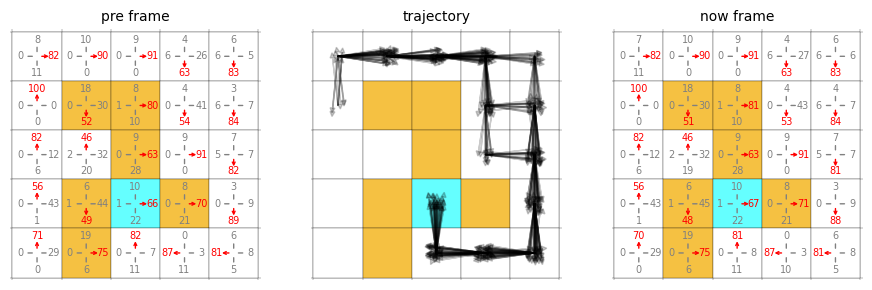

 30%|██████████████████████████▏                                                           | 6100/20000 [35:00<1:04:48,  3.57it/s]

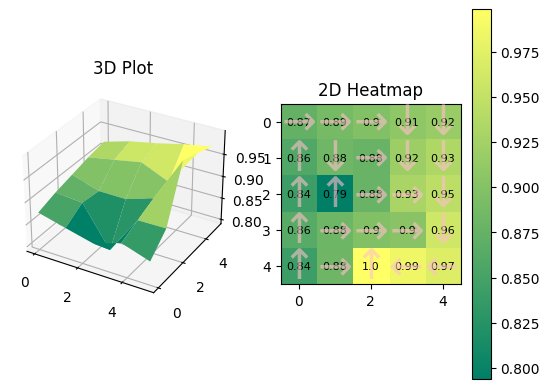

0.8745054	0.88823783	0.89849675	0.9089968	0.91645324	
0.8585442	0.8832036	0.87854743	0.91992974	0.9338224	
0.84317577	0.7940046	0.8781897	0.9311099	0.9455155	
0.8637463	0.88111687	0.8978778	0.9039601	0.9597598	
0.8429259	0.88185525	0.9982982	0.9855646	0.9704748	
buffer_size 523
523
523


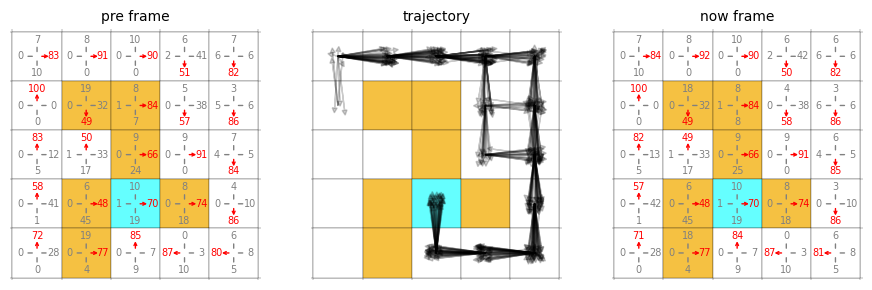

 31%|██████████████████████████▍                                                           | 6150/20000 [35:17<1:07:11,  3.44it/s]

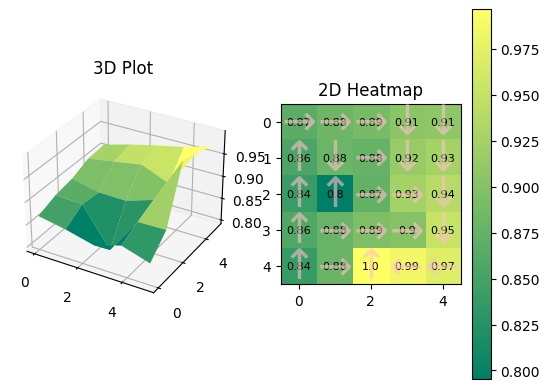

0.866941	0.8822166	0.8895911	0.90583205	0.9089848	
0.8556891	0.8797823	0.8757161	0.9152177	0.9256855	
0.84050655	0.7953533	0.8746181	0.92542356	0.9395722	
0.8584341	0.8773933	0.89412826	0.90043986	0.95225453	
0.83924735	0.8786777	0.99642134	0.98627067	0.9697553	
buffer_size 525
525
525


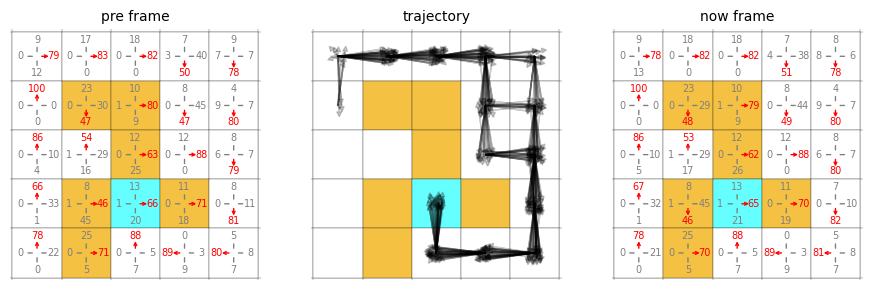

 31%|██████████████████████████▋                                                           | 6200/20000 [35:34<1:04:55,  3.54it/s]

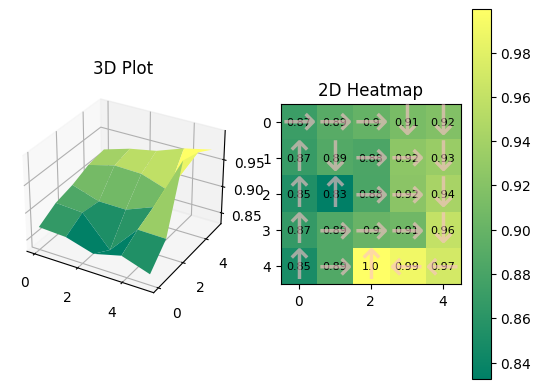

0.87151134	0.89033866	0.89858794	0.91203266	0.9179305	
0.86864316	0.8872118	0.8822949	0.92496973	0.93275726	
0.85352045	0.8325522	0.8816371	0.9232656	0.9422444	
0.8665257	0.8865628	0.9013528	0.90605944	0.9602493	
0.849175	0.88545084	0.99948764	0.98976517	0.9714158	
buffer_size 519
519
519


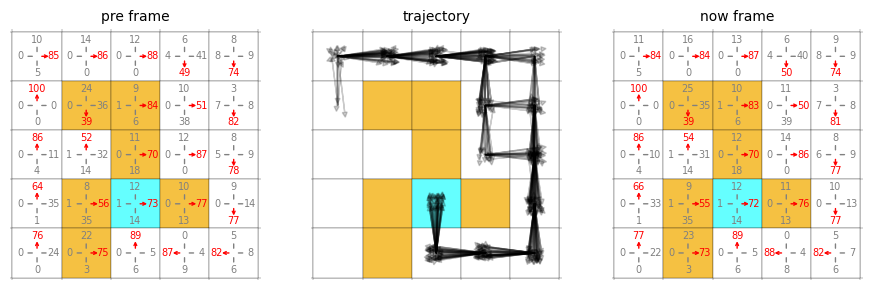

 31%|██████████████████████████▉                                                           | 6250/20000 [35:51<1:05:21,  3.51it/s]

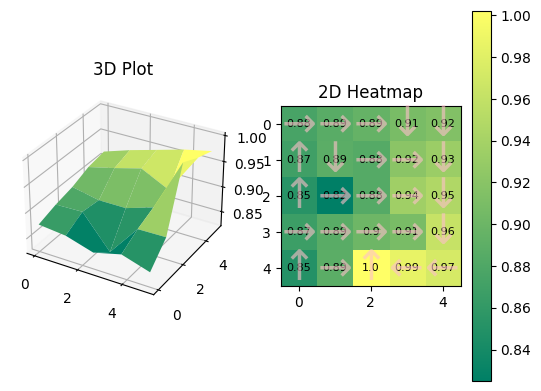

0.87515426	0.8867292	0.894933	0.90892816	0.9151349	
0.8697659	0.8883958	0.8839054	0.9216137	0.93231195	
0.85355043	0.8249308	0.8839413	0.9355811	0.9470034	
0.8673699	0.8870412	0.90120107	0.9087906	0.9619534	
0.85034466	0.88797116	1.0019016	0.9853729	0.9732545	
buffer_size 514
514
514


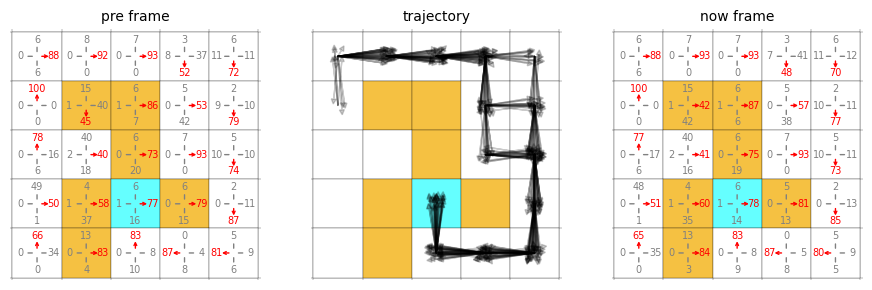

 32%|███████████████████████████                                                           | 6300/20000 [36:08<1:02:29,  3.65it/s]

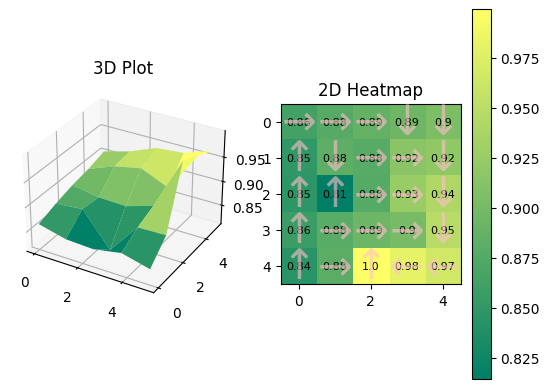

0.8635436	0.8767745	0.88713133	0.8940351	0.9046238	
0.84978324	0.882308	0.877684	0.9150694	0.9197403	
0.8470962	0.81423885	0.8758255	0.92614865	0.941782	
0.85734814	0.87867546	0.89312017	0.90148425	0.9466324	
0.84300065	0.88030547	0.99941087	0.9818864	0.9659836	
buffer_size 521
521
521


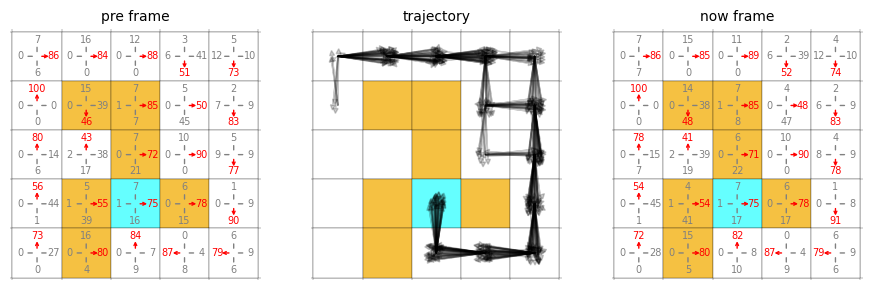

 32%|███████████████████████████▎                                                          | 6350/20000 [36:25<1:05:02,  3.50it/s]

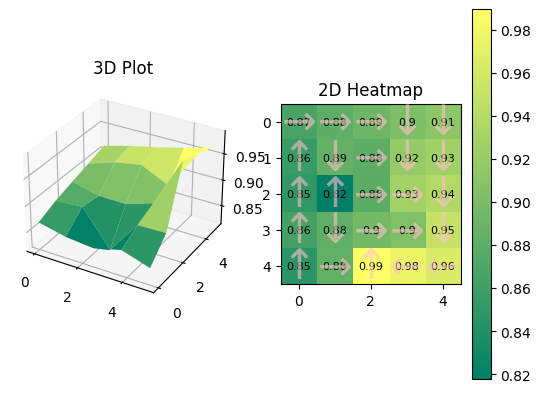

0.8669851	0.88148654	0.8922276	0.9023051	0.912928	
0.85524917	0.88522875	0.8797039	0.91907656	0.9263646	
0.85027564	0.8179058	0.8792206	0.9281505	0.93765134	
0.8634681	0.88196826	0.8958533	0.90337753	0.95011383	
0.8465834	0.88317937	0.989493	0.9767212	0.96459436	
buffer_size 522
522
522


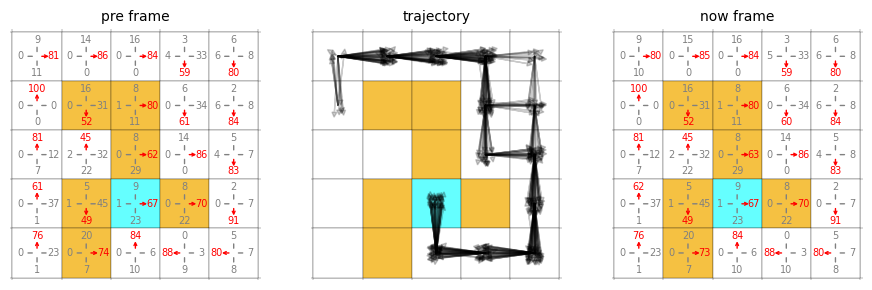

 32%|███████████████████████████▌                                                          | 6400/20000 [36:43<1:04:04,  3.54it/s]

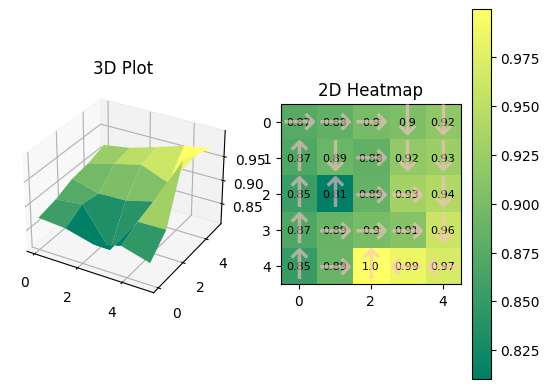

0.8740601	0.8830327	0.8985138	0.9041238	0.9167031	
0.8691248	0.8901189	0.8834265	0.9185376	0.9258809	
0.8539971	0.8102294	0.8852738	0.93213093	0.94250154	
0.8688819	0.8879466	0.89988595	0.9094362	0.9608532	
0.8522954	0.889091	0.9996153	0.98641753	0.9700991	
buffer_size 514
514
514


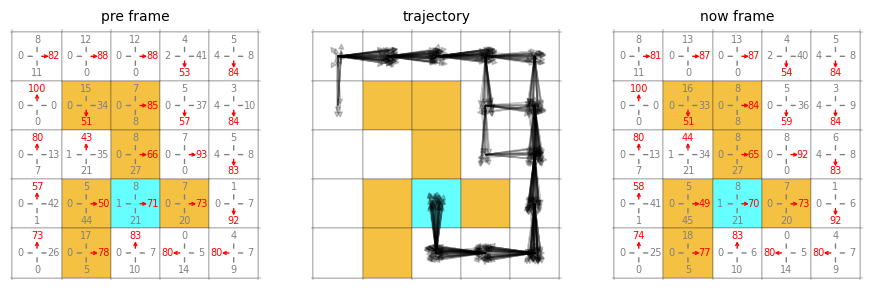

 32%|███████████████████████████▋                                                          | 6450/20000 [37:00<1:03:13,  3.57it/s]

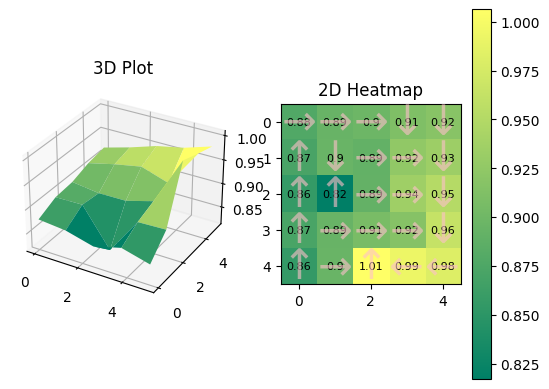

0.8775134	0.8947361	0.89845896	0.911167	0.91804004	
0.8719299	0.89579344	0.8910854	0.9244516	0.93356216	
0.85672224	0.8173959	0.89163256	0.9350979	0.9516381	
0.8720253	0.89413893	0.9075312	0.9163182	0.96314484	
0.85648656	0.8960773	1.0062449	0.9927778	0.98103225	
buffer_size 516
516
516


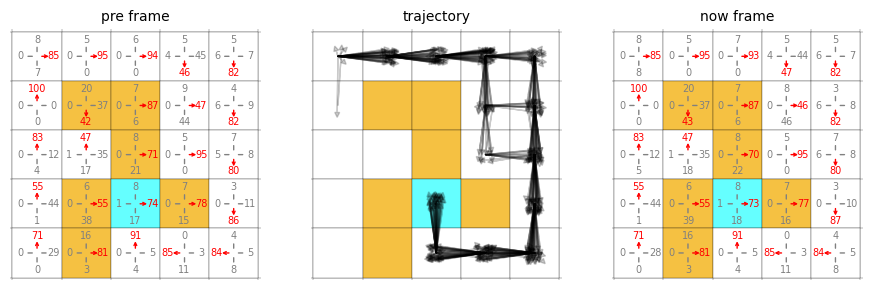

 32%|███████████████████████████▉                                                          | 6500/20000 [37:17<1:03:04,  3.57it/s]

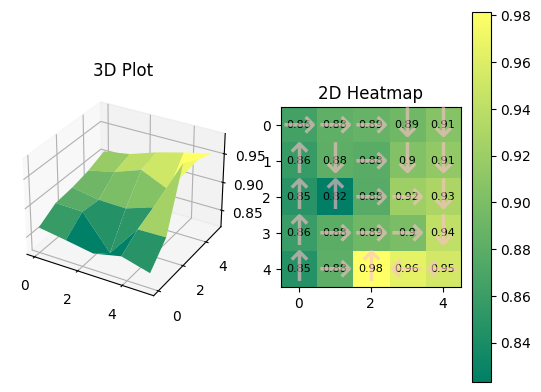

0.86465216	0.8830877	0.88670766	0.89386487	0.9060438	
0.8571979	0.8818657	0.87829673	0.904333	0.91393113	
0.84887564	0.8232219	0.87720555	0.9212971	0.9296929	
0.85951006	0.8800011	0.8932339	0.89955306	0.942169	
0.8461015	0.8810402	0.9813059	0.96492934	0.95343417	
buffer_size 522
522
522


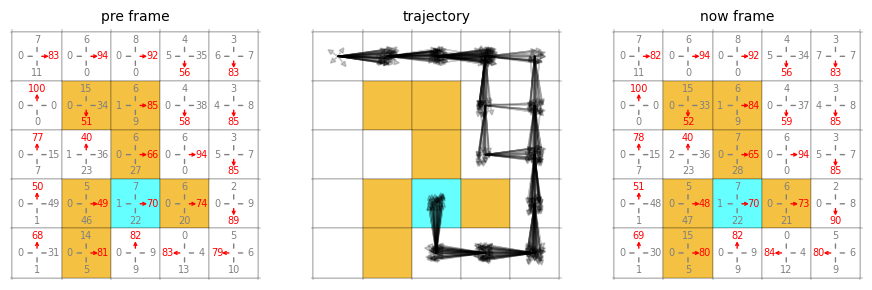

 33%|████████████████████████████▏                                                         | 6550/20000 [37:34<1:03:21,  3.54it/s]

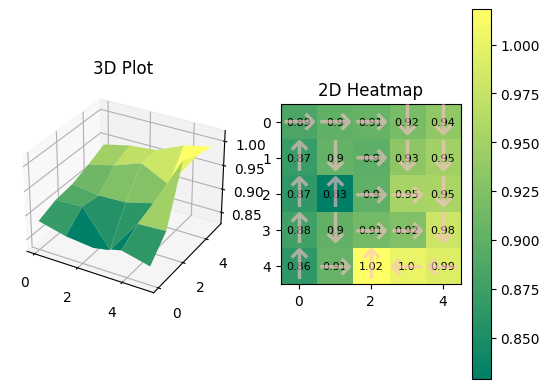

0.8859081	0.9007251	0.90584934	0.91975534	0.9365196	
0.8717233	0.9039633	0.8978315	0.9339082	0.9493331	
0.86535674	0.8292097	0.9000943	0.9536119	0.9547885	
0.87856543	0.9020107	0.9148991	0.924999	0.9797474	
0.8643306	0.9051253	1.01793	1.0018903	0.99228346	
buffer_size 524
524
524


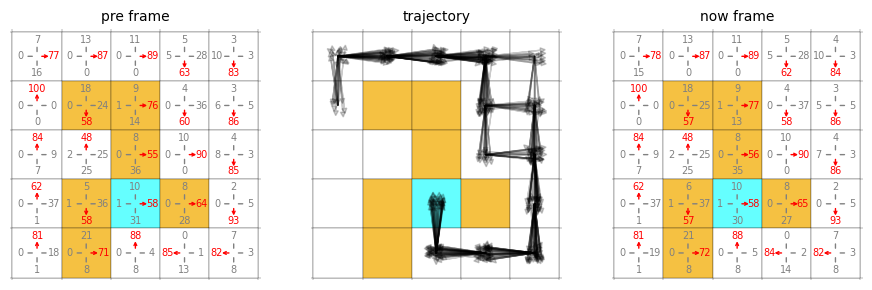

 33%|████████████████████████████▍                                                         | 6600/20000 [37:51<1:03:19,  3.53it/s]

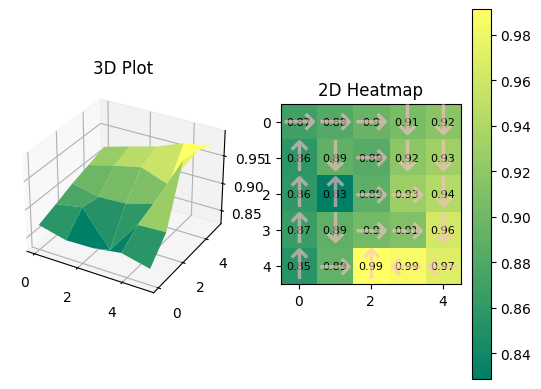

0.8705344	0.8826711	0.8958687	0.9059267	0.9167234	
0.8581853	0.8914171	0.8851433	0.9184514	0.9304886	
0.8594352	0.82879066	0.8878392	0.92872155	0.94334507	
0.8666683	0.88981545	0.90177226	0.9109624	0.9624624	
0.8546082	0.89198	0.9912263	0.98586035	0.9701842	
buffer_size 515
515
515


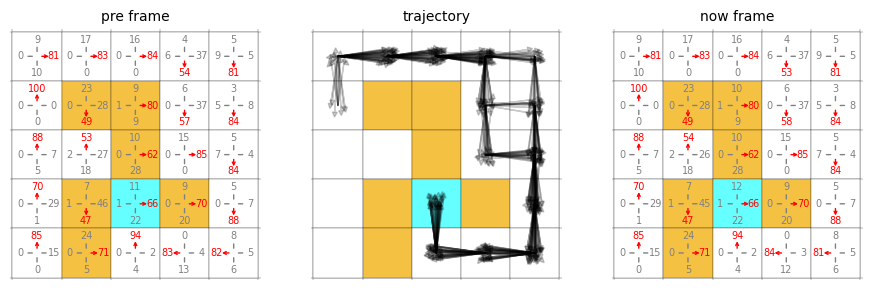

 33%|████████████████████████████▌                                                         | 6650/20000 [38:09<1:05:39,  3.39it/s]

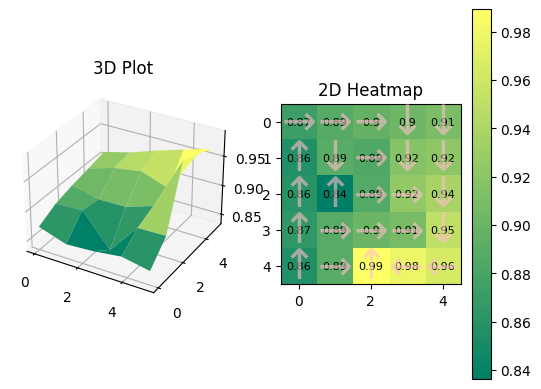

0.8725171	0.8881275	0.8964802	0.90311605	0.91019046	
0.8571236	0.890539	0.8853229	0.91666484	0.92168015	
0.8600792	0.8363292	0.8861173	0.92377734	0.93730795	
0.86600524	0.8885542	0.9011911	0.90759075	0.9513869	
0.8570131	0.88977766	0.98926795	0.9781654	0.9646311	
buffer_size 514
514
514


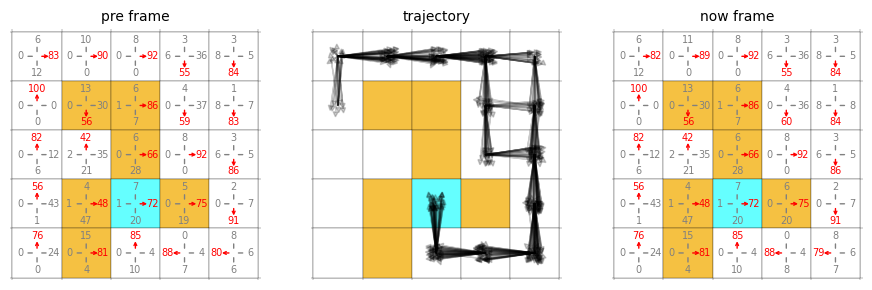

 34%|████████████████████████████▊                                                         | 6700/20000 [38:26<1:03:01,  3.52it/s]

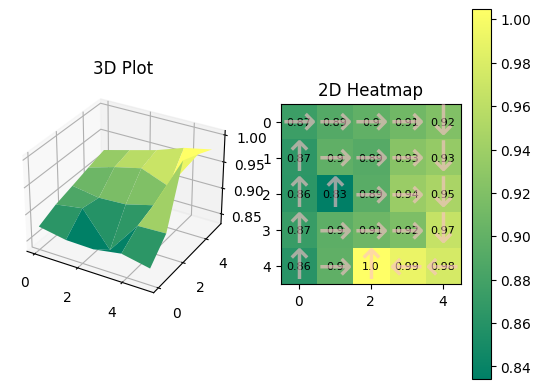

0.87492365	0.8901451	0.899975	0.9103583	0.92018145	
0.8654763	0.89831775	0.89183056	0.92538893	0.93376195	
0.8641983	0.8342	0.89435065	0.9373096	0.9475215	
0.8727287	0.89639175	0.9079422	0.9174962	0.9655409	
0.8619511	0.89820915	1.0046027	0.99113697	0.97621554	
buffer_size 518
518
518


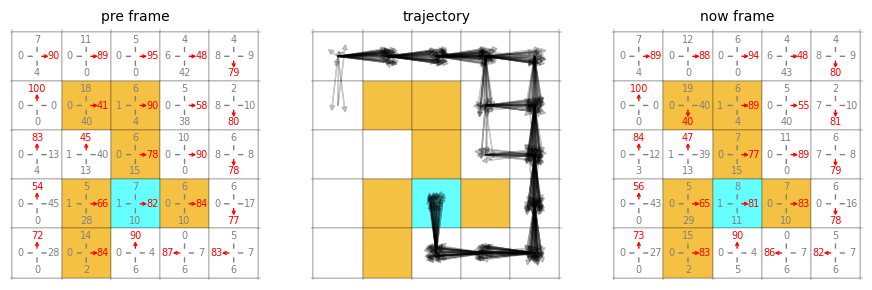

 34%|█████████████████████████████                                                         | 6750/20000 [38:43<1:01:54,  3.57it/s]

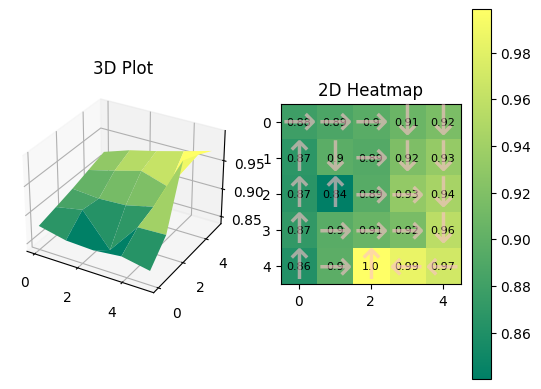

0.87913024	0.8875052	0.8961675	0.90644693	0.9167008	
0.8684032	0.8970114	0.8922154	0.9183819	0.9325199	
0.86620677	0.8401705	0.89450073	0.9313278	0.9437946	
0.8712724	0.8954284	0.9059485	0.91621745	0.9564419	
0.8618114	0.89717233	0.9985577	0.9852762	0.969728	
buffer_size 526
526
526


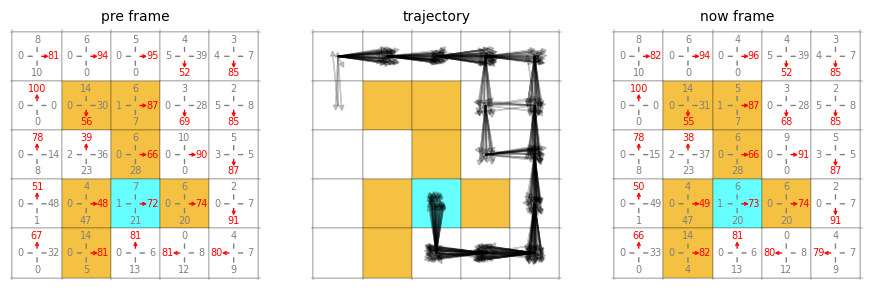

 34%|█████████████████████████████▏                                                        | 6800/20000 [39:00<1:01:42,  3.57it/s]

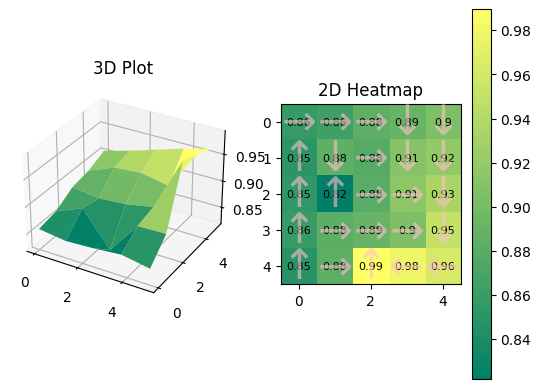

0.8573258	0.86402434	0.8839359	0.89062	0.9047868	
0.85060024	0.88480204	0.87750584	0.9105896	0.9186891	
0.85336727	0.8218103	0.8813721	0.914562	0.9341645	
0.8578495	0.88264596	0.89103836	0.9046798	0.94966316	
0.8487599	0.8839977	0.98952603	0.97841144	0.9623349	
buffer_size 528
528
528


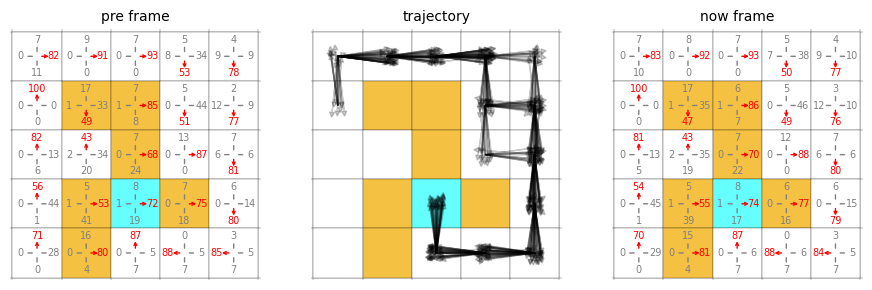

 34%|█████████████████████████████▍                                                        | 6850/20000 [39:17<1:01:38,  3.56it/s]

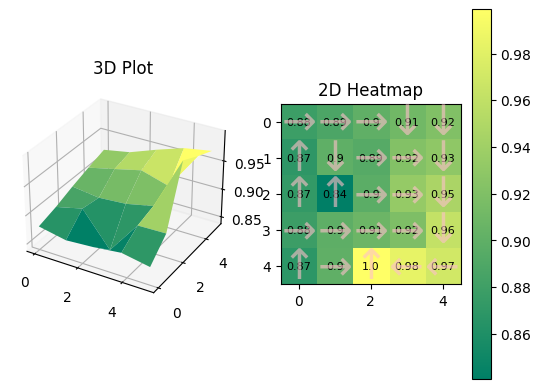

0.8786917	0.8881527	0.90043914	0.9110828	0.920962	
0.86922574	0.89955294	0.89425135	0.9218588	0.9293596	
0.87244415	0.8406788	0.89753664	0.93282795	0.9465717	
0.87792027	0.89901066	0.9077734	0.91865045	0.9621867	
0.86900294	0.90007585	0.99889886	0.98347986	0.9701252	
buffer_size 514
514
514


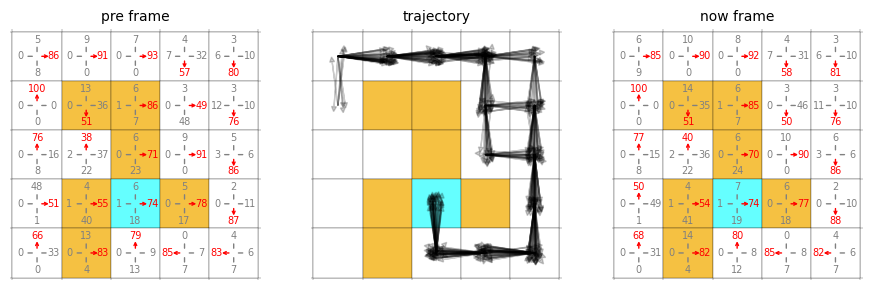

 34%|█████████████████████████████▋                                                        | 6900/20000 [39:34<1:01:10,  3.57it/s]

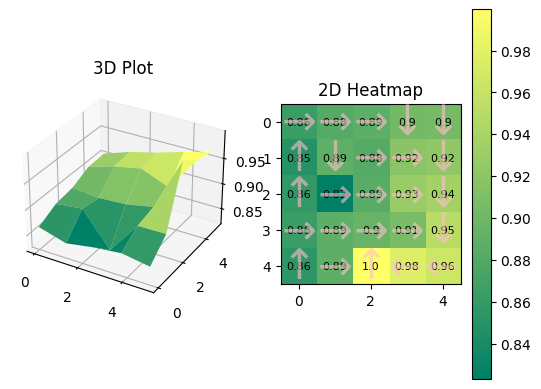

0.8643218	0.8821311	0.88745904	0.9031978	0.9048408	
0.8489612	0.88860863	0.8823911	0.9187839	0.92264926	
0.8580295	0.82304335	0.88572305	0.9291718	0.93555844	
0.8638446	0.88743615	0.89586055	0.90740323	0.9512939	
0.85532665	0.88844955	0.9997194	0.9763166	0.9645268	
buffer_size 523
523
523


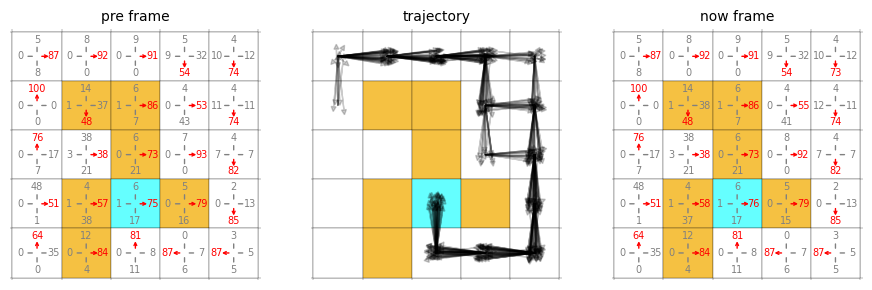

 35%|█████████████████████████████▉                                                        | 6950/20000 [39:51<1:00:40,  3.58it/s]

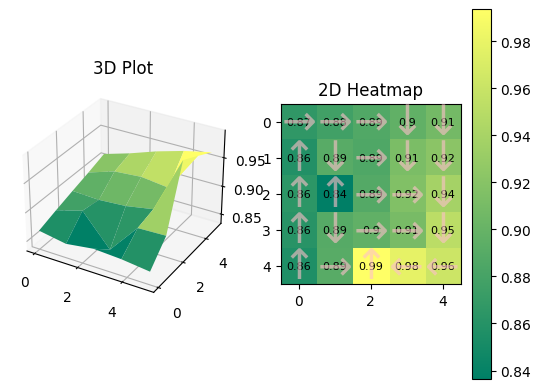

0.86623466	0.87722665	0.88745844	0.8972125	0.9079972	
0.8579786	0.8906305	0.88532436	0.91225636	0.92199266	
0.8646506	0.83653086	0.8884862	0.91597664	0.9382256	
0.8618823	0.8894811	0.89712125	0.91026783	0.9517214	
0.8561047	0.8910383	0.9936642	0.97817725	0.9620988	
buffer_size 518
518
518


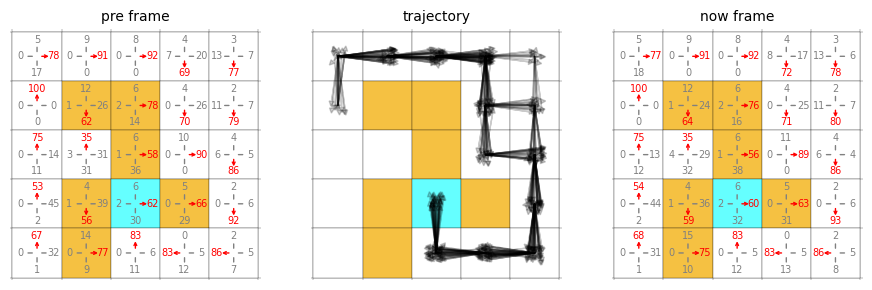

 35%|██████████████████████████████                                                        | 7000/20000 [40:08<1:02:32,  3.46it/s]

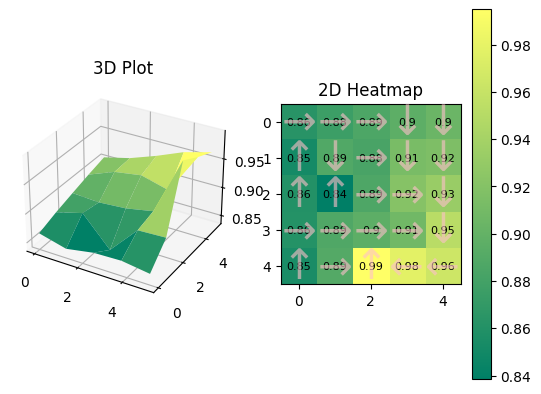

0.86399096	0.8759837	0.8859668	0.89558667	0.90417457	
0.85169	0.8887904	0.88315696	0.9136418	0.9155546	
0.86005783	0.83854365	0.8866544	0.92085016	0.9323876	
0.8616455	0.8878975	0.89584506	0.90818095	0.9516071	
0.854745	0.8899949	0.9949773	0.97807485	0.96412706	
buffer_size 519
519
519


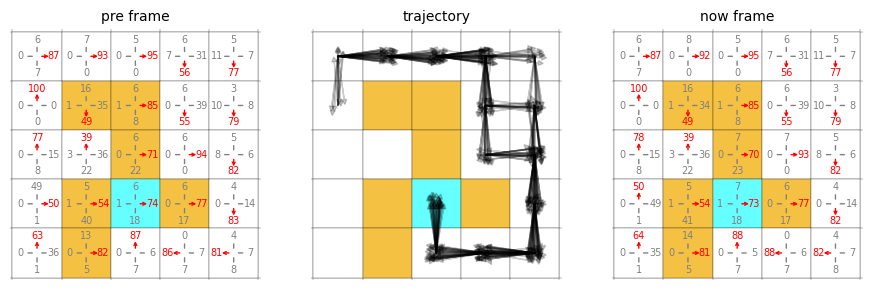

 35%|██████████████████████████████▎                                                       | 7050/20000 [40:25<1:00:16,  3.58it/s]

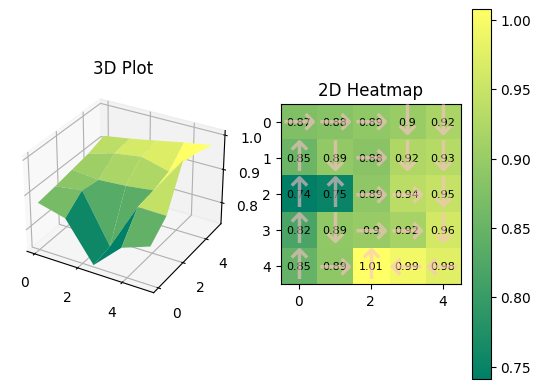

0.87485766	0.88260186	0.89226687	0.90157735	0.91892266	
0.8535907	0.89375836	0.88470006	0.92447007	0.9314401	
0.74116534	0.75215507	0.89004725	0.9362055	0.94643134	
0.8184853	0.89304435	0.9000064	0.91539454	0.9623332	
0.8479473	0.891896	1.007552	0.9932673	0.9751452	
buffer_size 518
518
518


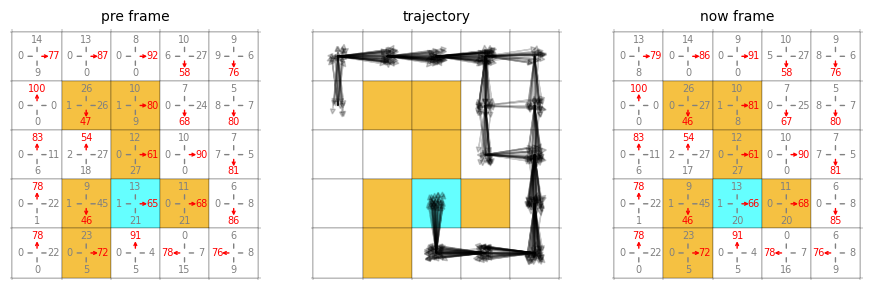

 36%|██████████████████████████████▌                                                       | 7100/20000 [40:42<1:00:30,  3.55it/s]

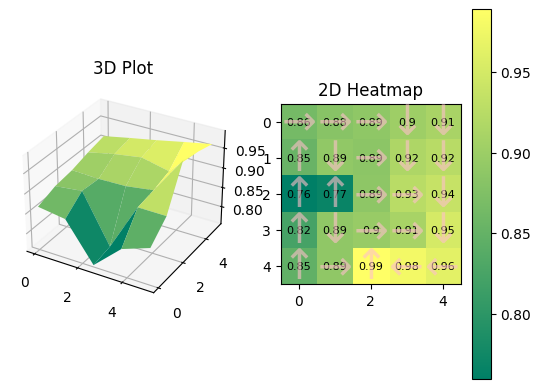

0.8647333	0.8817139	0.8883774	0.9014834	0.911739	
0.8545152	0.889544	0.88555294	0.9155974	0.9249457	
0.7598292	0.7686909	0.88692063	0.92577165	0.9373653	
0.8231199	0.8893359	0.8965726	0.91009337	0.95093703	
0.84788656	0.8886509	0.9886718	0.97728014	0.96399844	
buffer_size 514
514
514


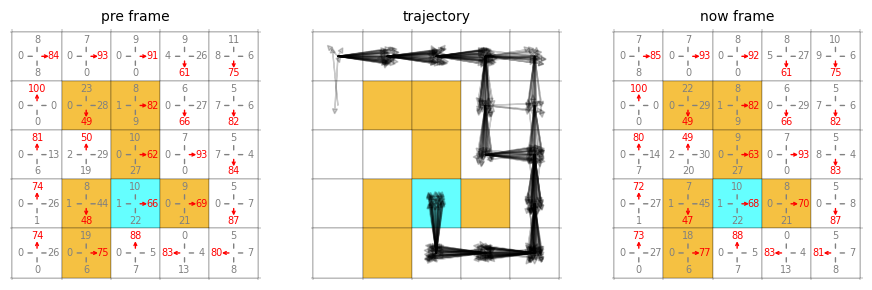

 36%|███████████████████████████████▍                                                        | 7150/20000 [40:59<59:45,  3.58it/s]

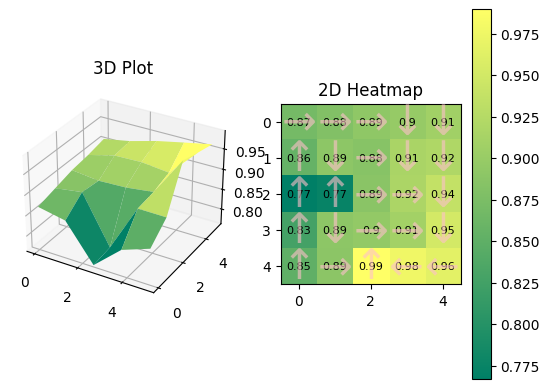

0.8687928	0.88045377	0.8921205	0.898131	0.90759706	
0.8554903	0.89018935	0.8846915	0.91489446	0.9197763	
0.7669109	0.77342546	0.88726354	0.9168603	0.9376849	
0.8263835	0.88997555	0.8957431	0.90965295	0.95155203	
0.85091674	0.88922733	0.9896201	0.9763724	0.96498984	
buffer_size 519
519
519


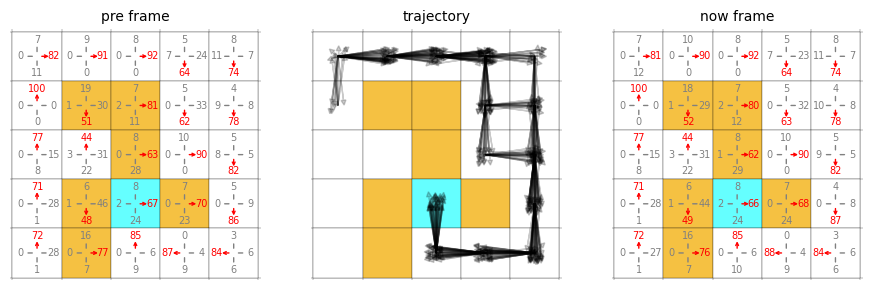

 36%|███████████████████████████████▋                                                        | 7200/20000 [41:16<59:16,  3.60it/s]

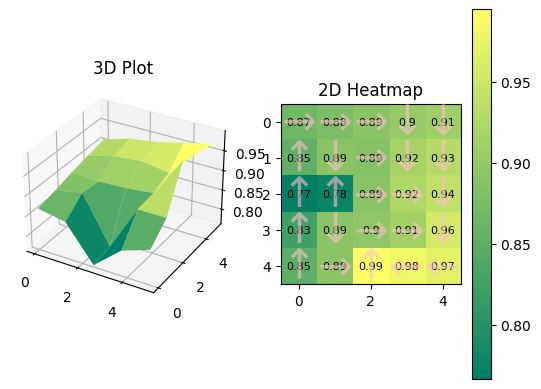

0.86678445	0.8776288	0.8901535	0.89999187	0.9091499	
0.8540256	0.8913096	0.88552046	0.9159138	0.92967033	
0.7665287	0.7758633	0.8888035	0.9229796	0.93890274	
0.82573664	0.8906797	0.89571023	0.91236067	0.9554186	
0.85001886	0.8907558	0.9948933	0.9818493	0.97011054	
buffer_size 515
515
515


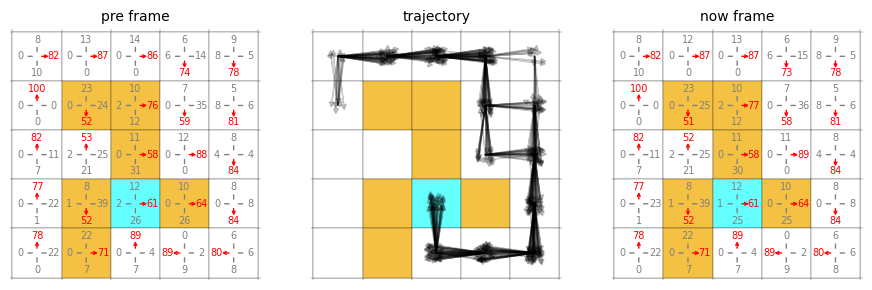

 36%|███████████████████████████████▏                                                      | 7250/20000 [41:33<1:00:58,  3.49it/s]

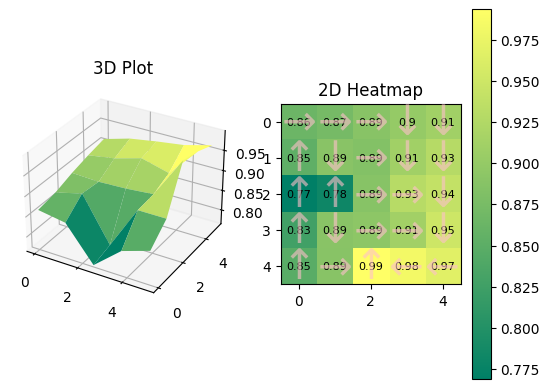

0.8639214	0.87247705	0.88825536	0.9004108	0.91042745	
0.85285676	0.88988674	0.885088	0.9109616	0.9293082	
0.7690195	0.7816009	0.8876548	0.9297764	0.93994105	
0.8261919	0.8891363	0.8934132	0.911726	0.94886696	
0.84854734	0.88903093	0.99335766	0.9828435	0.9662491	
buffer_size 516
516
516


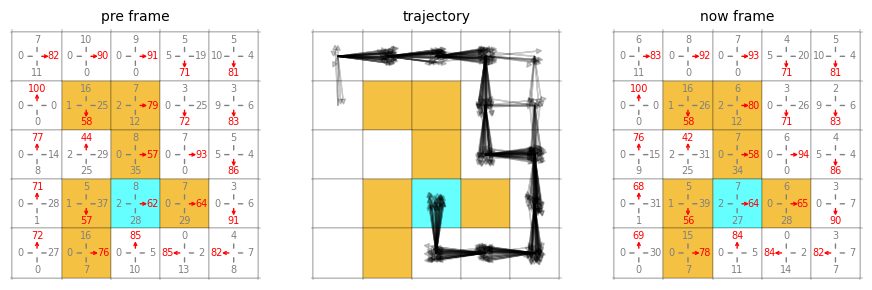

 36%|████████████████████████████████                                                        | 7300/20000 [41:50<58:44,  3.60it/s]

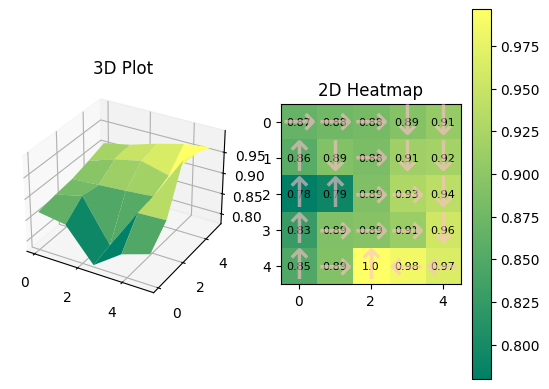

0.8666513	0.87510765	0.8804316	0.8924713	0.906376	
0.85644925	0.89095926	0.8843287	0.9148491	0.9196692	
0.7799153	0.791773	0.8890091	0.9285097	0.9393313	
0.827326	0.8893616	0.89467394	0.91170895	0.9560629	
0.84882677	0.89204204	0.99643195	0.9846214	0.9653717	
buffer_size 515
515
515


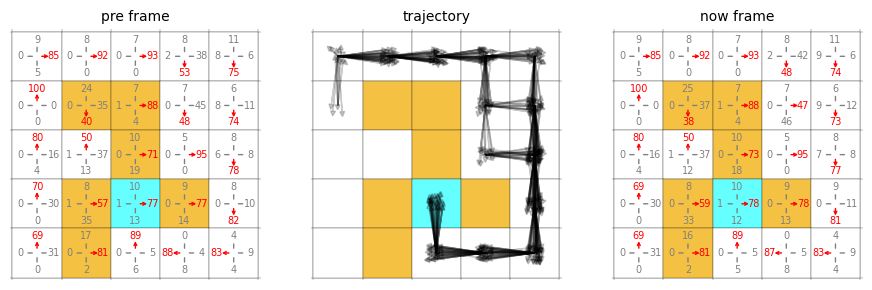

 37%|████████████████████████████████▎                                                       | 7350/20000 [42:08<58:58,  3.58it/s]

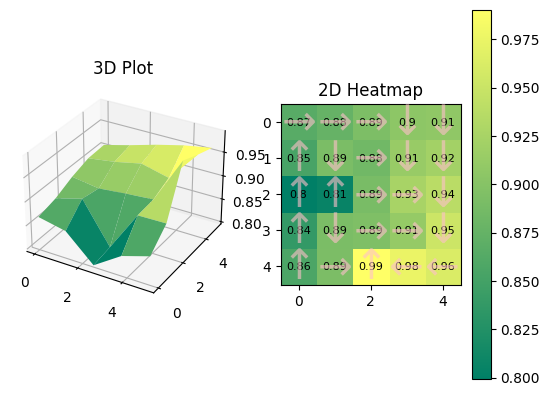

0.8655032	0.87536037	0.89271677	0.9049351	0.9070618	
0.8534274	0.89140177	0.8842187	0.91302705	0.9218546	
0.79914653	0.80559206	0.88978016	0.92510355	0.93810457	
0.83776605	0.89103425	0.894535	0.9109132	0.9520687	
0.855996	0.89196706	0.9903314	0.9751414	0.962165	
buffer_size 516
516
516


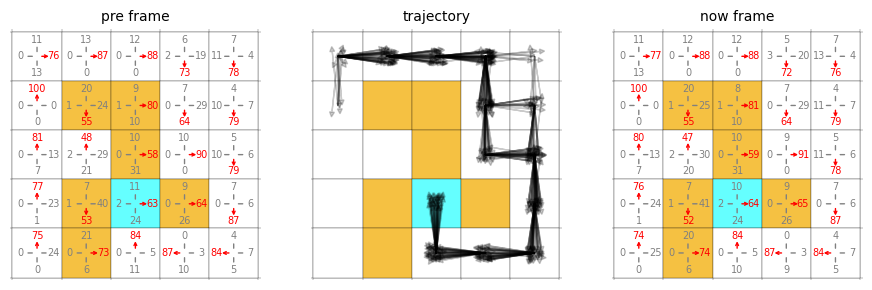

 37%|████████████████████████████████▌                                                       | 7400/20000 [42:25<59:08,  3.55it/s]

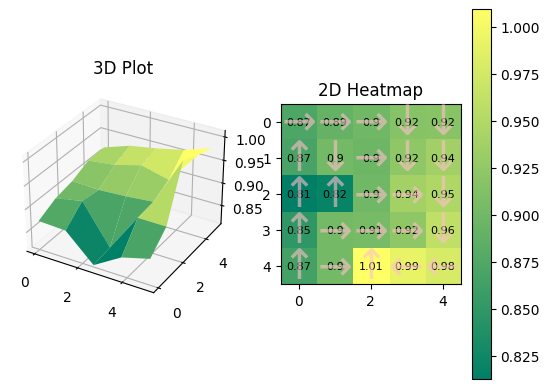

0.8718596	0.89085066	0.8992393	0.9163449	0.9179008	
0.86918604	0.9025005	0.8966337	0.9227437	0.93732953	
0.8126365	0.81807303	0.89987063	0.9382881	0.94735134	
0.8489808	0.90162313	0.9053493	0.9231255	0.95983684	
0.8654045	0.90111494	1.0094503	0.99243695	0.9793828	
buffer_size 513
513
513


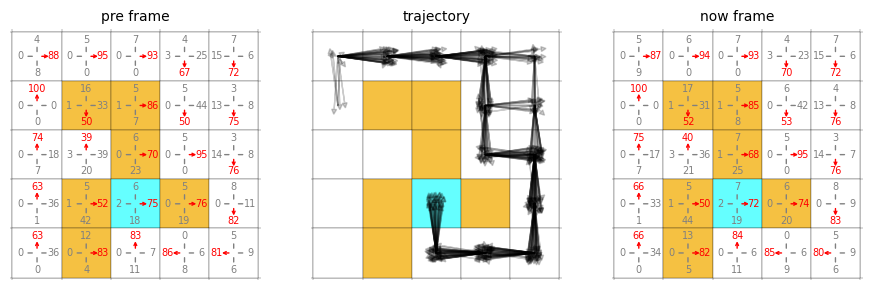

 37%|████████████████████████████████▊                                                       | 7450/20000 [42:42<58:55,  3.55it/s]

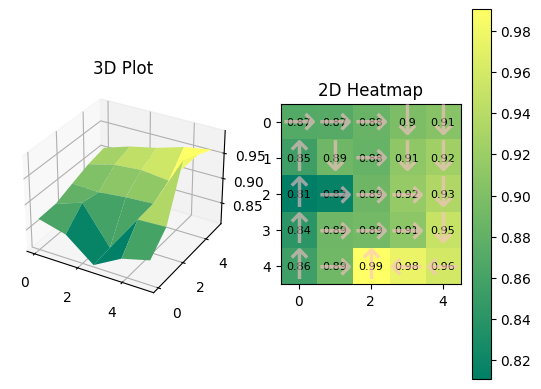

0.8692696	0.8713539	0.88495827	0.8978824	0.90594923	
0.8547573	0.889286	0.8828051	0.91153395	0.9231434	
0.8109318	0.81552374	0.8885292	0.9161009	0.9348009	
0.8415909	0.8887377	0.8917078	0.9100342	0.9509275	
0.85609114	0.8908096	0.99033624	0.97545826	0.9600978	
buffer_size 522
522
522


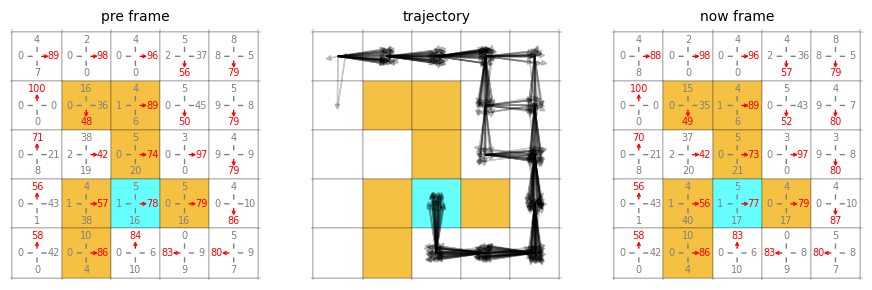

 38%|█████████████████████████████████                                                       | 7500/20000 [42:59<59:49,  3.48it/s]

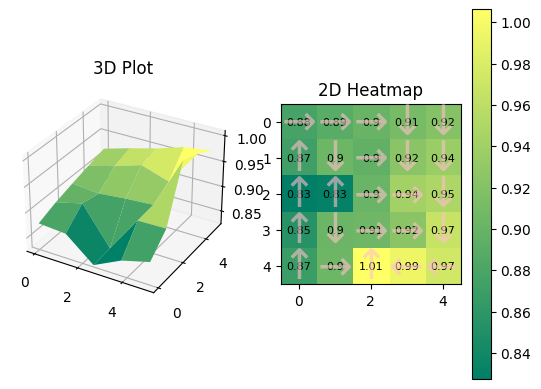

0.8765348	0.8903502	0.9010642	0.91093755	0.92032456	
0.8727091	0.9041708	0.896362	0.92485714	0.93572474	
0.82747704	0.8307364	0.9019844	0.9418992	0.9495685	
0.85434175	0.90298104	0.90556	0.9242468	0.96678156	
0.8691653	0.9041011	1.0061691	0.99383587	0.97344655	
buffer_size 519
519
519


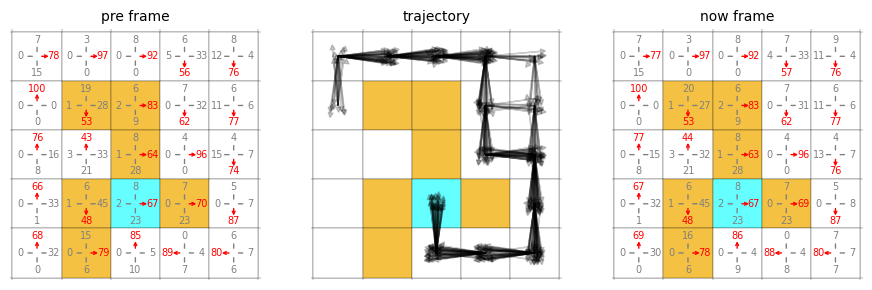

 38%|█████████████████████████████████▏                                                      | 7550/20000 [43:16<57:57,  3.58it/s]

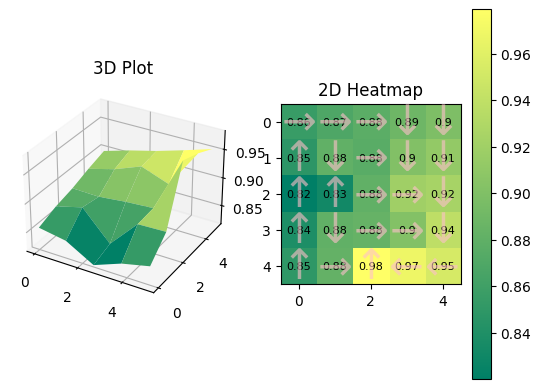

0.8560954	0.8687916	0.877023	0.88874185	0.8985543	
0.84778655	0.881425	0.87567425	0.90132046	0.9124531	
0.8201198	0.8313021	0.8807517	0.91956925	0.92432725	
0.8387021	0.8810028	0.88383704	0.90185976	0.9384082	
0.84987664	0.88260734	0.97906214	0.96822727	0.9533685	
buffer_size 517
517
517


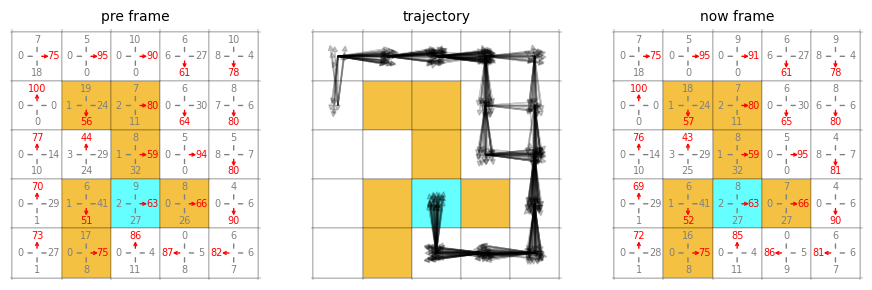

 38%|█████████████████████████████████▍                                                      | 7600/20000 [43:33<58:41,  3.52it/s]

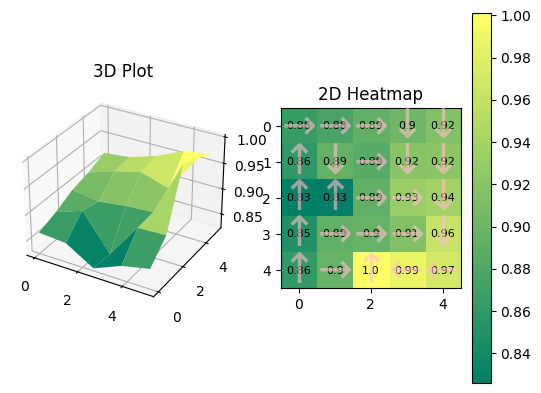

0.86372495	0.8762386	0.89346796	0.9021946	0.9165506	
0.85969746	0.8944999	0.8854254	0.91927755	0.92218995	
0.8274153	0.8259275	0.8925264	0.9319933	0.93869615	
0.8496453	0.89351654	0.8960976	0.9149048	0.96244717	
0.8613286	0.89591444	1.0008974	0.9874855	0.9700166	
buffer_size 519
519
519


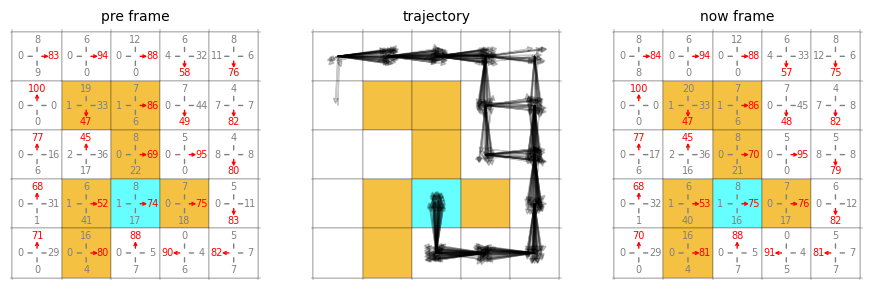

 38%|█████████████████████████████████▋                                                      | 7650/20000 [43:50<56:08,  3.67it/s]

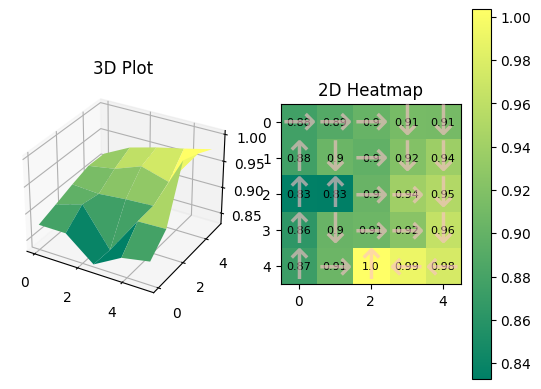

0.8769734	0.88892734	0.9014807	0.91230303	0.91163623	
0.87673825	0.9043801	0.8980408	0.92067707	0.937523	
0.83405316	0.83274263	0.90276647	0.939745	0.9514197	
0.8635311	0.9033923	0.9055257	0.92460835	0.9629605	
0.87340987	0.90511906	1.0034201	0.9911762	0.9754785	
buffer_size 519
519
519


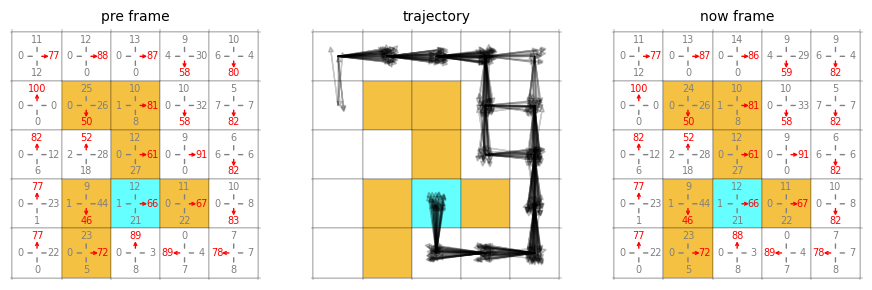

 38%|█████████████████████████████████▉                                                      | 7700/20000 [44:08<59:51,  3.42it/s]

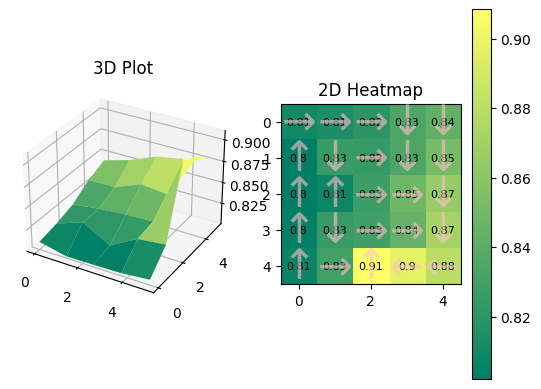

0.8091482	0.8138981	0.8205739	0.83443177	0.84295714	
0.8020495	0.82532954	0.82477725	0.8346108	0.8521604	
0.80240774	0.80753165	0.82729816	0.8473838	0.8650265	
0.80306584	0.8255247	0.8290303	0.8441653	0.871052	
0.80624306	0.82905805	0.9083847	0.89759773	0.87986565	
buffer_size 520
520
520


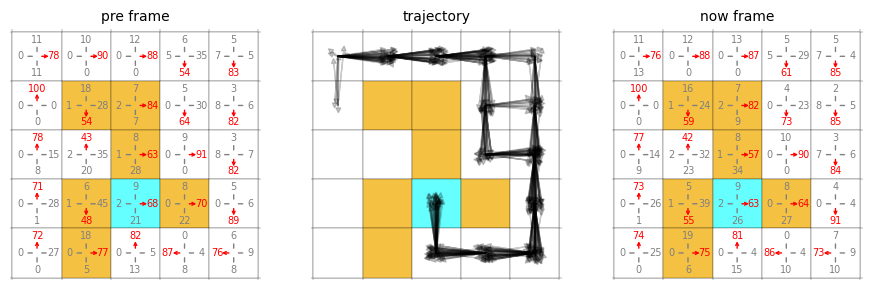

 39%|██████████████████████████████████                                                      | 7750/20000 [44:25<58:17,  3.50it/s]

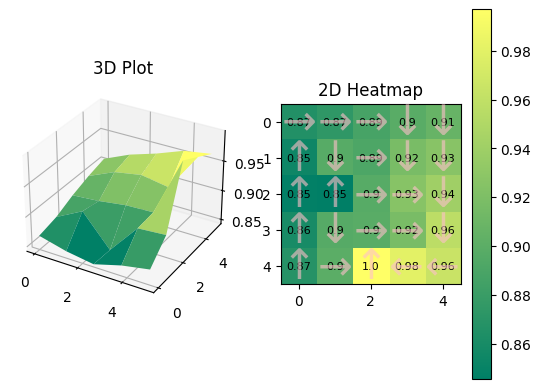

0.8660489	0.8736398	0.8876265	0.8984372	0.90662223	
0.8542725	0.8973835	0.8912326	0.9180237	0.92626953	
0.8470546	0.8455427	0.8975336	0.92586994	0.9403908	
0.8600788	0.89666784	0.8992064	0.9180156	0.9573096	
0.8685541	0.8998505	0.99695283	0.9808723	0.96445	
buffer_size 514
514
514


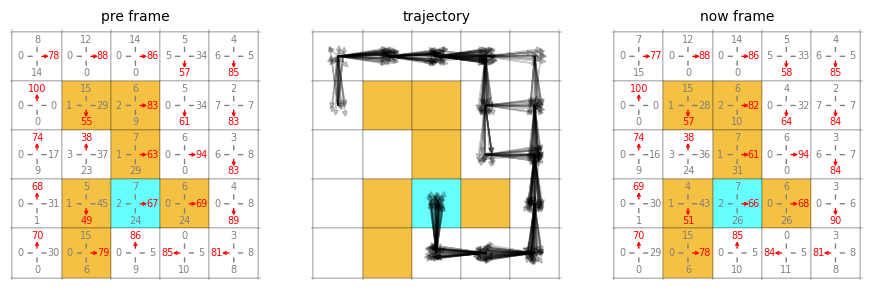

 39%|██████████████████████████████████▎                                                     | 7800/20000 [44:42<55:55,  3.64it/s]

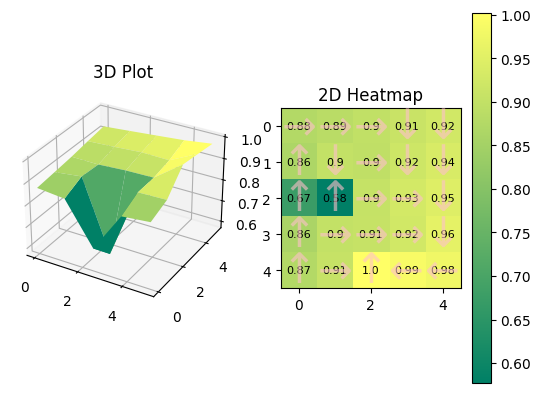

0.87666357	0.88677084	0.8973992	0.9116603	0.924492	
0.8646275	0.9024713	0.89588463	0.9183787	0.9354251	
0.67465305	0.57710946	0.9037494	0.9272234	0.9466959	
0.8611144	0.9032484	0.9064336	0.92475003	0.95826536	
0.874111	0.90652937	1.0014088	0.988587	0.97534597	
buffer_size 514
514
514


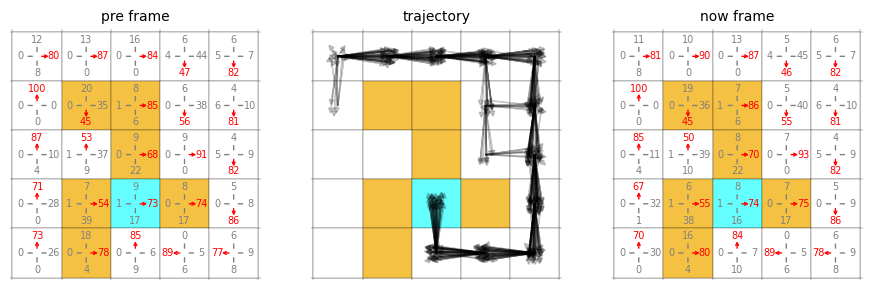

 39%|██████████████████████████████████▌                                                     | 7850/20000 [44:59<56:46,  3.57it/s]

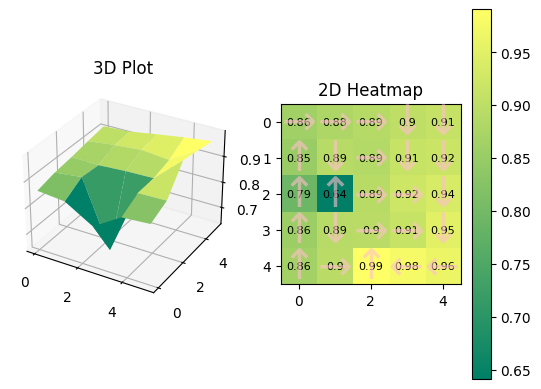

0.86234224	0.87954044	0.8887911	0.9012331	0.9118506	
0.85271525	0.89192677	0.88603735	0.91385674	0.91830266	
0.79033786	0.6415292	0.8926336	0.92334294	0.93538344	
0.8568643	0.89235306	0.8955252	0.9134073	0.9507879	
0.86467266	0.89542973	0.99068886	0.9778878	0.96369344	
buffer_size 523
523
523


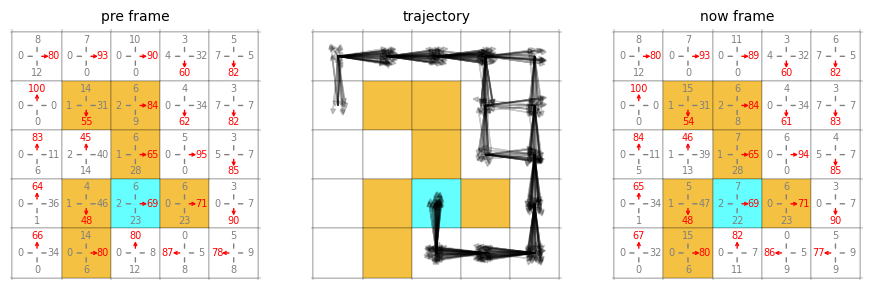

 40%|██████████████████████████████████▊                                                     | 7900/20000 [45:16<55:24,  3.64it/s]

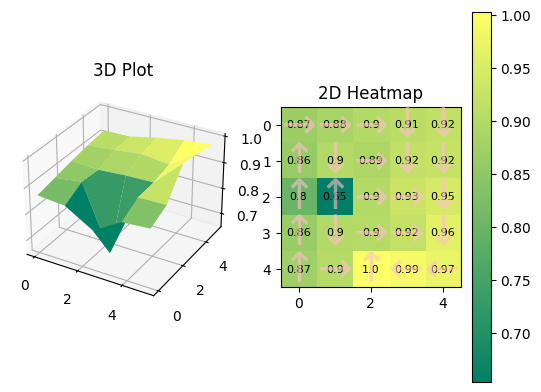

0.86882603	0.88300663	0.8980508	0.90977395	0.91850674	
0.860531	0.89817774	0.89193255	0.9184618	0.92310524	
0.798418	0.6540285	0.8997475	0.93133515	0.94574916	
0.86257595	0.8993346	0.90301776	0.92042553	0.96367365	
0.8710928	0.9030882	1.0027415	0.9892243	0.97485495	
buffer_size 517
517
517


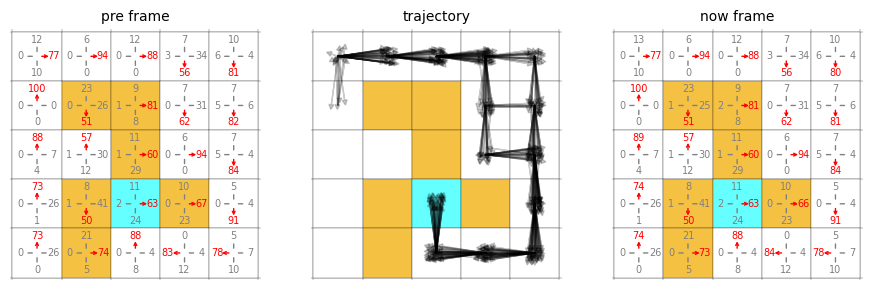

 40%|██████████████████████████████████▉                                                     | 7950/20000 [45:33<56:26,  3.56it/s]

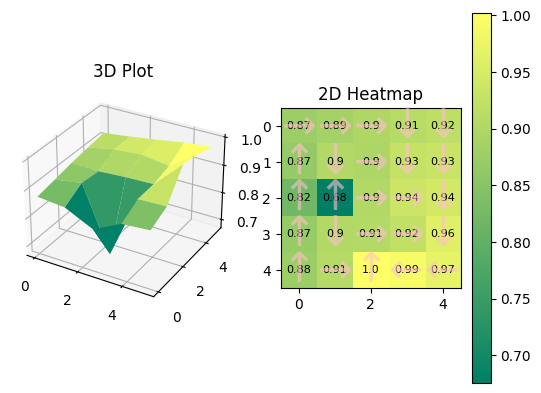

0.87491965	0.8870204	0.90013564	0.91005856	0.918617	
0.86589324	0.9031739	0.8966452	0.92860985	0.93068224	
0.8187996	0.6754248	0.9026574	0.93630505	0.94480336	
0.86794823	0.90275025	0.90586656	0.9229429	0.9603299	
0.8760302	0.90641385	1.0017476	0.9903398	0.9702788	
buffer_size 523
523
523


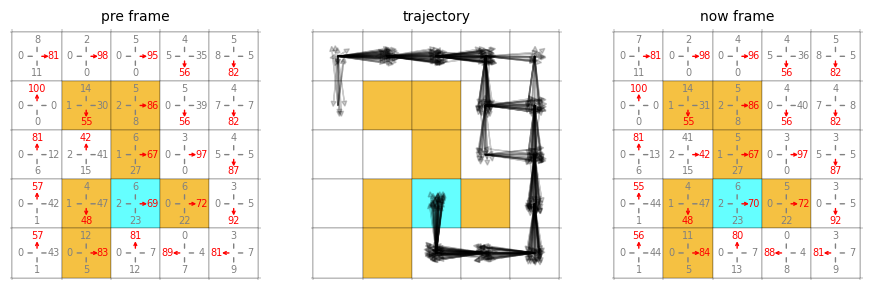

 40%|███████████████████████████████████▏                                                    | 8000/20000 [45:50<55:11,  3.62it/s]

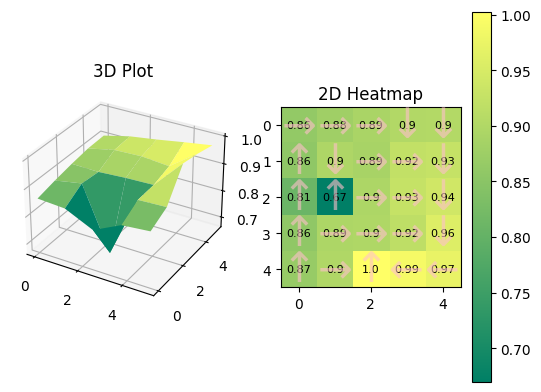

0.86260825	0.8781756	0.8908756	0.90097713	0.9035356	
0.85628116	0.8958776	0.8887838	0.9220008	0.9266573	
0.8092708	0.66961884	0.89500713	0.9256654	0.9409596	
0.85775965	0.8949996	0.8980892	0.91688466	0.9573131	
0.8669264	0.8990525	1.0020384	0.9896618	0.9724581	
buffer_size 512
512
512


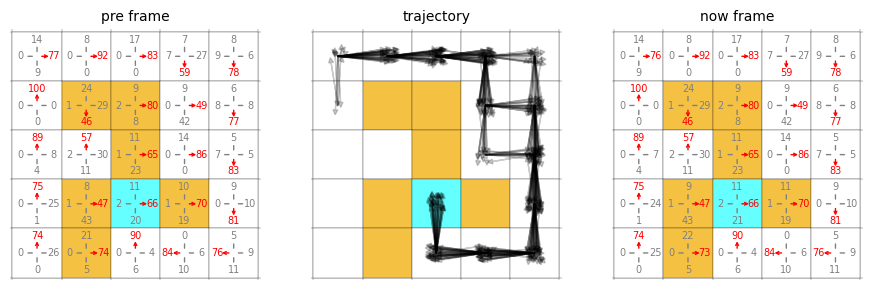

 40%|███████████████████████████████████▍                                                    | 8050/20000 [46:07<57:30,  3.46it/s]

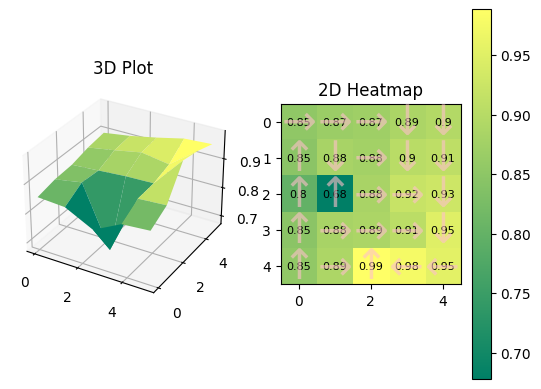

0.85280824	0.8666707	0.87104094	0.8870231	0.8958657	
0.8467506	0.88283086	0.8773159	0.9025645	0.90935194	
0.79914844	0.67779076	0.88397574	0.920083	0.92778945	
0.84698784	0.88256484	0.8867584	0.9050287	0.94894123	
0.8544041	0.8884047	0.9886025	0.9759538	0.9547779	
buffer_size 515
515
515


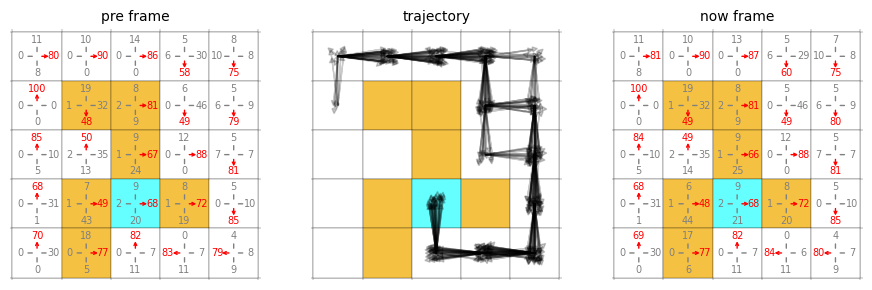

 40%|███████████████████████████████████▋                                                    | 8100/20000 [46:24<59:48,  3.32it/s]

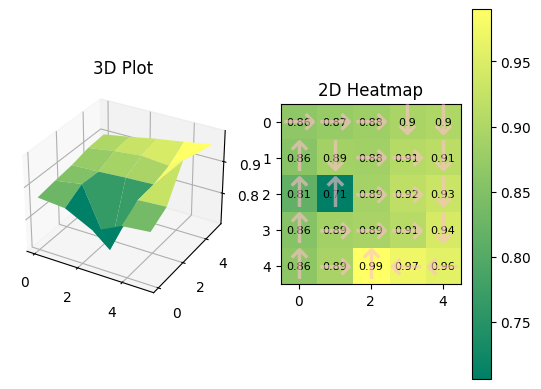

0.86484635	0.87428176	0.88171154	0.8956444	0.9001803	
0.85726917	0.8884536	0.8849181	0.9087305	0.9143882	
0.81378657	0.7062597	0.89015937	0.917329	0.9306783	
0.855167	0.8890363	0.893587	0.9094358	0.9436788	
0.863611	0.89401734	0.989925	0.971655	0.95856154	
buffer_size 520
520
520


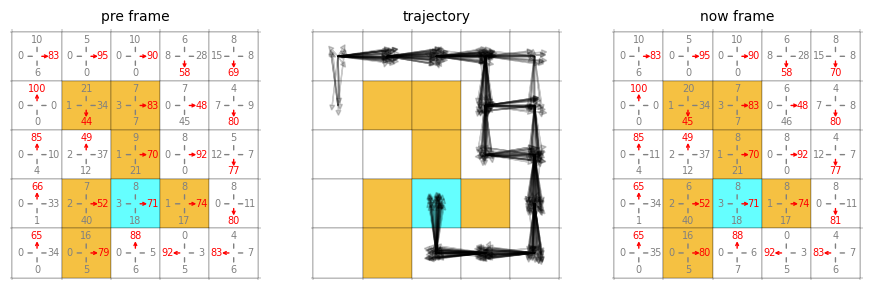

 41%|███████████████████████████████████▊                                                    | 8150/20000 [46:42<54:07,  3.65it/s]

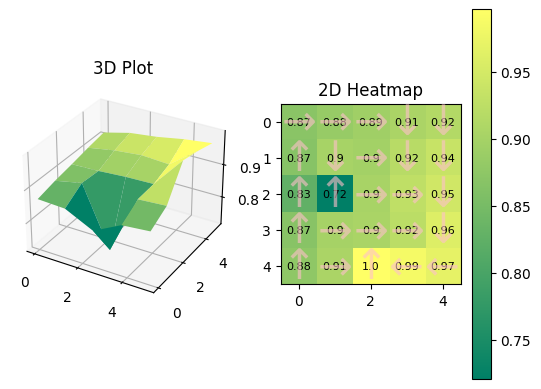

0.8701663	0.883903	0.8941013	0.90567017	0.9151761	
0.86624813	0.9008783	0.89649177	0.9197537	0.9355143	
0.82535625	0.72046876	0.901912	0.9276566	0.94512105	
0.86794233	0.90060955	0.9041655	0.92257935	0.9596745	
0.8756337	0.9061306	0.99680567	0.9853729	0.9696696	
buffer_size 524
524
524


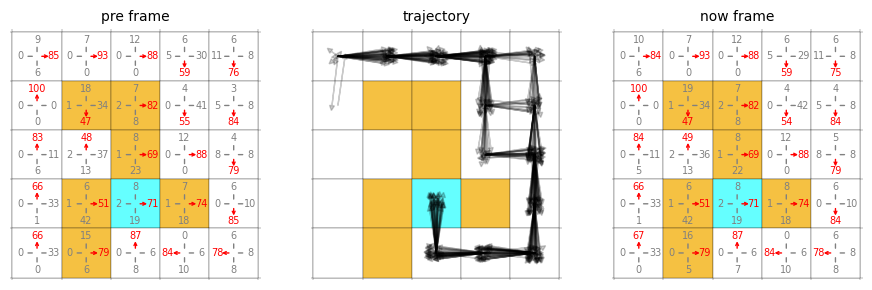

 41%|████████████████████████████████████                                                    | 8200/20000 [46:59<53:27,  3.68it/s]

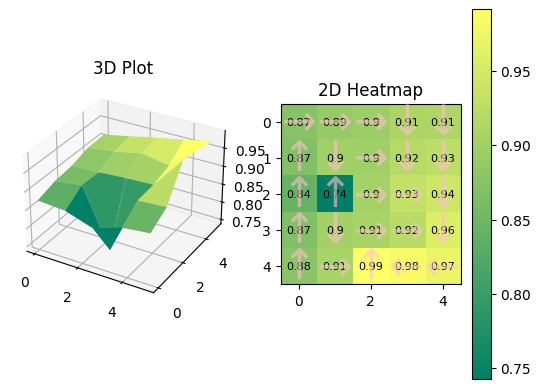

0.87395275	0.8893682	0.8952197	0.9099217	0.9120691	
0.8684249	0.90001273	0.89795786	0.91888756	0.9270239	
0.8437107	0.7427821	0.90318483	0.93417597	0.9424218	
0.8691447	0.9018663	0.9063736	0.921499	0.95663977	
0.87734115	0.90659726	0.9915036	0.98287004	0.97296923	
buffer_size 519
519
519


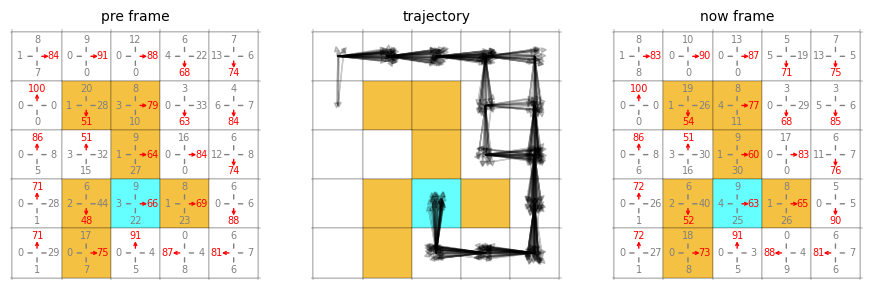

 41%|████████████████████████████████████▎                                                   | 8250/20000 [47:16<57:42,  3.39it/s]

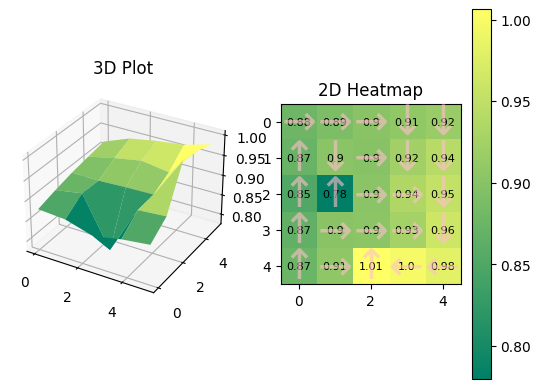

0.87751424	0.89027417	0.9010273	0.9088626	0.9159517	
0.87264025	0.9023485	0.8998958	0.92386913	0.94185394	
0.85243964	0.77985334	0.90269786	0.93575484	0.9536295	
0.86635965	0.90127164	0.9043045	0.9258398	0.96193004	
0.87472546	0.90673596	1.0062276	0.99753225	0.9808365	
buffer_size 520
520
520


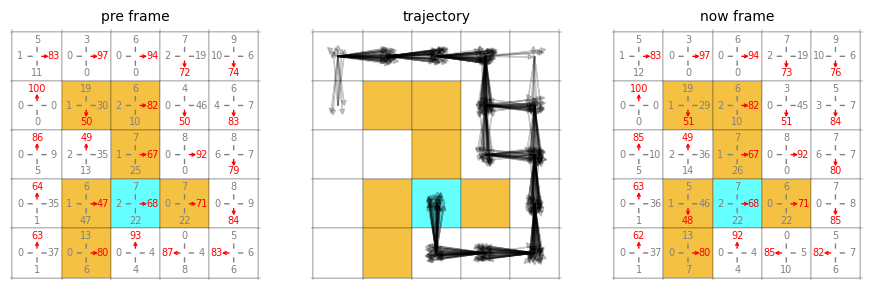

 42%|████████████████████████████████████▌                                                   | 8300/20000 [47:34<58:48,  3.32it/s]

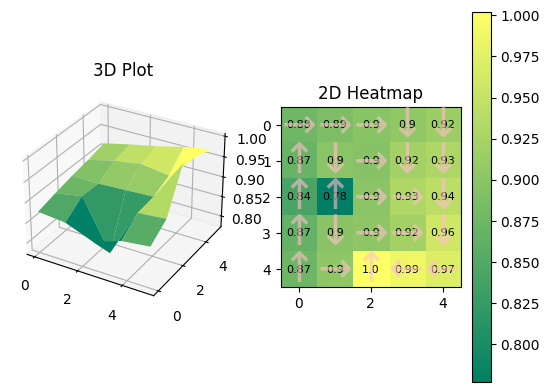

0.8751653	0.8865814	0.89684486	0.90473515	0.91528946	
0.86876494	0.8991422	0.8958374	0.9208504	0.9306011	
0.84238195	0.77702004	0.89946425	0.93074214	0.9436121	
0.8660794	0.89806646	0.9024411	0.9209933	0.9602596	
0.8740785	0.9041263	1.0017512	0.9883404	0.9716445	
buffer_size 517
517
517


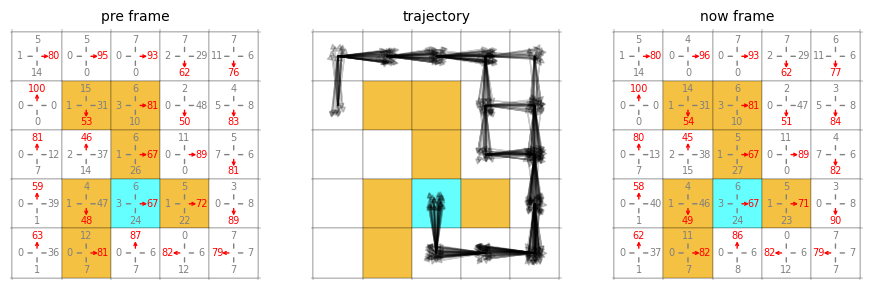

 42%|████████████████████████████████████▋                                                   | 8350/20000 [47:52<58:17,  3.33it/s]

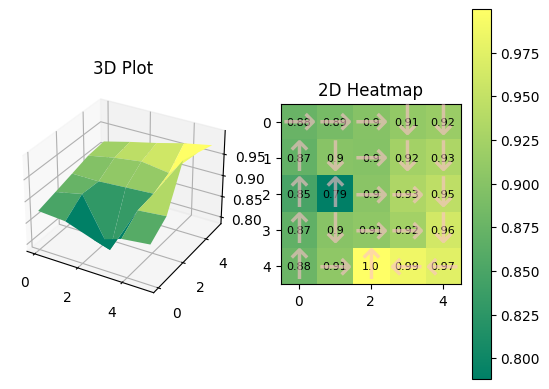

0.87539387	0.8870077	0.89895487	0.91121054	0.91571486	
0.87065965	0.9010401	0.8985752	0.9234991	0.9314876	
0.84822524	0.788183	0.90268475	0.9320681	0.9457525	
0.86999285	0.9010316	0.9065473	0.9229765	0.9619769	
0.8774756	0.90705484	0.99976254	0.98727274	0.9743593	
buffer_size 515
515
515


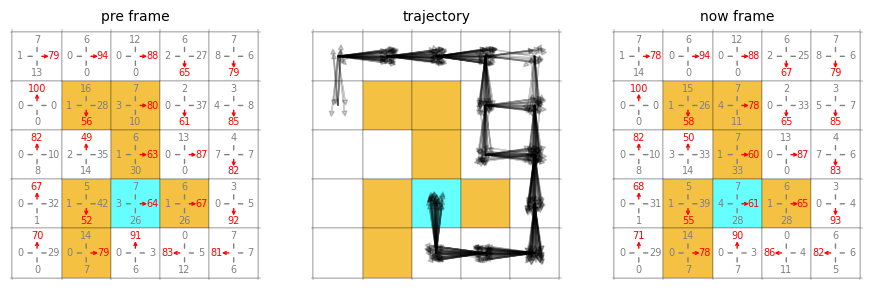

 42%|████████████████████████████████████▉                                                   | 8400/20000 [48:10<54:35,  3.54it/s]

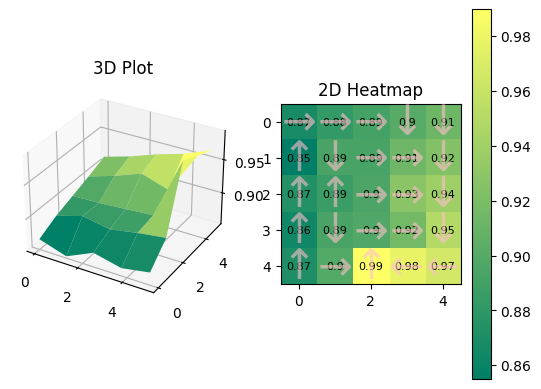

0.86806405	0.8819749	0.8915791	0.90145016	0.912493	
0.85499644	0.89387625	0.8926989	0.91366136	0.92404956	
0.87354636	0.88635886	0.8954735	0.92862654	0.93821645	
0.8639324	0.89367723	0.8983125	0.9156412	0.9500513	
0.8710365	0.89914465	0.9897557	0.9775839	0.9659201	
buffer_size 519
519
519


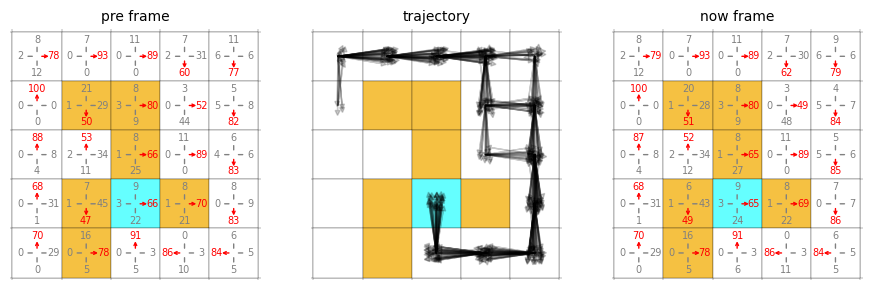

 42%|█████████████████████████████████████▏                                                  | 8450/20000 [48:27<57:02,  3.38it/s]

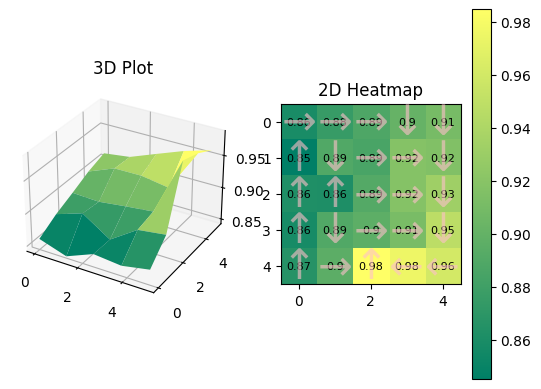

0.8591802	0.8756931	0.887956	0.90114236	0.91037893	
0.84522355	0.88967675	0.88607955	0.91773975	0.9158982	
0.8624424	0.8616663	0.8913137	0.9180844	0.9320359	
0.8581832	0.88997304	0.8958914	0.9113241	0.94786334	
0.8661427	0.89563376	0.9846878	0.9753234	0.96035385	
buffer_size 527
527
527


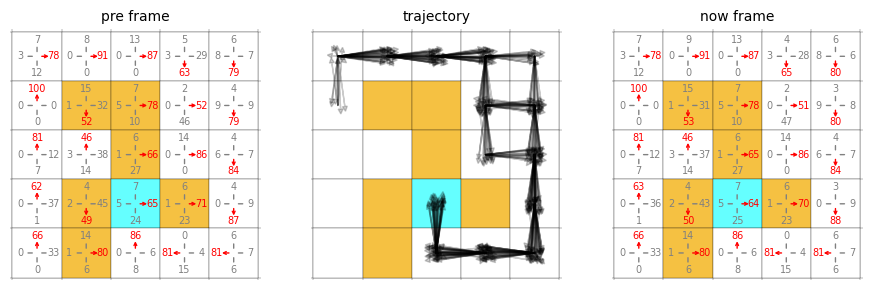

 42%|█████████████████████████████████████▍                                                  | 8500/20000 [48:45<53:54,  3.56it/s]

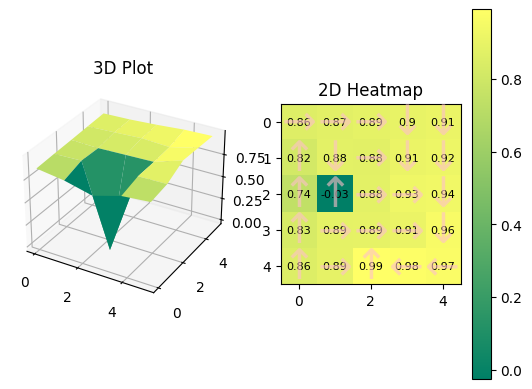

0.8607639	0.87455237	0.8853369	0.89836216	0.91010463	
0.8180784	0.883543	0.87606573	0.91102743	0.9186818	
0.7431693	-0.026175022	0.88430846	0.9260268	0.93677187	
0.83026695	0.8861155	0.8922764	0.90946746	0.96112686	
0.85663724	0.8911169	0.9926902	0.98224735	0.9706122	
buffer_size 519
519
519


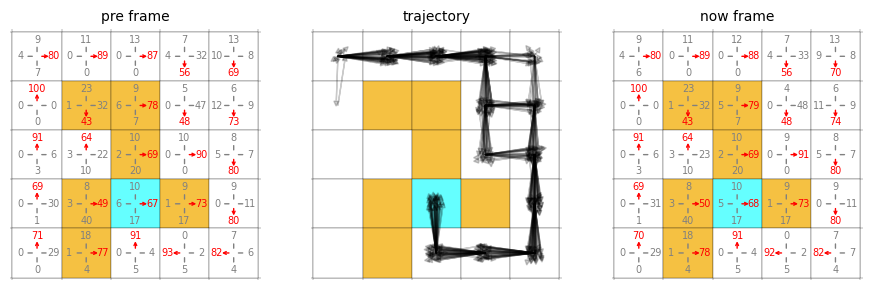

 43%|█████████████████████████████████████▌                                                  | 8550/20000 [49:02<52:48,  3.61it/s]

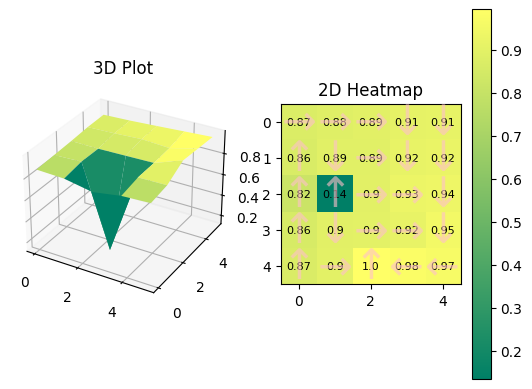

0.8742488	0.88452363	0.8946569	0.90878594	0.9130199	
0.86473274	0.8941276	0.8913823	0.9171809	0.9224194	
0.8176503	0.13545883	0.89598334	0.9303734	0.9369619	
0.8590523	0.89518493	0.90110326	0.91591597	0.95249885	
0.8710122	0.89922357	0.9953176	0.98157126	0.9681447	
buffer_size 518
518
518


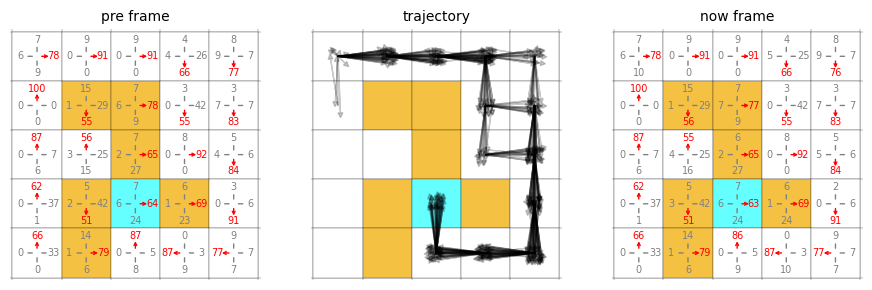

 43%|█████████████████████████████████████▊                                                  | 8600/20000 [49:19<53:33,  3.55it/s]

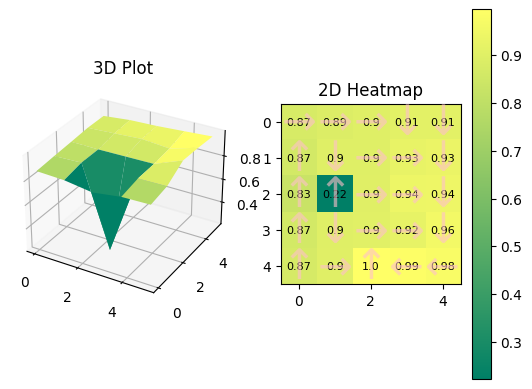

0.8743737	0.8878818	0.89913714	0.9121759	0.91153514	
0.8656976	0.8966602	0.89673334	0.92501295	0.93469125	
0.832705	0.2224344	0.89986265	0.9393146	0.9435257	
0.8655342	0.8974887	0.90321124	0.92119825	0.9590579	
0.8716144	0.9021466	0.9959069	0.9888915	0.9755704	
buffer_size 524
524
524


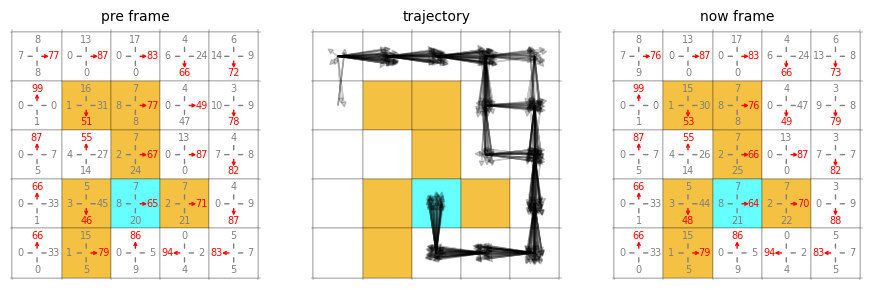

 43%|██████████████████████████████████████                                                  | 8650/20000 [49:36<53:02,  3.57it/s]

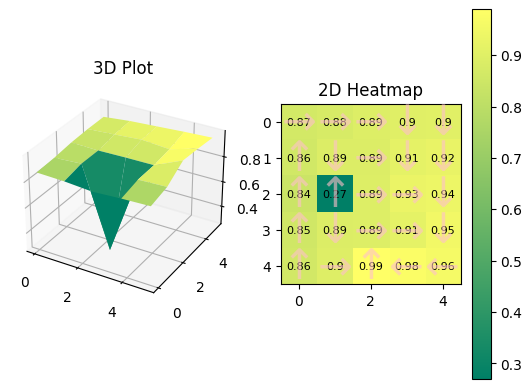

0.8655337	0.8753271	0.89331615	0.9011997	0.903209	
0.85923076	0.8887346	0.8881607	0.91455436	0.9245324	
0.84287906	0.2697977	0.89203596	0.9303937	0.9371176	
0.85493916	0.8884934	0.89314675	0.9136907	0.9502357	
0.8622073	0.8959115	0.98898727	0.9767889	0.96050113	
buffer_size 521
521
521


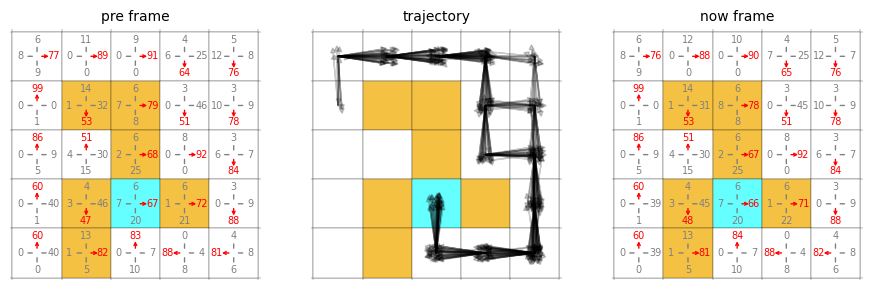

 44%|██████████████████████████████████████▎                                                 | 8700/20000 [49:54<54:30,  3.45it/s]

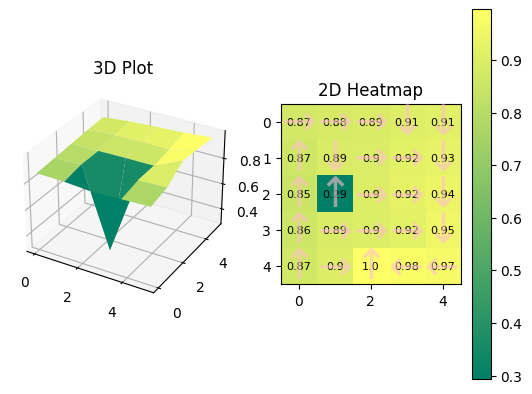

0.8712407	0.8822814	0.894135	0.9061488	0.9118307	
0.867198	0.8943815	0.895845	0.9187318	0.93075395	
0.85278237	0.29321563	0.89904714	0.9235505	0.94311404	
0.86170906	0.8945764	0.89943033	0.92060435	0.95301414	
0.868853	0.90208244	0.99690765	0.98370534	0.97030354	
buffer_size 519
519
519


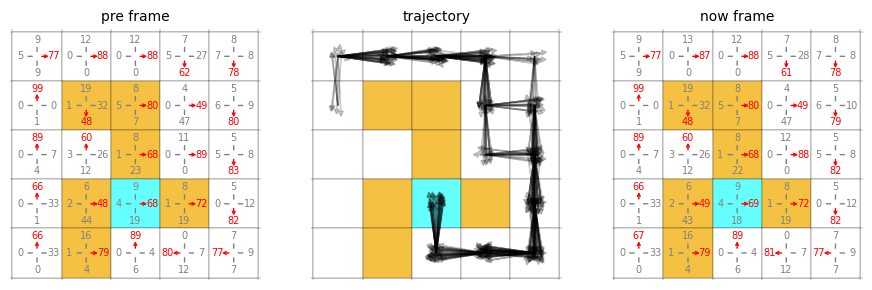

 44%|██████████████████████████████████████▌                                                 | 8750/20000 [50:12<51:42,  3.63it/s]

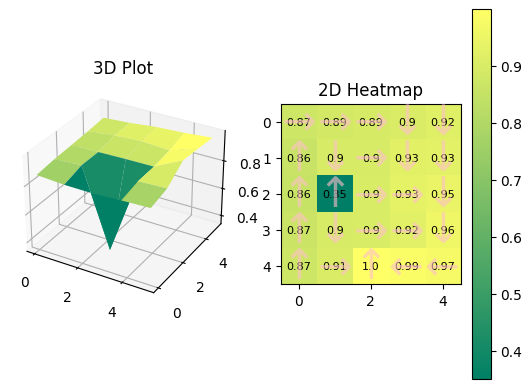

0.87071764	0.8867655	0.8943888	0.9035202	0.91583055	
0.8585992	0.8979503	0.897932	0.9254252	0.92745394	
0.8565937	0.35163713	0.9019934	0.9348778	0.94795763	
0.865803	0.89756644	0.9029588	0.92324066	0.95703924	
0.8728204	0.90506256	0.9991844	0.98793423	0.973866	
buffer_size 517
517
517


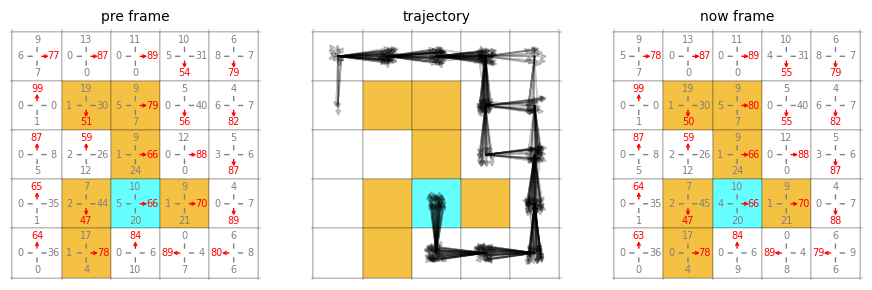

 44%|██████████████████████████████████████▋                                                 | 8800/20000 [50:29<52:18,  3.57it/s]

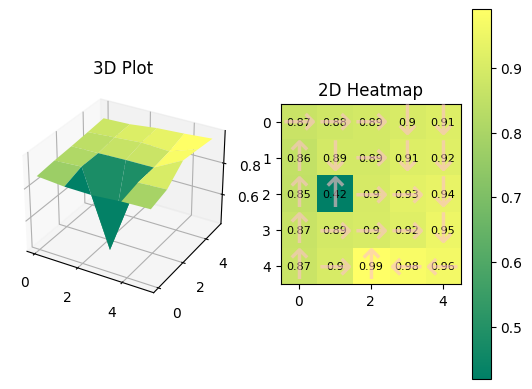

0.8700114	0.8828697	0.8911331	0.9018461	0.91335356	
0.85539675	0.8930764	0.8943127	0.9131293	0.91891134	
0.85291237	0.41922283	0.8989198	0.9258164	0.9387502	
0.8666227	0.89334023	0.89996994	0.9177854	0.948491	
0.8720126	0.9012247	0.9905292	0.9769223	0.9621318	
buffer_size 523
523
523


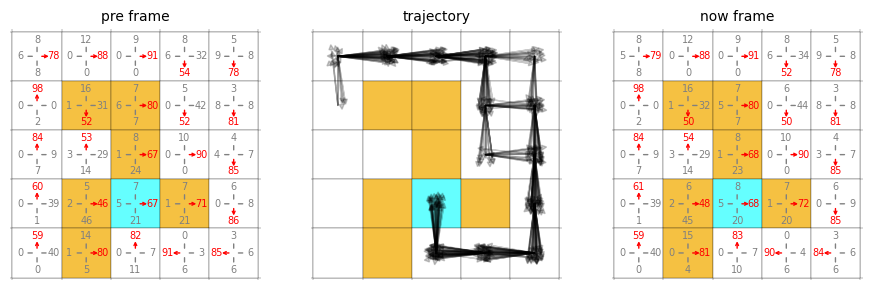

 44%|██████████████████████████████████████▉                                                 | 8850/20000 [50:46<53:10,  3.50it/s]

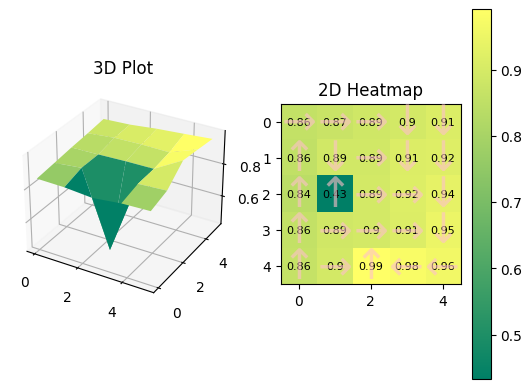

0.85877985	0.87211365	0.88635224	0.8974856	0.9114001	
0.8552824	0.8887894	0.8893113	0.9131378	0.91894555	
0.84112227	0.43303555	0.89389396	0.9165697	0.93655264	
0.8590859	0.8887259	0.8951293	0.91431034	0.94865966	
0.86448634	0.8972873	0.9912541	0.9773587	0.96220696	
buffer_size 522
522
522


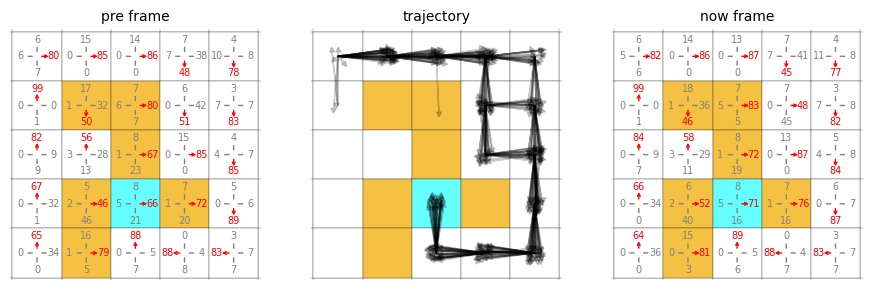

 44%|███████████████████████████████████████▏                                                | 8900/20000 [51:04<52:01,  3.56it/s]

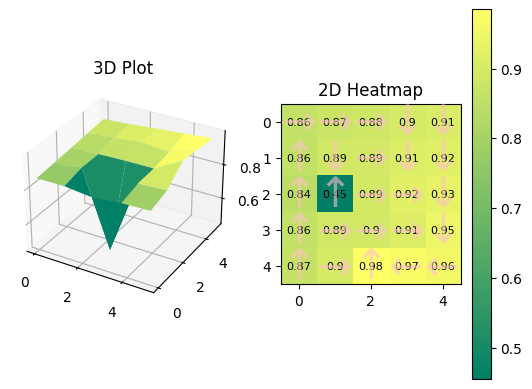

0.86148536	0.87393236	0.8840894	0.89714694	0.9088548	
0.86221546	0.8882737	0.89033633	0.9123974	0.9192973	
0.8446697	0.45497298	0.89496636	0.92462337	0.9337636	
0.86114573	0.88876885	0.89537996	0.9143566	0.9464928	
0.86618376	0.8978003	0.9849254	0.9739047	0.9598146	
buffer_size 522
522
522


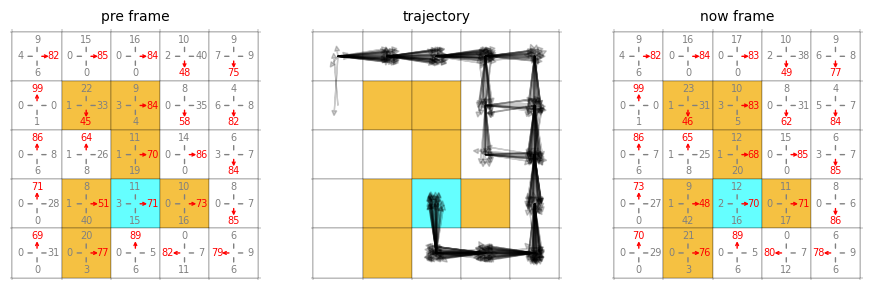

 45%|███████████████████████████████████████▍                                                | 8950/20000 [51:21<51:40,  3.56it/s]

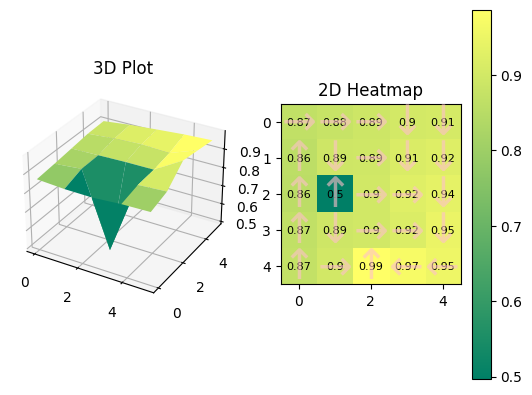

0.8676913	0.8778622	0.88985026	0.9022287	0.9053687	
0.8588296	0.89202607	0.8935511	0.91472006	0.9224412	
0.85719085	0.49653834	0.89750814	0.9234966	0.9352287	
0.8676047	0.8915769	0.89848214	0.9158776	0.9467814	
0.87136424	0.9001695	0.9866381	0.9707062	0.9539702	
buffer_size 524
524
524


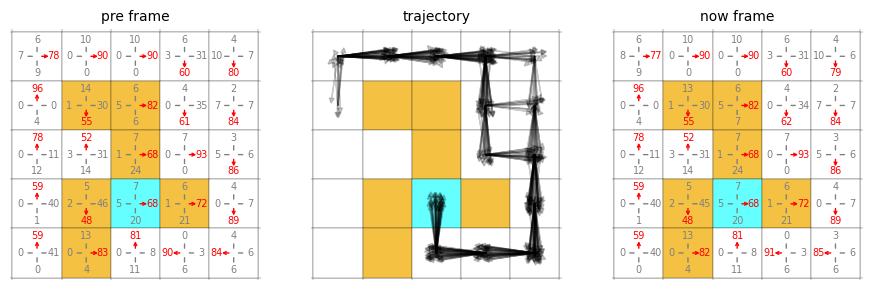

 45%|███████████████████████████████████████▌                                                | 9000/20000 [51:38<53:41,  3.41it/s]

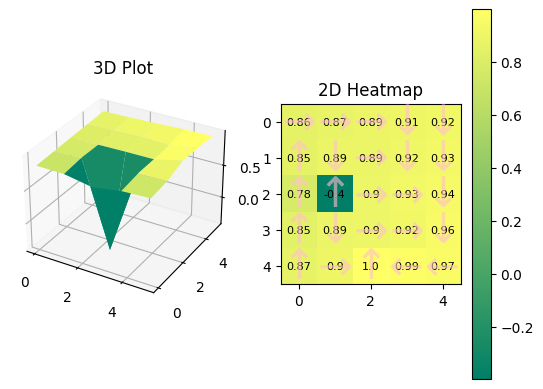

0.8591405	0.8747003	0.890948	0.9053962	0.91954315	
0.8537723	0.89115894	0.89022213	0.9160236	0.92831653	
0.78016603	-0.39776975	0.8971185	0.9283294	0.9413775	
0.8464471	0.89192206	0.89910984	0.91858137	0.95996284	
0.8657907	0.90178674	0.99830204	0.9870943	0.9685834	
buffer_size 516
516
516


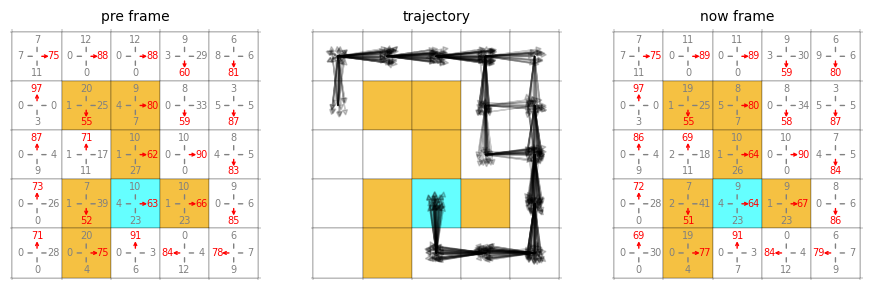

 45%|███████████████████████████████████████▊                                                | 9050/20000 [51:56<54:05,  3.37it/s]

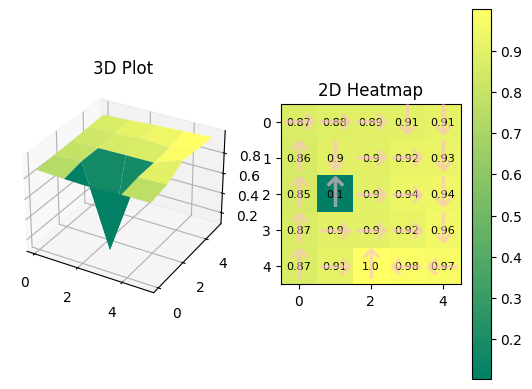

0.87084883	0.8846084	0.8939654	0.9050883	0.91338634	
0.8603086	0.8963963	0.89800394	0.91958845	0.9269258	
0.85320276	0.1038118	0.9023678	0.93559873	0.9438579	
0.86839193	0.8965335	0.90380406	0.9225896	0.95675397	
0.87301576	0.9056731	0.9998406	0.9834473	0.9687731	
buffer_size 521
521
521


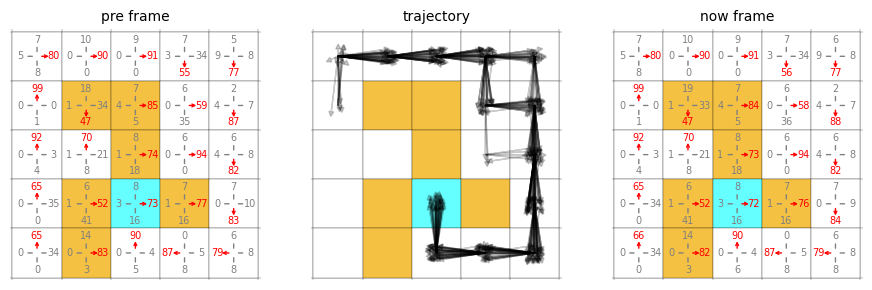

 46%|████████████████████████████████████████                                                | 9100/20000 [52:13<51:10,  3.55it/s]

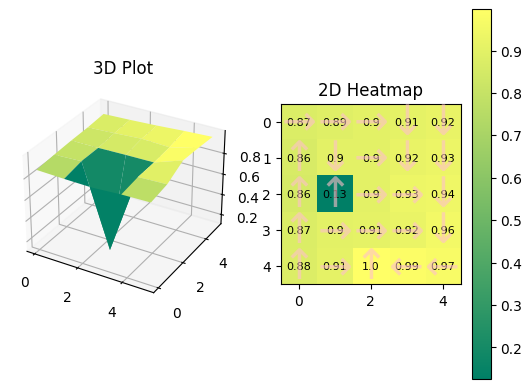

0.87142944	0.8880414	0.8997414	0.9062161	0.921291	
0.86249167	0.89878577	0.8999964	0.9195744	0.9300641	
0.8567404	0.12562436	0.904402	0.9347009	0.9421419	
0.8715279	0.89917654	0.9062406	0.9241793	0.95806044	
0.8765619	0.9080018	0.9970731	0.98668635	0.97071886	
buffer_size 518
518
518


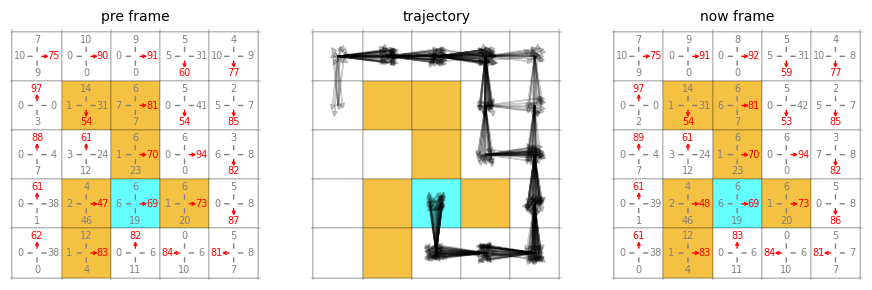

 46%|████████████████████████████████████████                                                | 9115/20000 [52:20<52:08,  3.48it/s]

In [ ]:
results = []

eval_frequent = 50

import copy
pre_actor = copy.deepcopy(agent.actor_net.state_dict())

# print(pre_actor)

for _ in tqdm(range(args.num_episodes)): #10000
    while(agent.buffer_size < agent.batch_size):
        reward_list = []
        return_to_go = collect_trajectory(env, agent, args, reward_list , test=False)
        # print(reward_list, return_to_go)
    
    # with torch.no_grad():
    # agent.actor_net.load_state_dict(pre_actor)
    # print(agent.buffer_size)
    
    if _ % eval_frequent==0:
        input =  torch.tensor([toOneHot((i,j)) for i in range(5) for j in range(5)],dtype=torch.float32)
        pre_frame_probabilities = agent.actor_net(input).detach().numpy()
        state_values = agent.critic_net(input).detach().numpy().reshape(5,5)

        # 绘制state_value
        p = pre_frame_probabilities.argmax(1)
        draw.draw(state_values, p)
        
        for i in range(5):
            for j in range(5):
                print(state_values[i][j], end="\t")
            print()
        print('buffer_size',agent.buffer_size)
        transition_list = [(toCoordinate(t.state), t.action, t.reward, toCoordinate(t.next_state)) for t in list(agent.buffer)]
        print(len(transition_list))
    
    actor_loss, critic_loss, entropy = agent.update()

    # agent.actor_net.load_state_dict(pre_actor)
    
    if _ % eval_frequent==0:
        input =  torch.tensor([toOneHot((i,j)) for i in range(5) for j in range(5)],dtype=torch.float32)
        now_frame_probabilities = agent.actor_net(input).detach().numpy()
        print(len(transition_list))
        draw.plot_policy(pre_frame_probabilities, now_frame_probabilities,transition_list=transition_list)
    
        return_list = []
        for _ in range(5):
            reward_list = []
            return_to_go = collect_trajectory(env, agent, args, reward_list, test=True)
            return_list.append(return_to_go)
        result = sum(return_list) / len(return_list)
        
        

In [ ]:
agent.state_values

In [ ]:
state_values = 
p = np.argmax(agent.policy_tabular,axis=1)
draw.draw(state_values.reshape(5,5), p)

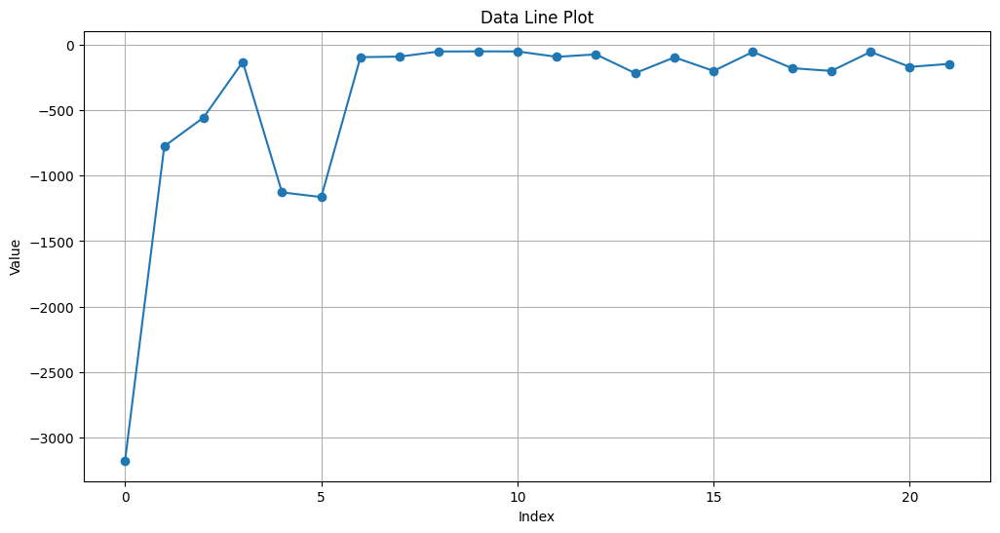

In [13]:
import matplotlib.pyplot as plt

# 提供的数据列表
data = results
# 画折线图
plt.figure(figsize=(12, 6))
plt.plot(data, marker='o')
plt.title('Data Line Plot')
plt.xlabel('Index')
plt.ylabel('Value')
plt.grid(True)
plt.show()